**Installation of SimPy""
If not available**

In [1]:
#!pip install simpy

**Import of required modules**

In [2]:
import simpy
import numpy as np
import numpy.random as random

**Parameters settings**

In [3]:
MAXSIMTIME = 100000
LAMBDA = 6.8
MU = 8.0
POPULATION = 50000000
MAXWAITTIME = 3

VERBOSE = True
LOGGED = True
PLOTTED = True
RENEGED = True
FIXEDWAITIME = True

**Discrete-Event Simulation model**


**The definition of a job**.

The properties of a job are


1. job execution time
2. job arrival time
3. job maximum waiting time

In [4]:
class Job:
    def __init__(self, name, arrtime, duration, maxwaittime):
        self.name = name
        self.arrtime = arrtime
        self.duration = duration
        self.maxwaittime = maxwaittime

    def __str__(self):
        return '%s at %.3f, duration %.3f, max waiting %.3f' %(self.name, self.arrtime, self.duration, self.maxwaittime)

**The definition of server**

 There are 2 arguments needed for a server:
 1. env: SimPy environment
 2. queue discipline: FIFO - First In First Out

In [5]:
class Server:
    def __init__(self, env, strat = 'FIFO'):
        self.env = env
        self.strat = strat
        self.Jobs = list(())
        self.serversleeping = None
        ### Statistics
        self.waitingTime = 0
        self.idleTime = 0
        self.jobsDone = 0
        ### Register a new server process
        env.process(self.serve())

    def serve(self):
        while True:
            ''' Do nothing, just change server to idle
            and then yield a wait event which takes infinite time
            '''
            if len(self.Jobs) == 0:
                self.serversleeping = env.process(self.waiting(self.env))
                t1 = self.env.now
                yield self.serversleeping
                ### Accumulate the server idle time
                self.idleTime += self.env.now - t1
            else:
                ### Get the first job to be served
                if self.strat == 'SJF':
                    self.Jobs.sort(key = SJF)
                    j = self.Jobs.pop(0)
                else: # FIFO by default
                    j = self.Jobs.pop(0)
                if LOGGED:
                    qlog.write('%.4f\t%d\t%d\n' 
                        %(self.env.now, 1 if len(self.Jobs) > 0 else 0, len(self.Jobs)))

                ### Sum up the waiting time
                self.waitingTime += self.env.now - j.arrtime
                ### Yield an event for the job finish
                yield self.env.timeout(j.duration)
                ### Sum up the jobs done 
                self.jobsDone += 1

    def waiting(self, env):
        try:
            if VERBOSE:
                print('Server is idle at %.2f' %self.env.now)
            yield self.env.timeout(MAXSIMTIME)
        except simpy.Interrupt as i:
            if VERBOSE:
                 print('Server waken up and works at %.2f' %self.env.now)
                    

**The arrival process**

The arrival process is exponentially distributed which is parameterized by
1. number of servers
2. maximum number of population
3. arrival rate $\lambda$
4. service rate $\mu$
*Note that, the implementation of the arrival process embeds both arrival and service distributions.*

In [6]:
class JobGenerator:
    def __init__(self, env, server, nrjobs = 10000000, lam = 5, mu = 8, maxwait = 6):
        self.server = server
        self.nrjobs = nrjobs
        self.interarrivaltime = 1/lam
        self.servicetime = 1/mu
        self.maxwaittime = maxwait
        ## Statistics
        self.totalJob = 0
        ### Register a new job generator process
        env.process(self.generateJobs(env))
        
    def generateJobs(self, env):
        while True:
            ### Yield an event for new job arrival
            jobInterarrival = random.exponential(self.interarrivaltime)
            yield env.timeout(jobInterarrival)

            ### Generate service time and add job to the list
            job_duration = random.exponential(self.servicetime)
            if FIXEDWAITIME:
                max_waittime = self.maxwaittime
            else:
                max_waittime = random.exponential(self.maxwaittime)
            job = Job('Job %s' %(self.totalJob + 1), env.now, job_duration, max_waittime)
            self.server.Jobs.append(job)
            ### Register new process for renege job
            if RENEGED:
                env.process(self.renegeJob(env, job))
            if VERBOSE:
                print('Finish %s: t = %.2f, l = %.2f, dt = %.2f' 
                    %(job.name, env.now, job.duration, jobInterarrival))
            self.totalJob += 1

            ### If server is idle, wake it up'''
            if not self.server.serversleeping.triggered:
                self.server.serversleeping.interrupt('Wake up, please.')
    
    def renegeJob(self, env, job):
        yield env.timeout(job.maxwaittime)
        if job in self.server.Jobs:
            if VERBOSE:
                print('RENEGE ', job)
            self.server.Jobs.remove(job)


**Open the log file**

If requested.

In [7]:
if LOGGED:
    if RENEGED:
        qlog = open('mm1SD-l%d-m%d-w%d.csv' %(LAMBDA, MU, MAXWAITTIME), 'w')
    else:
        qlog = open('mm1-l%d-m%d.csv' %(LAMBDA, MU), 'w')
    qlog.write('0\t0\t0\n' )

**Start SimPy environment**

In [8]:
env = simpy.Environment()
MyServer = Server(env, 'FIFO')
MyJobGenerator = JobGenerator(env, MyServer, POPULATION, LAMBDA, MU, MAXWAITTIME)

**Run the simulation** 

In [9]:
env.run(until = MAXSIMTIME)

Server is idle at 0.00
Finish Job 1: t = 0.05, l = 0.11, dt = 0.05
Server waken up and works at 0.05
Finish Job 2: t = 0.08, l = 0.21, dt = 0.04
Server is idle at 0.36
Finish Job 3: t = 0.44, l = 0.01, dt = 0.36
Server waken up and works at 0.44
Server is idle at 0.45
Finish Job 4: t = 0.52, l = 0.03, dt = 0.07
Server waken up and works at 0.52
Server is idle at 0.55
Finish Job 5: t = 0.58, l = 0.22, dt = 0.06
Server waken up and works at 0.58
Finish Job 6: t = 0.63, l = 0.03, dt = 0.05
Server is idle at 0.83
Finish Job 7: t = 1.02, l = 0.16, dt = 0.39
Server waken up and works at 1.02
Finish Job 8: t = 1.17, l = 0.07, dt = 0.15
Server is idle at 1.26
Finish Job 9: t = 1.34, l = 0.07, dt = 0.17
Server waken up and works at 1.34
Finish Job 10: t = 1.41, l = 0.41, dt = 0.07
Finish Job 11: t = 1.45, l = 0.12, dt = 0.04
Finish Job 12: t = 1.71, l = 0.03, dt = 0.26
Server is idle at 1.98
Finish Job 13: t = 2.06, l = 0.03, dt = 0.34
Server waken up and works at 2.06
Server is idle at 2.09
Fi

Finish Job 6926: t = 1016.47, l = 0.07, dt = 0.69
Server waken up and works at 1016.47
Server is idle at 1016.54
Finish Job 6927: t = 1016.63, l = 0.07, dt = 0.16
Server waken up and works at 1016.63
Server is idle at 1016.70
Finish Job 6928: t = 1016.74, l = 0.31, dt = 0.11
Server waken up and works at 1016.74
Finish Job 6929: t = 1016.74, l = 0.02, dt = 0.00
Finish Job 6930: t = 1016.98, l = 0.14, dt = 0.24
Finish Job 6931: t = 1017.06, l = 0.00, dt = 0.08
Finish Job 6932: t = 1017.17, l = 0.07, dt = 0.11
Server is idle at 1017.27
Finish Job 6933: t = 1017.49, l = 0.27, dt = 0.32
Server waken up and works at 1017.49
Finish Job 6934: t = 1017.66, l = 0.04, dt = 0.17
Finish Job 6935: t = 1017.74, l = 0.28, dt = 0.07
Finish Job 6936: t = 1017.76, l = 0.25, dt = 0.02
Finish Job 6937: t = 1017.83, l = 0.04, dt = 0.07
Finish Job 6938: t = 1017.90, l = 0.01, dt = 0.07
Server is idle at 1018.37
Finish Job 6939: t = 1019.15, l = 0.03, dt = 1.24
Server waken up and works at 1019.15
Server is i

Server is idle at 1656.07
Finish Job 11334: t = 1656.11, l = 0.12, dt = 0.18
Server waken up and works at 1656.11
Server is idle at 1656.24
Finish Job 11335: t = 1656.57, l = 0.01, dt = 0.45
Server waken up and works at 1656.57
Server is idle at 1656.58
Finish Job 11336: t = 1657.10, l = 0.00, dt = 0.53
Server waken up and works at 1657.10
Server is idle at 1657.10
Finish Job 11337: t = 1657.11, l = 0.12, dt = 0.01
Server waken up and works at 1657.11
Server is idle at 1657.23
Finish Job 11338: t = 1657.50, l = 0.45, dt = 0.39
Server waken up and works at 1657.50
Finish Job 11339: t = 1657.60, l = 0.41, dt = 0.10
Finish Job 11340: t = 1657.92, l = 0.23, dt = 0.32
Finish Job 11341: t = 1658.02, l = 0.04, dt = 0.11
Finish Job 11342: t = 1658.13, l = 0.04, dt = 0.10
Finish Job 11343: t = 1658.23, l = 0.11, dt = 0.10
Finish Job 11344: t = 1658.26, l = 0.57, dt = 0.03
Finish Job 11345: t = 1658.36, l = 0.25, dt = 0.10
Finish Job 11346: t = 1658.38, l = 0.03, dt = 0.03
Finish Job 11347: t = 

Finish Job 16079: t = 2351.13, l = 0.06, dt = 0.16
Finish Job 16080: t = 2351.23, l = 0.54, dt = 0.10
Finish Job 16081: t = 2351.29, l = 0.01, dt = 0.06
Finish Job 16082: t = 2351.43, l = 0.00, dt = 0.14
Finish Job 16083: t = 2351.86, l = 0.02, dt = 0.42
Finish Job 16084: t = 2351.89, l = 0.06, dt = 0.04
Finish Job 16085: t = 2352.32, l = 0.10, dt = 0.43
Finish Job 16086: t = 2352.45, l = 0.07, dt = 0.13
Finish Job 16087: t = 2352.64, l = 0.11, dt = 0.20
Finish Job 16088: t = 2352.70, l = 0.16, dt = 0.05
Finish Job 16089: t = 2352.84, l = 0.18, dt = 0.14
Finish Job 16090: t = 2352.94, l = 0.01, dt = 0.10
Finish Job 16091: t = 2353.04, l = 0.10, dt = 0.11
Server is idle at 2353.37
Finish Job 16092: t = 2353.41, l = 0.02, dt = 0.36
Server waken up and works at 2353.41
Server is idle at 2353.43
Finish Job 16093: t = 2353.51, l = 0.02, dt = 0.10
Server waken up and works at 2353.51
Finish Job 16094: t = 2353.51, l = 0.15, dt = 0.00
Finish Job 16095: t = 2353.57, l = 0.01, dt = 0.06
Finish 

Server is idle at 3010.42
Finish Job 20532: t = 3010.56, l = 0.12, dt = 0.47
Server waken up and works at 3010.56
Server is idle at 3010.68
Finish Job 20533: t = 3011.48, l = 0.02, dt = 0.92
Server waken up and works at 3011.48
Server is idle at 3011.50
Finish Job 20534: t = 3011.90, l = 0.07, dt = 0.42
Server waken up and works at 3011.90
Server is idle at 3011.97
Finish Job 20535: t = 3012.30, l = 0.06, dt = 0.40
Server waken up and works at 3012.30
Server is idle at 3012.36
Finish Job 20536: t = 3012.36, l = 0.45, dt = 0.06
Server waken up and works at 3012.36
Finish Job 20537: t = 3012.48, l = 0.05, dt = 0.13
Finish Job 20538: t = 3012.55, l = 0.19, dt = 0.07
Finish Job 20539: t = 3012.79, l = 0.16, dt = 0.24
Finish Job 20540: t = 3012.88, l = 0.12, dt = 0.08
Finish Job 20541: t = 3013.25, l = 0.15, dt = 0.38
Finish Job 20542: t = 3013.30, l = 0.07, dt = 0.04
Server is idle at 3013.54
Finish Job 20543: t = 3013.65, l = 0.05, dt = 0.35
Server waken up and works at 3013.65
Server is 

Server is idle at 3596.66
Finish Job 24602: t = 3596.85, l = 0.07, dt = 0.65
Server waken up and works at 3596.85
Finish Job 24603: t = 3596.92, l = 0.20, dt = 0.06
Finish Job 24604: t = 3597.00, l = 0.09, dt = 0.09
Finish Job 24605: t = 3597.12, l = 0.04, dt = 0.12
Finish Job 24606: t = 3597.14, l = 0.15, dt = 0.01
Server is idle at 3597.40
Finish Job 24607: t = 3597.42, l = 0.23, dt = 0.29
Server waken up and works at 3597.42
Finish Job 24608: t = 3597.56, l = 0.10, dt = 0.13
Finish Job 24609: t = 3597.56, l = 0.27, dt = 0.01
Finish Job 24610: t = 3597.95, l = 0.26, dt = 0.39
Finish Job 24611: t = 3598.00, l = 0.12, dt = 0.04
Finish Job 24612: t = 3598.02, l = 0.22, dt = 0.02
Finish Job 24613: t = 3598.03, l = 0.04, dt = 0.02
Finish Job 24614: t = 3598.38, l = 0.19, dt = 0.35
Finish Job 24615: t = 3598.57, l = 0.46, dt = 0.19
Finish Job 24616: t = 3598.66, l = 0.00, dt = 0.09
Finish Job 24617: t = 3598.78, l = 0.31, dt = 0.12
Finish Job 24618: t = 3598.95, l = 0.09, dt = 0.17
Finish 

Server is idle at 4079.95
Finish Job 27865: t = 4080.16, l = 0.02, dt = 0.40
Server waken up and works at 4080.16
Server is idle at 4080.18
Finish Job 27866: t = 4080.21, l = 0.00, dt = 0.06
Server waken up and works at 4080.21
Server is idle at 4080.22
Finish Job 27867: t = 4080.24, l = 0.09, dt = 0.03
Server waken up and works at 4080.24
Server is idle at 4080.33
Finish Job 27868: t = 4080.60, l = 0.07, dt = 0.36
Server waken up and works at 4080.60
Server is idle at 4080.68
Finish Job 27869: t = 4081.03, l = 0.05, dt = 0.43
Server waken up and works at 4081.03
Server is idle at 4081.08
Finish Job 27870: t = 4081.09, l = 0.12, dt = 0.05
Server waken up and works at 4081.09
Finish Job 27871: t = 4081.19, l = 0.05, dt = 0.11
Server is idle at 4081.26
Finish Job 27872: t = 4081.46, l = 0.00, dt = 0.27
Server waken up and works at 4081.46
Server is idle at 4081.46
Finish Job 27873: t = 4081.74, l = 0.22, dt = 0.28
Server waken up and works at 4081.74
Finish Job 27874: t = 4081.85, l = 0.

Finish Job 30831: t = 4510.23, l = 0.15, dt = 0.04
Finish Job 30832: t = 4510.48, l = 0.18, dt = 0.25
Finish Job 30833: t = 4510.58, l = 0.04, dt = 0.10
Server is idle at 4510.73
Finish Job 30834: t = 4510.75, l = 0.18, dt = 0.17
Server waken up and works at 4510.75
Finish Job 30835: t = 4510.82, l = 0.10, dt = 0.07
Finish Job 30836: t = 4510.92, l = 0.00, dt = 0.10
Server is idle at 4511.03
Finish Job 30837: t = 4511.13, l = 0.27, dt = 0.21
Server waken up and works at 4511.13
Finish Job 30838: t = 4511.25, l = 0.46, dt = 0.12
Finish Job 30839: t = 4511.32, l = 0.32, dt = 0.07
Finish Job 30840: t = 4511.34, l = 0.18, dt = 0.02
Finish Job 30841: t = 4511.45, l = 0.05, dt = 0.11
Finish Job 30842: t = 4511.52, l = 0.00, dt = 0.07
Finish Job 30843: t = 4511.91, l = 0.25, dt = 0.39
Finish Job 30844: t = 4511.95, l = 0.07, dt = 0.04
Finish Job 30845: t = 4511.95, l = 0.08, dt = 0.00
Finish Job 30846: t = 4512.06, l = 0.08, dt = 0.10
Finish Job 30847: t = 4512.06, l = 0.04, dt = 0.00
Finish 

Finish Job 35415: t = 5179.39, l = 0.01, dt = 0.13
Finish Job 35416: t = 5179.42, l = 0.36, dt = 0.03
Finish Job 35417: t = 5179.45, l = 0.02, dt = 0.03
Finish Job 35418: t = 5179.63, l = 0.04, dt = 0.18
Finish Job 35419: t = 5179.78, l = 0.26, dt = 0.15
Finish Job 35420: t = 5179.98, l = 0.07, dt = 0.20
Finish Job 35421: t = 5180.11, l = 0.00, dt = 0.13
Finish Job 35422: t = 5180.38, l = 0.08, dt = 0.27
Finish Job 35423: t = 5180.40, l = 0.13, dt = 0.02
Finish Job 35424: t = 5180.41, l = 0.04, dt = 0.00
Finish Job 35425: t = 5180.61, l = 0.04, dt = 0.20
Finish Job 35426: t = 5180.90, l = 0.12, dt = 0.29
Finish Job 35427: t = 5181.10, l = 0.14, dt = 0.21
Finish Job 35428: t = 5181.26, l = 0.12, dt = 0.16
Finish Job 35429: t = 5181.34, l = 0.09, dt = 0.07
Finish Job 35430: t = 5181.35, l = 0.22, dt = 0.02
Finish Job 35431: t = 5181.37, l = 0.03, dt = 0.02
Finish Job 35432: t = 5181.40, l = 0.21, dt = 0.03
Finish Job 35433: t = 5181.44, l = 0.12, dt = 0.04
Finish Job 35434: t = 5181.68, 

Finish Job 38686: t = 5664.74, l = 0.09, dt = 0.04
Finish Job 38687: t = 5665.09, l = 0.01, dt = 0.35
Finish Job 38688: t = 5665.12, l = 0.01, dt = 0.03
Server is idle at 5665.17
Finish Job 38689: t = 5665.39, l = 0.06, dt = 0.27
Server waken up and works at 5665.39
Server is idle at 5665.44
Finish Job 38690: t = 5665.59, l = 0.04, dt = 0.20
Server waken up and works at 5665.59
Server is idle at 5665.62
Finish Job 38691: t = 5665.69, l = 0.19, dt = 0.11
Server waken up and works at 5665.69
Finish Job 38692: t = 5665.83, l = 0.06, dt = 0.13
Server is idle at 5665.94
Finish Job 38693: t = 5665.98, l = 0.03, dt = 0.16
Server waken up and works at 5665.98
Server is idle at 5666.02
Finish Job 38694: t = 5666.90, l = 0.10, dt = 0.92
Server waken up and works at 5666.90
Finish Job 38695: t = 5666.91, l = 0.56, dt = 0.01
Finish Job 38696: t = 5667.01, l = 0.03, dt = 0.11
Finish Job 38697: t = 5667.09, l = 0.11, dt = 0.08
Finish Job 38698: t = 5667.13, l = 0.02, dt = 0.03
Finish Job 38699: t = 

Finish Job 41994: t = 6162.26, l = 0.11, dt = 0.67
Finish Job 41995: t = 6162.68, l = 0.23, dt = 0.42
Finish Job 41996: t = 6162.69, l = 0.10, dt = 0.01
Finish Job 41997: t = 6162.93, l = 0.16, dt = 0.24
Finish Job 41998: t = 6163.07, l = 0.04, dt = 0.14
Server is idle at 6163.78
Finish Job 41999: t = 6163.84, l = 0.22, dt = 0.77
Server waken up and works at 6163.84
Finish Job 42000: t = 6163.99, l = 0.34, dt = 0.15
Finish Job 42001: t = 6164.08, l = 0.93, dt = 0.09
Finish Job 42002: t = 6164.45, l = 0.05, dt = 0.37
Finish Job 42003: t = 6164.54, l = 0.10, dt = 0.08
Finish Job 42004: t = 6164.58, l = 0.21, dt = 0.04
Finish Job 42005: t = 6164.58, l = 0.02, dt = 0.00
Finish Job 42006: t = 6164.84, l = 0.02, dt = 0.26
Finish Job 42007: t = 6164.94, l = 0.38, dt = 0.10
Finish Job 42008: t = 6165.14, l = 0.09, dt = 0.20
Finish Job 42009: t = 6165.70, l = 0.05, dt = 0.56
Finish Job 42010: t = 6165.75, l = 0.01, dt = 0.05
Finish Job 42011: t = 6166.17, l = 0.04, dt = 0.42
Finish Job 42012: t

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Finish Job 52306: t = 7674.56, l = 0.23, dt = 0.00
Finish Job 52307: t = 7674.96, l = 0.10, dt = 0.40
Finish Job 52308: t = 7674.97, l = 0.12, dt = 0.01
Finish Job 52309: t = 7675.00, l = 0.42, dt = 0.02
Finish Job 52310: t = 7675.02, l = 0.22, dt = 0.02
Finish Job 52311: t = 7675.15, l = 0.01, dt = 0.12
Finish Job 52312: t = 7675.17, l = 0.12, dt = 0.03
Finish Job 52313: t = 7675.18, l = 0.01, dt = 0.01
Finish Job 52314: t = 7675.19, l = 0.21, dt = 0.01
Finish Job 52315: t = 7675.25, l = 0.16, dt = 0.06
Finish Job 52316: t = 7675.60, l = 0.06, dt = 0.35
Finish Job 52317: t = 7675.79, l = 0.10, dt = 0.19
Finish Job 52318: t = 7676.03, l = 0.05, dt = 0.23
Finish Job 52319: t = 7676.03, l = 0.03, dt = 0.01
Finish Job 52320: t = 7676.20, l = 0.27, dt = 0.16
Finish Job 52321: t = 7676.44, l = 0.00, dt = 0.25
Finish Job 52322: t = 7676.66, l = 0.07, dt = 0.22
Finish Job 52323: t = 7676.73, l = 0.24, dt = 0.07
Finish Job 52324: t = 7676.76, l = 0.18, dt = 0.03
Finish Job 52325: t = 7677.23, 

Finish Job 55750: t = 8187.81, l = 0.08, dt = 0.48
Finish Job 55751: t = 8187.88, l = 0.03, dt = 0.08
Finish Job 55752: t = 8187.99, l = 0.00, dt = 0.10
Server is idle at 8188.02
Finish Job 55753: t = 8188.05, l = 0.24, dt = 0.06
Server waken up and works at 8188.05
Finish Job 55754: t = 8188.22, l = 0.08, dt = 0.17
Finish Job 55755: t = 8188.23, l = 0.05, dt = 0.01
Finish Job 55756: t = 8188.33, l = 0.20, dt = 0.10
Finish Job 55757: t = 8188.51, l = 0.00, dt = 0.18
Finish Job 55758: t = 8188.53, l = 0.12, dt = 0.02
Finish Job 55759: t = 8188.67, l = 0.08, dt = 0.14
Server is idle at 8188.82
Finish Job 55760: t = 8189.00, l = 0.06, dt = 0.33
Server waken up and works at 8189.00
Server is idle at 8189.07
Finish Job 55761: t = 8189.47, l = 0.05, dt = 0.47
Server waken up and works at 8189.47
Server is idle at 8189.52
Finish Job 55762: t = 8189.76, l = 0.11, dt = 0.29
Server waken up and works at 8189.76
Server is idle at 8189.87
Finish Job 55763: t = 8190.08, l = 0.01, dt = 0.32
Server w

Finish Job 59002: t = 8654.98, l = 0.35, dt = 0.31
Finish Job 59003: t = 8655.00, l = 0.06, dt = 0.02
Finish Job 59004: t = 8655.36, l = 0.19, dt = 0.35
Finish Job 59005: t = 8655.37, l = 0.10, dt = 0.02
Finish Job 59006: t = 8655.43, l = 0.57, dt = 0.06
Finish Job 59007: t = 8655.47, l = 0.07, dt = 0.04
Finish Job 59008: t = 8655.52, l = 0.14, dt = 0.05
Finish Job 59009: t = 8655.69, l = 0.03, dt = 0.18
Finish Job 59010: t = 8655.76, l = 0.05, dt = 0.06
Finish Job 59011: t = 8656.39, l = 0.33, dt = 0.64
Finish Job 59012: t = 8656.51, l = 0.13, dt = 0.12
Finish Job 59013: t = 8656.56, l = 0.27, dt = 0.04
Finish Job 59014: t = 8656.94, l = 0.38, dt = 0.39
Finish Job 59015: t = 8657.00, l = 0.02, dt = 0.06
Finish Job 59016: t = 8657.51, l = 0.00, dt = 0.50
Server is idle at 8657.76
Finish Job 59017: t = 8657.83, l = 0.07, dt = 0.32
Server waken up and works at 8657.83
Server is idle at 8657.90
Finish Job 59018: t = 8658.18, l = 0.00, dt = 0.36
Server waken up and works at 8658.18
Server 

Finish Job 62729: t = 9191.74, l = 0.11, dt = 0.06
Finish Job 62730: t = 9191.89, l = 0.01, dt = 0.15
Finish Job 62731: t = 9191.94, l = 0.34, dt = 0.04
Finish Job 62732: t = 9191.95, l = 0.14, dt = 0.01
Finish Job 62733: t = 9192.29, l = 0.06, dt = 0.34
Finish Job 62734: t = 9192.42, l = 0.09, dt = 0.14
Finish Job 62735: t = 9192.66, l = 0.65, dt = 0.23
Finish Job 62736: t = 9192.74, l = 0.51, dt = 0.09
Finish Job 62737: t = 9192.81, l = 0.11, dt = 0.07
Finish Job 62738: t = 9192.88, l = 0.12, dt = 0.07
Finish Job 62739: t = 9193.25, l = 0.21, dt = 0.38
Finish Job 62740: t = 9193.30, l = 0.18, dt = 0.05
Finish Job 62741: t = 9193.48, l = 0.12, dt = 0.18
Finish Job 62742: t = 9193.58, l = 0.01, dt = 0.10
Finish Job 62743: t = 9193.66, l = 0.05, dt = 0.07
Finish Job 62744: t = 9193.68, l = 0.08, dt = 0.02
Finish Job 62745: t = 9193.75, l = 0.27, dt = 0.07
Finish Job 62746: t = 9193.87, l = 0.20, dt = 0.12
Finish Job 62747: t = 9193.92, l = 0.10, dt = 0.06
Finish Job 62748: t = 9193.95, 

Finish Job 65796: t = 9636.33, l = 0.27, dt = 0.26
Finish Job 65797: t = 9636.55, l = 0.02, dt = 0.22
Finish Job 65798: t = 9636.82, l = 0.00, dt = 0.27
Finish Job 65799: t = 9636.82, l = 0.11, dt = 0.00
Finish Job 65800: t = 9637.15, l = 0.10, dt = 0.33
Finish Job 65801: t = 9637.31, l = 0.12, dt = 0.16
Finish Job 65802: t = 9637.39, l = 0.09, dt = 0.08
Finish Job 65803: t = 9637.42, l = 0.28, dt = 0.03
Finish Job 65804: t = 9637.57, l = 0.05, dt = 0.15
Finish Job 65805: t = 9637.80, l = 0.14, dt = 0.23
Finish Job 65806: t = 9637.82, l = 0.09, dt = 0.02
Finish Job 65807: t = 9638.13, l = 0.06, dt = 0.31
Server is idle at 9638.20
Finish Job 65808: t = 9638.46, l = 0.17, dt = 0.34
Server waken up and works at 9638.46
Finish Job 65809: t = 9638.53, l = 0.33, dt = 0.06
Finish Job 65810: t = 9638.60, l = 0.17, dt = 0.08
Finish Job 65811: t = 9638.68, l = 0.00, dt = 0.07
Finish Job 65812: t = 9638.71, l = 0.11, dt = 0.03
Finish Job 65813: t = 9638.78, l = 0.18, dt = 0.07
Finish Job 65814: t

Finish Job 69011: t = 10117.91, l = 0.05, dt = 0.02
Finish Job 69012: t = 10117.95, l = 0.04, dt = 0.05
Finish Job 69013: t = 10117.97, l = 0.07, dt = 0.01
Finish Job 69014: t = 10118.05, l = 0.17, dt = 0.08
Finish Job 69015: t = 10118.84, l = 0.10, dt = 0.79
Finish Job 69016: t = 10119.12, l = 0.03, dt = 0.28
Finish Job 69017: t = 10119.13, l = 0.05, dt = 0.01
Finish Job 69018: t = 10119.22, l = 0.13, dt = 0.09
Finish Job 69019: t = 10119.24, l = 0.14, dt = 0.02
Finish Job 69020: t = 10119.38, l = 0.09, dt = 0.15
Finish Job 69021: t = 10119.57, l = 0.38, dt = 0.18
Finish Job 69022: t = 10119.58, l = 0.08, dt = 0.01
Finish Job 69023: t = 10119.60, l = 0.01, dt = 0.02
Finish Job 69024: t = 10119.61, l = 0.23, dt = 0.01
Finish Job 69025: t = 10119.64, l = 0.01, dt = 0.03
Finish Job 69026: t = 10120.02, l = 0.42, dt = 0.38
Finish Job 69027: t = 10120.02, l = 0.04, dt = 0.01
Finish Job 69028: t = 10120.06, l = 0.04, dt = 0.03
Finish Job 69029: t = 10120.06, l = 0.13, dt = 0.00
Finish Job 6

Finish Job 72143: t = 10577.28, l = 0.35, dt = 0.06
Finish Job 72144: t = 10577.52, l = 0.01, dt = 0.23
Finish Job 72145: t = 10577.66, l = 0.04, dt = 0.14
Finish Job 72146: t = 10577.78, l = 0.04, dt = 0.12
Finish Job 72147: t = 10577.93, l = 0.12, dt = 0.14
Finish Job 72148: t = 10578.03, l = 0.15, dt = 0.11
Finish Job 72149: t = 10578.11, l = 0.03, dt = 0.08
Finish Job 72150: t = 10578.14, l = 0.25, dt = 0.03
Finish Job 72151: t = 10578.22, l = 0.26, dt = 0.08
Finish Job 72152: t = 10578.25, l = 0.03, dt = 0.02
Finish Job 72153: t = 10578.28, l = 0.04, dt = 0.03
Finish Job 72154: t = 10578.35, l = 0.00, dt = 0.08
Finish Job 72155: t = 10578.38, l = 0.12, dt = 0.03
Finish Job 72156: t = 10578.59, l = 0.36, dt = 0.21
Finish Job 72157: t = 10578.85, l = 0.06, dt = 0.25
Finish Job 72158: t = 10579.34, l = 0.03, dt = 0.49
Finish Job 72159: t = 10579.59, l = 0.05, dt = 0.25
Finish Job 72160: t = 10579.77, l = 0.24, dt = 0.18
Finish Job 72161: t = 10579.96, l = 0.05, dt = 0.19
Finish Job 7

Server is idle at 11041.35
Finish Job 75322: t = 11041.41, l = 0.05, dt = 0.20
Server waken up and works at 11041.41
Server is idle at 11041.47
Finish Job 75323: t = 11041.49, l = 0.15, dt = 0.07
Server waken up and works at 11041.49
Finish Job 75324: t = 11041.53, l = 0.16, dt = 0.05
Finish Job 75325: t = 11041.58, l = 0.07, dt = 0.05
Finish Job 75326: t = 11041.70, l = 0.01, dt = 0.12
Finish Job 75327: t = 11041.74, l = 0.01, dt = 0.04
Finish Job 75328: t = 11041.82, l = 0.04, dt = 0.07
Finish Job 75329: t = 11041.85, l = 0.10, dt = 0.03
Server is idle at 11042.02
Finish Job 75330: t = 11042.11, l = 0.24, dt = 0.26
Server waken up and works at 11042.11
Finish Job 75331: t = 11042.20, l = 0.15, dt = 0.10
Finish Job 75332: t = 11042.42, l = 0.13, dt = 0.22
Finish Job 75333: t = 11042.53, l = 0.06, dt = 0.11
Finish Job 75334: t = 11042.56, l = 0.04, dt = 0.03
Finish Job 75335: t = 11042.69, l = 0.04, dt = 0.13
Server is idle at 11042.77
Finish Job 75336: t = 11043.01, l = 0.01, dt = 0.3

Finish Job 78879: t = 11571.61, l = 0.06, dt = 0.11
Finish Job 78880: t = 11571.63, l = 0.18, dt = 0.01
Finish Job 78881: t = 11571.97, l = 0.36, dt = 0.34
Finish Job 78882: t = 11572.08, l = 0.27, dt = 0.11
Finish Job 78883: t = 11572.49, l = 0.28, dt = 0.41
Finish Job 78884: t = 11572.56, l = 0.22, dt = 0.07
Finish Job 78885: t = 11572.66, l = 0.30, dt = 0.10
Finish Job 78886: t = 11572.67, l = 0.18, dt = 0.01
Finish Job 78887: t = 11572.79, l = 0.11, dt = 0.12
Finish Job 78888: t = 11572.82, l = 0.10, dt = 0.03
Finish Job 78889: t = 11572.84, l = 0.13, dt = 0.03
Finish Job 78890: t = 11572.87, l = 0.02, dt = 0.02
Finish Job 78891: t = 11572.96, l = 0.12, dt = 0.09
Finish Job 78892: t = 11572.99, l = 0.26, dt = 0.03
Finish Job 78893: t = 11573.09, l = 0.00, dt = 0.10
Finish Job 78894: t = 11573.19, l = 0.02, dt = 0.10
Finish Job 78895: t = 11573.34, l = 0.24, dt = 0.14
Finish Job 78896: t = 11573.45, l = 0.07, dt = 0.12
Finish Job 78897: t = 11573.54, l = 0.06, dt = 0.09
Finish Job 7

Finish Job 82286: t = 12064.44, l = 0.09, dt = 0.16
Finish Job 82287: t = 12064.51, l = 0.05, dt = 0.07
Finish Job 82288: t = 12064.55, l = 0.03, dt = 0.04
Finish Job 82289: t = 12064.69, l = 0.10, dt = 0.14
Finish Job 82290: t = 12064.75, l = 0.07, dt = 0.06
Finish Job 82291: t = 12065.41, l = 0.09, dt = 0.66
Finish Job 82292: t = 12065.59, l = 0.04, dt = 0.18
Finish Job 82293: t = 12065.73, l = 0.36, dt = 0.14
Finish Job 82294: t = 12065.73, l = 0.01, dt = 0.00
Finish Job 82295: t = 12065.73, l = 0.01, dt = 0.00
Finish Job 82296: t = 12065.79, l = 0.02, dt = 0.06
Finish Job 82297: t = 12065.82, l = 0.12, dt = 0.03
Finish Job 82298: t = 12065.83, l = 0.17, dt = 0.01
Finish Job 82299: t = 12065.96, l = 0.19, dt = 0.13
Finish Job 82300: t = 12066.58, l = 0.22, dt = 0.62
Finish Job 82301: t = 12066.71, l = 0.06, dt = 0.13
Finish Job 82302: t = 12066.97, l = 0.46, dt = 0.26
Finish Job 82303: t = 12067.07, l = 0.11, dt = 0.10
Finish Job 82304: t = 12067.08, l = 0.07, dt = 0.01
Finish Job 8

Server is idle at 12589.24
Finish Job 85748: t = 12589.24, l = 0.24, dt = 0.08
Server waken up and works at 12589.24
Finish Job 85749: t = 12589.29, l = 0.29, dt = 0.04
Finish Job 85750: t = 12589.42, l = 0.08, dt = 0.13
Finish Job 85751: t = 12589.66, l = 0.00, dt = 0.24
Finish Job 85752: t = 12589.66, l = 0.31, dt = 0.00
Finish Job 85753: t = 12589.86, l = 0.02, dt = 0.20
Finish Job 85754: t = 12589.89, l = 0.17, dt = 0.02
Finish Job 85755: t = 12590.14, l = 0.15, dt = 0.25
Finish Job 85756: t = 12590.34, l = 0.02, dt = 0.20
Finish Job 85757: t = 12590.48, l = 0.19, dt = 0.14
Finish Job 85758: t = 12590.49, l = 0.07, dt = 0.01
Finish Job 85759: t = 12590.58, l = 0.08, dt = 0.09
Finish Job 85760: t = 12590.61, l = 0.00, dt = 0.03
Finish Job 85761: t = 12590.62, l = 0.13, dt = 0.02
Server is idle at 12590.97
Finish Job 85762: t = 12591.01, l = 0.31, dt = 0.39
Server waken up and works at 12591.01
Server is idle at 12591.32
Finish Job 85763: t = 12591.35, l = 0.01, dt = 0.34
Server wake

Finish Job 88228: t = 12944.31, l = 0.18, dt = 0.25
Finish Job 88229: t = 12944.74, l = 0.12, dt = 0.43
Finish Job 88230: t = 12944.74, l = 0.08, dt = 0.00
Finish Job 88231: t = 12944.94, l = 0.35, dt = 0.20
Finish Job 88232: t = 12945.27, l = 0.04, dt = 0.33
Finish Job 88233: t = 12945.29, l = 0.00, dt = 0.02
Server is idle at 12945.35
Finish Job 88234: t = 12945.40, l = 0.01, dt = 0.11
Server waken up and works at 12945.40
Server is idle at 12945.42
Finish Job 88235: t = 12945.51, l = 0.09, dt = 0.10
Server waken up and works at 12945.51
Server is idle at 12945.59
Finish Job 88236: t = 12945.76, l = 0.26, dt = 0.25
Server waken up and works at 12945.76
Finish Job 88237: t = 12946.00, l = 0.08, dt = 0.23
Server is idle at 12946.10
Finish Job 88238: t = 12946.25, l = 0.16, dt = 0.25
Server waken up and works at 12946.25
Finish Job 88239: t = 12946.27, l = 0.08, dt = 0.02
Finish Job 88240: t = 12946.41, l = 0.04, dt = 0.14
Finish Job 88241: t = 12946.47, l = 0.11, dt = 0.05
Finish Job 8

Server is idle at 13288.95
Finish Job 90572: t = 13289.05, l = 0.10, dt = 0.18
Server waken up and works at 13289.05
Finish Job 90573: t = 13289.07, l = 0.01, dt = 0.02
Finish Job 90574: t = 13289.10, l = 0.21, dt = 0.02
Finish Job 90575: t = 13289.17, l = 0.18, dt = 0.08
Finish Job 90576: t = 13289.21, l = 0.16, dt = 0.04
Finish Job 90577: t = 13289.25, l = 0.39, dt = 0.04
Finish Job 90578: t = 13289.44, l = 0.13, dt = 0.19
Finish Job 90579: t = 13289.68, l = 0.27, dt = 0.25
Finish Job 90580: t = 13289.99, l = 0.17, dt = 0.31
Finish Job 90581: t = 13290.06, l = 0.22, dt = 0.07
Finish Job 90582: t = 13290.08, l = 0.01, dt = 0.01
Finish Job 90583: t = 13290.32, l = 0.17, dt = 0.24
Finish Job 90584: t = 13290.35, l = 0.18, dt = 0.03
Finish Job 90585: t = 13290.48, l = 0.01, dt = 0.13
Finish Job 90586: t = 13290.79, l = 0.07, dt = 0.32
Finish Job 90587: t = 13290.85, l = 0.24, dt = 0.06
Finish Job 90588: t = 13290.96, l = 0.13, dt = 0.11
Finish Job 90589: t = 13291.10, l = 0.19, dt = 0.14

Finish Job 93632: t = 13735.37, l = 0.13, dt = 0.20
Finish Job 93633: t = 13735.42, l = 0.10, dt = 0.05
Finish Job 93634: t = 13735.50, l = 0.15, dt = 0.08
Finish Job 93635: t = 13735.60, l = 0.07, dt = 0.09
Finish Job 93636: t = 13735.72, l = 0.16, dt = 0.12
Finish Job 93637: t = 13735.72, l = 0.06, dt = 0.01
Finish Job 93638: t = 13735.81, l = 0.32, dt = 0.09
Finish Job 93639: t = 13735.92, l = 0.18, dt = 0.11
Finish Job 93640: t = 13735.96, l = 0.05, dt = 0.04
Finish Job 93641: t = 13735.99, l = 0.07, dt = 0.03
Finish Job 93642: t = 13736.03, l = 0.04, dt = 0.04
Finish Job 93643: t = 13736.08, l = 0.01, dt = 0.05
Finish Job 93644: t = 13736.13, l = 0.09, dt = 0.05
Finish Job 93645: t = 13736.33, l = 0.01, dt = 0.20
Finish Job 93646: t = 13736.84, l = 0.03, dt = 0.51
Server is idle at 13737.15
Finish Job 93647: t = 13737.15, l = 0.01, dt = 0.32
Server waken up and works at 13737.15
Server is idle at 13737.16
Finish Job 93648: t = 13737.19, l = 0.31, dt = 0.03
Server waken up and work

Server is idle at 14181.84
Finish Job 96688: t = 14181.89, l = 0.11, dt = 0.37
Server waken up and works at 14181.89
Finish Job 96689: t = 14181.96, l = 0.00, dt = 0.06
Server is idle at 14182.00
Finish Job 96690: t = 14182.07, l = 0.08, dt = 0.11
Server waken up and works at 14182.07
Server is idle at 14182.15
Finish Job 96691: t = 14182.19, l = 0.13, dt = 0.13
Server waken up and works at 14182.19
Finish Job 96692: t = 14182.30, l = 0.00, dt = 0.10
Server is idle at 14182.33
Finish Job 96693: t = 14182.49, l = 0.21, dt = 0.19
Server waken up and works at 14182.49
Finish Job 96694: t = 14182.50, l = 0.11, dt = 0.02
Server is idle at 14182.81
Finish Job 96695: t = 14182.83, l = 0.03, dt = 0.32
Server waken up and works at 14182.83
Finish Job 96696: t = 14182.84, l = 0.06, dt = 0.01
Finish Job 96697: t = 14182.85, l = 0.17, dt = 0.01
Server is idle at 14183.09
Finish Job 96698: t = 14183.25, l = 0.14, dt = 0.40
Server waken up and works at 14183.25
Server is idle at 14183.38
Finish Job 

Server is idle at 14723.76
Finish Job 100256: t = 14723.98, l = 0.03, dt = 0.34
Server waken up and works at 14723.98
Server is idle at 14724.02
Finish Job 100257: t = 14724.24, l = 0.12, dt = 0.26
Server waken up and works at 14724.24
Finish Job 100258: t = 14724.28, l = 0.15, dt = 0.04
Server is idle at 14724.51
Finish Job 100259: t = 14724.61, l = 0.06, dt = 0.33
Server waken up and works at 14724.61
Finish Job 100260: t = 14724.62, l = 0.03, dt = 0.01
Server is idle at 14724.70
Finish Job 100261: t = 14724.71, l = 0.02, dt = 0.09
Server waken up and works at 14724.71
Server is idle at 14724.73
Finish Job 100262: t = 14724.84, l = 0.11, dt = 0.12
Server waken up and works at 14724.84
Server is idle at 14724.94
Finish Job 100263: t = 14725.09, l = 0.37, dt = 0.25
Server waken up and works at 14725.09
Finish Job 100264: t = 14725.15, l = 0.10, dt = 0.05
Finish Job 100265: t = 14725.36, l = 0.10, dt = 0.21
Finish Job 100266: t = 14725.39, l = 0.01, dt = 0.04
Finish Job 100267: t = 1472

Finish Job 103400: t = 15186.13, l = 0.15, dt = 0.03
Finish Job 103401: t = 15186.33, l = 0.23, dt = 0.20
Server is idle at 15186.74
Finish Job 103402: t = 15186.90, l = 0.02, dt = 0.57
Server waken up and works at 15186.90
Server is idle at 15186.92
Finish Job 103403: t = 15187.05, l = 0.17, dt = 0.16
Server waken up and works at 15187.05
Finish Job 103404: t = 15187.11, l = 0.03, dt = 0.06
Finish Job 103405: t = 15187.13, l = 0.01, dt = 0.02
Finish Job 103406: t = 15187.21, l = 0.03, dt = 0.08
Server is idle at 15187.28
Finish Job 103407: t = 15187.73, l = 0.38, dt = 0.52
Server waken up and works at 15187.73
Finish Job 103408: t = 15187.78, l = 0.00, dt = 0.05
Server is idle at 15188.11
Finish Job 103409: t = 15188.39, l = 0.34, dt = 0.61
Server waken up and works at 15188.39
Server is idle at 15188.73
Finish Job 103410: t = 15188.81, l = 0.06, dt = 0.42
Server waken up and works at 15188.81
Server is idle at 15188.87
Finish Job 103411: t = 15188.91, l = 0.20, dt = 0.10
Server waken

Finish Job 106351: t = 15629.45, l = 0.10, dt = 0.20
Finish Job 106352: t = 15629.57, l = 0.04, dt = 0.12
Finish Job 106353: t = 15629.76, l = 0.18, dt = 0.19
Finish Job 106354: t = 15629.78, l = 0.05, dt = 0.02
Finish Job 106355: t = 15630.13, l = 0.34, dt = 0.35
Finish Job 106356: t = 15630.33, l = 0.03, dt = 0.20
Finish Job 106357: t = 15630.47, l = 0.06, dt = 0.13
Finish Job 106358: t = 15630.60, l = 0.30, dt = 0.13
Finish Job 106359: t = 15630.80, l = 0.12, dt = 0.20
Finish Job 106360: t = 15630.88, l = 0.36, dt = 0.08
Finish Job 106361: t = 15630.93, l = 0.17, dt = 0.05
Finish Job 106362: t = 15631.13, l = 0.30, dt = 0.21
Finish Job 106363: t = 15631.33, l = 0.13, dt = 0.20
Finish Job 106364: t = 15631.47, l = 0.05, dt = 0.13
Finish Job 106365: t = 15631.80, l = 0.28, dt = 0.33
Finish Job 106366: t = 15632.29, l = 0.08, dt = 0.49
Finish Job 106367: t = 15632.49, l = 0.11, dt = 0.20
Finish Job 106368: t = 15632.61, l = 0.32, dt = 0.12
Finish Job 106369: t = 15632.61, l = 0.14, dt 

Server is idle at 16075.43
Finish Job 109394: t = 16075.47, l = 0.07, dt = 0.10
Server waken up and works at 16075.47
Server is idle at 16075.54
Finish Job 109395: t = 16075.56, l = 0.19, dt = 0.09
Server waken up and works at 16075.56
Server is idle at 16075.74
Finish Job 109396: t = 16075.80, l = 0.03, dt = 0.24
Server waken up and works at 16075.80
Server is idle at 16075.82
Finish Job 109397: t = 16075.91, l = 0.07, dt = 0.11
Server waken up and works at 16075.91
Server is idle at 16075.98
Finish Job 109398: t = 16076.06, l = 0.25, dt = 0.15
Server waken up and works at 16076.06
Finish Job 109399: t = 16076.13, l = 0.15, dt = 0.07
Finish Job 109400: t = 16076.14, l = 0.34, dt = 0.01
Finish Job 109401: t = 16076.21, l = 0.01, dt = 0.07
Finish Job 109402: t = 16076.24, l = 0.02, dt = 0.03
Finish Job 109403: t = 16076.38, l = 0.04, dt = 0.15
Server is idle at 16076.88
Finish Job 109404: t = 16077.56, l = 0.52, dt = 1.18
Server waken up and works at 16077.56
Finish Job 109405: t = 1607

Server is idle at 16451.98
Finish Job 111935: t = 16452.02, l = 0.13, dt = 0.38
Server waken up and works at 16452.02
Finish Job 111936: t = 16452.04, l = 0.07, dt = 0.02
Finish Job 111937: t = 16452.10, l = 0.10, dt = 0.06
Finish Job 111938: t = 16452.19, l = 0.01, dt = 0.09
Server is idle at 16452.34
Finish Job 111939: t = 16452.41, l = 0.41, dt = 0.22
Server waken up and works at 16452.41
Finish Job 111940: t = 16452.80, l = 0.36, dt = 0.39
Finish Job 111941: t = 16452.91, l = 0.27, dt = 0.11
Finish Job 111942: t = 16453.04, l = 0.03, dt = 0.13
Finish Job 111943: t = 16453.22, l = 0.03, dt = 0.17
Finish Job 111944: t = 16453.43, l = 0.25, dt = 0.21
Finish Job 111945: t = 16453.49, l = 0.06, dt = 0.06
Finish Job 111946: t = 16453.66, l = 0.28, dt = 0.17
Finish Job 111947: t = 16453.67, l = 0.24, dt = 0.00
Finish Job 111948: t = 16453.67, l = 0.09, dt = 0.00
Finish Job 111949: t = 16453.69, l = 0.09, dt = 0.03
Finish Job 111950: t = 16454.04, l = 0.10, dt = 0.35
Finish Job 111951: t =

Finish Job 114745: t = 16864.24, l = 0.01, dt = 0.04
Server is idle at 16864.37
Finish Job 114746: t = 16864.62, l = 0.00, dt = 0.38
Server waken up and works at 16864.62
Server is idle at 16864.62
Finish Job 114747: t = 16864.65, l = 0.03, dt = 0.03
Server waken up and works at 16864.65
Server is idle at 16864.68
Finish Job 114748: t = 16864.95, l = 0.22, dt = 0.30
Server waken up and works at 16864.95
Finish Job 114749: t = 16864.96, l = 0.32, dt = 0.01
Finish Job 114750: t = 16865.18, l = 0.19, dt = 0.22
Finish Job 114751: t = 16865.26, l = 0.23, dt = 0.07
Finish Job 114752: t = 16865.46, l = 0.08, dt = 0.20
Finish Job 114753: t = 16865.91, l = 0.02, dt = 0.46
Server is idle at 16866.02
Finish Job 114754: t = 16866.13, l = 0.04, dt = 0.21
Server waken up and works at 16866.13
Server is idle at 16866.16
Finish Job 114755: t = 16866.42, l = 0.17, dt = 0.29
Server waken up and works at 16866.42
Finish Job 114756: t = 16866.47, l = 0.07, dt = 0.05
Finish Job 114757: t = 16866.64, l = 0.

Finish Job 117988: t = 17352.36, l = 0.00, dt = 0.25
Finish Job 117989: t = 17352.37, l = 0.04, dt = 0.01
Server is idle at 17352.68
Finish Job 117990: t = 17352.72, l = 0.01, dt = 0.36
Server waken up and works at 17352.72
Server is idle at 17352.73
Finish Job 117991: t = 17352.83, l = 0.34, dt = 0.11
Server waken up and works at 17352.83
Server is idle at 17353.17
Finish Job 117992: t = 17353.20, l = 0.03, dt = 0.37
Server waken up and works at 17353.20
Server is idle at 17353.23
Finish Job 117993: t = 17353.85, l = 0.06, dt = 0.65
Server waken up and works at 17353.85
Finish Job 117994: t = 17353.88, l = 0.04, dt = 0.03
Finish Job 117995: t = 17353.94, l = 0.60, dt = 0.05
Finish Job 117996: t = 17354.00, l = 0.43, dt = 0.06
Finish Job 117997: t = 17354.33, l = 0.02, dt = 0.34
Finish Job 117998: t = 17354.51, l = 0.01, dt = 0.18
Finish Job 117999: t = 17354.66, l = 0.07, dt = 0.15
Finish Job 118000: t = 17354.82, l = 0.31, dt = 0.16
Finish Job 118001: t = 17354.86, l = 0.00, dt = 0.0

Finish Job 121583: t = 17892.16, l = 0.02, dt = 0.01
Finish Job 121584: t = 17892.35, l = 0.51, dt = 0.19
Finish Job 121585: t = 17892.54, l = 0.10, dt = 0.19
Finish Job 121586: t = 17892.64, l = 0.01, dt = 0.09
Finish Job 121587: t = 17892.74, l = 0.23, dt = 0.10
Finish Job 121588: t = 17892.75, l = 0.02, dt = 0.01
Finish Job 121589: t = 17892.89, l = 0.03, dt = 0.13
Finish Job 121590: t = 17893.08, l = 0.17, dt = 0.20
Finish Job 121591: t = 17893.17, l = 0.01, dt = 0.09
Finish Job 121592: t = 17893.28, l = 0.04, dt = 0.11
Finish Job 121593: t = 17893.54, l = 0.05, dt = 0.26
Finish Job 121594: t = 17893.56, l = 0.06, dt = 0.02
Finish Job 121595: t = 17893.58, l = 0.03, dt = 0.02
Finish Job 121596: t = 17893.66, l = 0.03, dt = 0.09
Finish Job 121597: t = 17893.79, l = 0.04, dt = 0.12
Finish Job 121598: t = 17893.90, l = 0.08, dt = 0.12
Finish Job 121599: t = 17893.92, l = 0.05, dt = 0.02
Server is idle at 17894.10
Finish Job 121600: t = 17894.31, l = 0.09, dt = 0.39
Server waken up and

Finish Job 123948: t = 18242.41, l = 0.04, dt = 0.26
Finish Job 123949: t = 18242.59, l = 0.06, dt = 0.18
Finish Job 123950: t = 18242.60, l = 0.07, dt = 0.01
Finish Job 123951: t = 18242.83, l = 0.08, dt = 0.23
Finish Job 123952: t = 18243.12, l = 0.06, dt = 0.29
Finish Job 123953: t = 18243.27, l = 0.13, dt = 0.15
Finish Job 123954: t = 18243.28, l = 0.07, dt = 0.01
Server is idle at 18243.49
Finish Job 123955: t = 18243.61, l = 0.02, dt = 0.33
Server waken up and works at 18243.61
Server is idle at 18243.64
Finish Job 123956: t = 18243.72, l = 0.14, dt = 0.11
Server waken up and works at 18243.72
Finish Job 123957: t = 18243.86, l = 0.07, dt = 0.14
Server is idle at 18243.93
Finish Job 123958: t = 18244.17, l = 0.03, dt = 0.31
Server waken up and works at 18244.17
Server is idle at 18244.20
Finish Job 123959: t = 18244.35, l = 0.00, dt = 0.18
Server waken up and works at 18244.35
Server is idle at 18244.36
Finish Job 123960: t = 18244.46, l = 0.18, dt = 0.10
Server waken up and work

Finish Job 126170: t = 18585.16, l = 0.20, dt = 0.13
Finish Job 126171: t = 18585.17, l = 0.42, dt = 0.01
Finish Job 126172: t = 18585.29, l = 0.01, dt = 0.12
Finish Job 126173: t = 18585.38, l = 0.04, dt = 0.09
Finish Job 126174: t = 18585.58, l = 0.07, dt = 0.20
Finish Job 126175: t = 18585.83, l = 0.28, dt = 0.25
Finish Job 126176: t = 18585.85, l = 0.19, dt = 0.02
Finish Job 126177: t = 18586.02, l = 0.03, dt = 0.17
Finish Job 126178: t = 18586.44, l = 0.02, dt = 0.41
Finish Job 126179: t = 18586.59, l = 0.02, dt = 0.15
Finish Job 126180: t = 18586.73, l = 0.23, dt = 0.14
Finish Job 126181: t = 18586.79, l = 0.18, dt = 0.06
Finish Job 126182: t = 18586.89, l = 0.00, dt = 0.10
Finish Job 126183: t = 18587.08, l = 0.03, dt = 0.19
Finish Job 126184: t = 18587.31, l = 0.07, dt = 0.23
Server is idle at 18587.63
Finish Job 126185: t = 18587.65, l = 0.17, dt = 0.34
Server waken up and works at 18587.65
Server is idle at 18587.82
Finish Job 126186: t = 18587.84, l = 0.07, dt = 0.19
Server 

Finish Job 128728: t = 18968.41, l = 0.10, dt = 0.06
Server waken up and works at 18968.41
Server is idle at 18968.51
Finish Job 128729: t = 18968.59, l = 0.15, dt = 0.18
Server waken up and works at 18968.59
Server is idle at 18968.74
Finish Job 128730: t = 18968.75, l = 0.11, dt = 0.16
Server waken up and works at 18968.75
Finish Job 128731: t = 18968.79, l = 0.10, dt = 0.04
Server is idle at 18968.96
Finish Job 128732: t = 18969.03, l = 0.04, dt = 0.24
Server waken up and works at 18969.03
Server is idle at 18969.07
Finish Job 128733: t = 18969.24, l = 0.02, dt = 0.21
Server waken up and works at 18969.24
Server is idle at 18969.25
Finish Job 128734: t = 18969.38, l = 0.05, dt = 0.14
Server waken up and works at 18969.38
Server is idle at 18969.43
Finish Job 128735: t = 18969.63, l = 0.23, dt = 0.25
Server waken up and works at 18969.63
Finish Job 128736: t = 18969.77, l = 0.17, dt = 0.14
Finish Job 128737: t = 18969.88, l = 0.28, dt = 0.11
Finish Job 128738: t = 18970.00, l = 0.26,

Finish Job 131257: t = 19333.64, l = 0.11, dt = 0.14
Finish Job 131258: t = 19333.73, l = 0.07, dt = 0.09
Server is idle at 19333.90
Finish Job 131259: t = 19334.16, l = 0.08, dt = 0.43
Server waken up and works at 19334.16
Server is idle at 19334.23
Finish Job 131260: t = 19334.44, l = 0.00, dt = 0.28
Server waken up and works at 19334.44
Server is idle at 19334.44
Finish Job 131261: t = 19334.70, l = 0.04, dt = 0.26
Server waken up and works at 19334.70
Server is idle at 19334.75
Finish Job 131262: t = 19334.85, l = 0.16, dt = 0.15
Server waken up and works at 19334.85
Server is idle at 19335.01
Finish Job 131263: t = 19335.37, l = 0.14, dt = 0.52
Server waken up and works at 19335.37
Finish Job 131264: t = 19335.46, l = 0.17, dt = 0.09
Finish Job 131265: t = 19335.47, l = 0.08, dt = 0.01
Finish Job 131266: t = 19335.50, l = 0.18, dt = 0.03
Finish Job 131267: t = 19335.69, l = 0.13, dt = 0.19
Server is idle at 19336.07
Finish Job 131268: t = 19336.30, l = 0.07, dt = 0.61
Server waken

Finish Job 133454: t = 19663.40, l = 0.36, dt = 0.04
Finish Job 133455: t = 19663.46, l = 0.16, dt = 0.06
Finish Job 133456: t = 19663.54, l = 0.09, dt = 0.08
Finish Job 133457: t = 19663.61, l = 0.15, dt = 0.07
Finish Job 133458: t = 19664.01, l = 0.32, dt = 0.40
Finish Job 133459: t = 19664.19, l = 0.06, dt = 0.18
Finish Job 133460: t = 19664.35, l = 0.10, dt = 0.16
Finish Job 133461: t = 19664.62, l = 0.02, dt = 0.27
Finish Job 133462: t = 19664.63, l = 0.09, dt = 0.01
Finish Job 133463: t = 19664.65, l = 0.15, dt = 0.02
Finish Job 133464: t = 19664.97, l = 0.08, dt = 0.32
Finish Job 133465: t = 19665.05, l = 0.30, dt = 0.07
Finish Job 133466: t = 19665.12, l = 0.16, dt = 0.07
Finish Job 133467: t = 19665.23, l = 0.23, dt = 0.11
Finish Job 133468: t = 19665.39, l = 0.07, dt = 0.16
Server is idle at 19666.00
Finish Job 133469: t = 19666.33, l = 0.41, dt = 0.95
Server waken up and works at 19666.33
Finish Job 133470: t = 19666.39, l = 0.03, dt = 0.06
Finish Job 133471: t = 19666.60, l

Finish Job 136094: t = 20059.27, l = 0.04, dt = 0.61
Server waken up and works at 20059.27
Server is idle at 20059.31
Finish Job 136095: t = 20059.50, l = 0.01, dt = 0.23
Server waken up and works at 20059.50
Server is idle at 20059.51
Finish Job 136096: t = 20059.62, l = 0.00, dt = 0.12
Server waken up and works at 20059.62
Server is idle at 20059.63
Finish Job 136097: t = 20059.80, l = 0.16, dt = 0.18
Server waken up and works at 20059.80
Server is idle at 20059.95
Finish Job 136098: t = 20060.08, l = 0.07, dt = 0.28
Server waken up and works at 20060.08
Finish Job 136099: t = 20060.09, l = 0.03, dt = 0.01
Server is idle at 20060.18
Finish Job 136100: t = 20060.24, l = 0.00, dt = 0.15
Server waken up and works at 20060.24
Server is idle at 20060.24
Finish Job 136101: t = 20060.44, l = 0.16, dt = 0.20
Server waken up and works at 20060.44
Finish Job 136102: t = 20060.50, l = 0.02, dt = 0.06
Server is idle at 20060.62
Finish Job 136103: t = 20061.11, l = 0.16, dt = 0.61
Server waken up

Finish Job 138920: t = 20470.05, l = 0.06, dt = 0.00
Finish Job 138921: t = 20470.15, l = 0.04, dt = 0.09
Finish Job 138922: t = 20470.17, l = 0.12, dt = 0.03
Finish Job 138923: t = 20470.23, l = 0.00, dt = 0.06
Finish Job 138924: t = 20470.36, l = 0.03, dt = 0.13
Finish Job 138925: t = 20470.68, l = 0.05, dt = 0.32
Server is idle at 20470.75
Finish Job 138926: t = 20470.85, l = 0.03, dt = 0.17
Server waken up and works at 20470.85
Server is idle at 20470.88
Finish Job 138927: t = 20470.90, l = 0.13, dt = 0.05
Server waken up and works at 20470.90
Finish Job 138928: t = 20470.94, l = 0.17, dt = 0.04
Server is idle at 20471.20
Finish Job 138929: t = 20471.30, l = 0.56, dt = 0.35
Server waken up and works at 20471.30
Finish Job 138930: t = 20471.33, l = 0.02, dt = 0.03
Finish Job 138931: t = 20471.57, l = 0.13, dt = 0.24
Finish Job 138932: t = 20471.57, l = 0.09, dt = 0.01
Finish Job 138933: t = 20471.58, l = 0.00, dt = 0.01
Finish Job 138934: t = 20471.62, l = 0.22, dt = 0.04
Finish Job

Finish Job 141907: t = 20901.54, l = 0.13, dt = 0.00
Finish Job 141908: t = 20901.60, l = 0.07, dt = 0.05
Finish Job 141909: t = 20901.78, l = 0.34, dt = 0.19
Finish Job 141910: t = 20901.92, l = 0.04, dt = 0.14
Finish Job 141911: t = 20902.05, l = 0.05, dt = 0.13
Server is idle at 20902.24
Finish Job 141912: t = 20902.43, l = 0.11, dt = 0.38
Server waken up and works at 20902.43
Finish Job 141913: t = 20902.47, l = 0.02, dt = 0.04
Finish Job 141914: t = 20902.49, l = 0.04, dt = 0.02
Server is idle at 20902.61
Finish Job 141915: t = 20902.84, l = 0.00, dt = 0.35
Server waken up and works at 20902.84
Server is idle at 20902.84
Finish Job 141916: t = 20902.94, l = 0.06, dt = 0.11
Server waken up and works at 20902.94
Finish Job 141917: t = 20902.99, l = 0.04, dt = 0.05
Server is idle at 20903.04
Finish Job 141918: t = 20903.07, l = 0.04, dt = 0.08
Server waken up and works at 20903.07
Server is idle at 20903.10
Finish Job 141919: t = 20903.11, l = 0.14, dt = 0.05
Server waken up and work

Finish Job 144828: t = 21330.98, l = 0.04, dt = 0.04
Finish Job 144829: t = 21331.21, l = 0.02, dt = 0.23
Finish Job 144830: t = 21331.23, l = 0.15, dt = 0.01
Finish Job 144831: t = 21331.29, l = 0.09, dt = 0.07
Finish Job 144832: t = 21331.33, l = 0.22, dt = 0.04
Finish Job 144833: t = 21331.43, l = 0.09, dt = 0.10
Finish Job 144834: t = 21331.46, l = 0.66, dt = 0.03
Finish Job 144835: t = 21331.51, l = 0.46, dt = 0.05
Finish Job 144836: t = 21331.70, l = 0.32, dt = 0.18
Finish Job 144837: t = 21331.75, l = 0.04, dt = 0.05
Finish Job 144838: t = 21332.08, l = 0.06, dt = 0.33
Finish Job 144839: t = 21332.33, l = 0.03, dt = 0.25
Finish Job 144840: t = 21332.46, l = 0.09, dt = 0.13
Finish Job 144841: t = 21332.48, l = 0.18, dt = 0.02
Finish Job 144842: t = 21332.49, l = 0.22, dt = 0.01
Finish Job 144843: t = 21332.66, l = 0.11, dt = 0.17
Finish Job 144844: t = 21332.69, l = 0.17, dt = 0.04
Finish Job 144845: t = 21332.78, l = 0.08, dt = 0.09
Finish Job 144846: t = 21333.25, l = 0.06, dt 

Finish Job 147410: t = 21696.40, l = 0.46, dt = 0.01
Finish Job 147411: t = 21696.61, l = 0.05, dt = 0.21
Finish Job 147412: t = 21696.71, l = 0.11, dt = 0.10
Finish Job 147413: t = 21696.73, l = 0.06, dt = 0.02
Finish Job 147414: t = 21696.77, l = 0.03, dt = 0.03
Finish Job 147415: t = 21697.07, l = 0.20, dt = 0.30
Finish Job 147416: t = 21697.23, l = 0.15, dt = 0.17
Finish Job 147417: t = 21697.49, l = 0.05, dt = 0.26
Finish Job 147418: t = 21697.59, l = 0.07, dt = 0.10
Finish Job 147419: t = 21697.87, l = 0.19, dt = 0.28
Finish Job 147420: t = 21698.25, l = 0.05, dt = 0.38
Server is idle at 21698.31
Finish Job 147421: t = 21698.57, l = 0.12, dt = 0.32
Server waken up and works at 21698.57
Finish Job 147422: t = 21698.59, l = 0.07, dt = 0.03
Server is idle at 21698.75
Finish Job 147423: t = 21698.78, l = 0.06, dt = 0.18
Server waken up and works at 21698.78
Server is idle at 21698.83
Finish Job 147424: t = 21699.06, l = 0.01, dt = 0.29
Server waken up and works at 21699.06
Server is 

Finish Job 150496: t = 22152.45, l = 0.12, dt = 0.13
Finish Job 150497: t = 22152.57, l = 0.04, dt = 0.12
Finish Job 150498: t = 22153.27, l = 0.01, dt = 0.69
Finish Job 150499: t = 22153.72, l = 0.13, dt = 0.46
Finish Job 150500: t = 22153.74, l = 0.01, dt = 0.02
Finish Job 150501: t = 22153.88, l = 0.11, dt = 0.14
Finish Job 150502: t = 22153.89, l = 0.06, dt = 0.01
Finish Job 150503: t = 22153.95, l = 0.00, dt = 0.06
Finish Job 150504: t = 22154.41, l = 0.04, dt = 0.45
Finish Job 150505: t = 22154.51, l = 0.11, dt = 0.10
Server is idle at 22154.79
Finish Job 150506: t = 22154.85, l = 0.42, dt = 0.34
Server waken up and works at 22154.85
Finish Job 150507: t = 22154.94, l = 0.00, dt = 0.10
Finish Job 150508: t = 22154.98, l = 0.01, dt = 0.04
Finish Job 150509: t = 22154.98, l = 0.42, dt = 0.00
Finish Job 150510: t = 22155.07, l = 0.10, dt = 0.08
Finish Job 150511: t = 22155.31, l = 0.02, dt = 0.25
Finish Job 150512: t = 22155.32, l = 0.34, dt = 0.00
Finish Job 150513: t = 22155.37, l

Finish Job 152596: t = 22460.62, l = 0.14, dt = 0.44
Finish Job 152597: t = 22460.64, l = 0.08, dt = 0.02
Finish Job 152598: t = 22460.66, l = 0.25, dt = 0.03
Finish Job 152599: t = 22460.99, l = 0.13, dt = 0.33
Finish Job 152600: t = 22461.17, l = 0.04, dt = 0.18
Finish Job 152601: t = 22461.32, l = 0.13, dt = 0.15
Finish Job 152602: t = 22461.37, l = 0.09, dt = 0.05
Finish Job 152603: t = 22461.48, l = 0.25, dt = 0.10
Finish Job 152604: t = 22461.50, l = 0.25, dt = 0.02
Finish Job 152605: t = 22462.07, l = 0.20, dt = 0.57
Finish Job 152606: t = 22462.12, l = 0.31, dt = 0.05
Finish Job 152607: t = 22462.18, l = 0.02, dt = 0.06
Finish Job 152608: t = 22462.19, l = 0.01, dt = 0.02
Finish Job 152609: t = 22462.21, l = 0.03, dt = 0.01
Finish Job 152610: t = 22462.31, l = 0.12, dt = 0.10
Finish Job 152611: t = 22462.32, l = 0.19, dt = 0.01
Finish Job 152612: t = 22462.41, l = 0.03, dt = 0.09
Finish Job 152613: t = 22462.72, l = 0.05, dt = 0.31
Finish Job 152614: t = 22462.99, l = 0.02, dt 

Finish Job 155511: t = 22899.32, l = 0.35, dt = 0.18
Finish Job 155512: t = 22899.49, l = 0.08, dt = 0.17
Finish Job 155513: t = 22899.61, l = 0.03, dt = 0.13
Finish Job 155514: t = 22900.29, l = 0.12, dt = 0.68
RENEGE  Job 155491 at 22897.367, duration 0.100, max waiting 3.000
Finish Job 155515: t = 22900.38, l = 0.44, dt = 0.09
RENEGE  Job 155492 at 22897.431, duration 0.011, max waiting 3.000
RENEGE  Job 155493 at 22897.434, duration 0.031, max waiting 3.000
Finish Job 155516: t = 22900.57, l = 0.04, dt = 0.19
Finish Job 155517: t = 22900.67, l = 0.19, dt = 0.09
Finish Job 155518: t = 22900.67, l = 0.07, dt = 0.00
Finish Job 155519: t = 22901.14, l = 0.06, dt = 0.47
Finish Job 155520: t = 22901.26, l = 0.16, dt = 0.12
Finish Job 155521: t = 22901.74, l = 0.02, dt = 0.48
Finish Job 155522: t = 22901.90, l = 0.28, dt = 0.16
Finish Job 155523: t = 22902.16, l = 0.05, dt = 0.26
Finish Job 155524: t = 22902.23, l = 0.39, dt = 0.07
Finish Job 155525: t = 22902.28, l = 0.09, dt = 0.05
Fini

Server waken up and works at 23385.26
Server is idle at 23385.28
Finish Job 158698: t = 23385.41, l = 0.05, dt = 0.15
Server waken up and works at 23385.41
Server is idle at 23385.46
Finish Job 158699: t = 23385.59, l = 0.01, dt = 0.18
Server waken up and works at 23385.59
Server is idle at 23385.60
Finish Job 158700: t = 23385.72, l = 0.24, dt = 0.13
Server waken up and works at 23385.72
Finish Job 158701: t = 23385.73, l = 0.06, dt = 0.00
Finish Job 158702: t = 23385.78, l = 0.08, dt = 0.05
Finish Job 158703: t = 23385.80, l = 0.08, dt = 0.02
Finish Job 158704: t = 23385.95, l = 0.22, dt = 0.16
Server is idle at 23386.41
Finish Job 158705: t = 23386.80, l = 0.00, dt = 0.84
Server waken up and works at 23386.80
Server is idle at 23386.80
Finish Job 158706: t = 23386.80, l = 0.22, dt = 0.00
Server waken up and works at 23386.80
Finish Job 158707: t = 23386.82, l = 0.10, dt = 0.02
Finish Job 158708: t = 23386.85, l = 0.00, dt = 0.02
Finish Job 158709: t = 23386.97, l = 0.07, dt = 0.12
F

Server is idle at 23841.33
Finish Job 161763: t = 23841.40, l = 0.16, dt = 0.18
Server waken up and works at 23841.40
Finish Job 161764: t = 23841.53, l = 0.06, dt = 0.13
Finish Job 161765: t = 23841.56, l = 0.09, dt = 0.03
Server is idle at 23841.72
Finish Job 161766: t = 23841.81, l = 0.06, dt = 0.25
Server waken up and works at 23841.81
Finish Job 161767: t = 23841.86, l = 0.09, dt = 0.06
Finish Job 161768: t = 23841.90, l = 0.02, dt = 0.04
Server is idle at 23841.97
Finish Job 161769: t = 23842.59, l = 0.02, dt = 0.69
Server waken up and works at 23842.59
Server is idle at 23842.61
Finish Job 161770: t = 23842.78, l = 0.34, dt = 0.18
Server waken up and works at 23842.78
Finish Job 161771: t = 23842.93, l = 0.05, dt = 0.16
Server is idle at 23843.16
Finish Job 161772: t = 23843.22, l = 0.03, dt = 0.28
Server waken up and works at 23843.22
Server is idle at 23843.24
Finish Job 161773: t = 23843.94, l = 0.07, dt = 0.72
Server waken up and works at 23843.94
Server is idle at 23844.00


Finish Job 163333: t = 24071.64, l = 0.22, dt = 0.16
Finish Job 163334: t = 24071.70, l = 0.07, dt = 0.06
Finish Job 163335: t = 24071.81, l = 0.13, dt = 0.11
Finish Job 163336: t = 24071.87, l = 0.06, dt = 0.06
Finish Job 163337: t = 24072.07, l = 0.02, dt = 0.20
Finish Job 163338: t = 24072.22, l = 0.21, dt = 0.14
Finish Job 163339: t = 24072.35, l = 0.11, dt = 0.13
Finish Job 163340: t = 24072.35, l = 0.00, dt = 0.00
Finish Job 163341: t = 24072.39, l = 0.06, dt = 0.04
Finish Job 163342: t = 24072.45, l = 0.12, dt = 0.06
Finish Job 163343: t = 24072.62, l = 0.07, dt = 0.17
Finish Job 163344: t = 24072.84, l = 0.30, dt = 0.22
Finish Job 163345: t = 24073.05, l = 0.59, dt = 0.21
Finish Job 163346: t = 24073.25, l = 0.02, dt = 0.20
Finish Job 163347: t = 24073.30, l = 0.26, dt = 0.05
Finish Job 163348: t = 24073.32, l = 0.00, dt = 0.02
Finish Job 163349: t = 24073.40, l = 0.03, dt = 0.08
Finish Job 163350: t = 24073.63, l = 0.03, dt = 0.23
Finish Job 163351: t = 24073.82, l = 0.01, dt 

Finish Job 165382: t = 24370.58, l = 0.19, dt = 0.06
Finish Job 165383: t = 24370.67, l = 0.05, dt = 0.10
Finish Job 165384: t = 24370.84, l = 0.36, dt = 0.16
Finish Job 165385: t = 24370.88, l = 0.08, dt = 0.04
Finish Job 165386: t = 24370.95, l = 0.14, dt = 0.06
Finish Job 165387: t = 24371.23, l = 0.14, dt = 0.28
Finish Job 165388: t = 24371.39, l = 0.20, dt = 0.17
Finish Job 165389: t = 24371.43, l = 0.05, dt = 0.04
Finish Job 165390: t = 24371.69, l = 0.03, dt = 0.25
Finish Job 165391: t = 24371.94, l = 0.07, dt = 0.25
Finish Job 165392: t = 24371.98, l = 0.08, dt = 0.04
Finish Job 165393: t = 24372.04, l = 0.10, dt = 0.06
Finish Job 165394: t = 24372.32, l = 0.04, dt = 0.28
Finish Job 165395: t = 24372.45, l = 0.12, dt = 0.13
Finish Job 165396: t = 24372.47, l = 0.05, dt = 0.02
Finish Job 165397: t = 24372.58, l = 0.07, dt = 0.11
Finish Job 165398: t = 24372.70, l = 0.02, dt = 0.11
Finish Job 165399: t = 24372.71, l = 0.03, dt = 0.01
Finish Job 165400: t = 24372.84, l = 0.23, dt 

Finish Job 168210: t = 24782.12, l = 0.29, dt = 0.01
Finish Job 168211: t = 24782.12, l = 0.19, dt = 0.00
Finish Job 168212: t = 24782.20, l = 0.33, dt = 0.08
Finish Job 168213: t = 24782.23, l = 0.05, dt = 0.03
Finish Job 168214: t = 24782.32, l = 0.17, dt = 0.09
Finish Job 168215: t = 24782.42, l = 0.02, dt = 0.09
Finish Job 168216: t = 24782.42, l = 0.04, dt = 0.00
Finish Job 168217: t = 24782.52, l = 0.03, dt = 0.11
Finish Job 168218: t = 24782.99, l = 0.21, dt = 0.47
Finish Job 168219: t = 24783.15, l = 0.13, dt = 0.15
Finish Job 168220: t = 24783.46, l = 0.18, dt = 0.31
Finish Job 168221: t = 24783.46, l = 0.01, dt = 0.00
Finish Job 168222: t = 24784.07, l = 0.12, dt = 0.60
Finish Job 168223: t = 24784.40, l = 0.00, dt = 0.34
Finish Job 168224: t = 24784.57, l = 0.06, dt = 0.17
Finish Job 168225: t = 24784.66, l = 0.44, dt = 0.09
Finish Job 168226: t = 24784.92, l = 0.03, dt = 0.26
Finish Job 168227: t = 24785.02, l = 0.08, dt = 0.10
Finish Job 168228: t = 24785.05, l = 0.12, dt 

Finish Job 170382: t = 25108.13, l = 0.02, dt = 0.14
Finish Job 170383: t = 25108.24, l = 0.03, dt = 0.11
Finish Job 170384: t = 25108.56, l = 0.16, dt = 0.32
Finish Job 170385: t = 25108.70, l = 0.05, dt = 0.15
Finish Job 170386: t = 25108.87, l = 0.05, dt = 0.17
Finish Job 170387: t = 25108.91, l = 0.35, dt = 0.03
Finish Job 170388: t = 25109.04, l = 0.13, dt = 0.13
Finish Job 170389: t = 25109.19, l = 0.28, dt = 0.15
Finish Job 170390: t = 25109.28, l = 0.00, dt = 0.09
Finish Job 170391: t = 25109.28, l = 0.06, dt = 0.01
Finish Job 170392: t = 25109.45, l = 0.44, dt = 0.17
Finish Job 170393: t = 25109.67, l = 0.06, dt = 0.22
Finish Job 170394: t = 25109.80, l = 0.33, dt = 0.13
Finish Job 170395: t = 25109.82, l = 0.04, dt = 0.01
Finish Job 170396: t = 25110.14, l = 0.06, dt = 0.32
Finish Job 170397: t = 25110.27, l = 0.12, dt = 0.14
Finish Job 170398: t = 25110.34, l = 0.01, dt = 0.07
Finish Job 170399: t = 25110.35, l = 0.11, dt = 0.02
Finish Job 170400: t = 25110.46, l = 0.06, dt 

Finish Job 171641: t = 25289.85, l = 0.01, dt = 0.16
Finish Job 171642: t = 25289.91, l = 0.04, dt = 0.06
Finish Job 171643: t = 25289.92, l = 0.17, dt = 0.01
Finish Job 171644: t = 25289.99, l = 0.08, dt = 0.07
Finish Job 171645: t = 25290.05, l = 0.03, dt = 0.06
Finish Job 171646: t = 25290.10, l = 0.07, dt = 0.05
Finish Job 171647: t = 25290.12, l = 0.25, dt = 0.02
Finish Job 171648: t = 25290.21, l = 0.05, dt = 0.09
Finish Job 171649: t = 25290.23, l = 0.14, dt = 0.02
Finish Job 171650: t = 25290.24, l = 0.33, dt = 0.01
Finish Job 171651: t = 25290.25, l = 0.10, dt = 0.02
Finish Job 171652: t = 25290.49, l = 0.17, dt = 0.23
Finish Job 171653: t = 25290.52, l = 0.04, dt = 0.03
Finish Job 171654: t = 25290.59, l = 0.14, dt = 0.07
Finish Job 171655: t = 25290.60, l = 0.39, dt = 0.01
Finish Job 171656: t = 25290.89, l = 0.01, dt = 0.28
Finish Job 171657: t = 25291.07, l = 0.13, dt = 0.18
Finish Job 171658: t = 25291.23, l = 0.04, dt = 0.16
Finish Job 171659: t = 25291.28, l = 0.02, dt 

Finish Job 172812: t = 25450.21, l = 0.01, dt = 0.05
Finish Job 172813: t = 25450.21, l = 0.19, dt = 0.01
Finish Job 172814: t = 25450.22, l = 0.13, dt = 0.01
Finish Job 172815: t = 25450.52, l = 0.33, dt = 0.30
Finish Job 172816: t = 25450.79, l = 0.02, dt = 0.27
Finish Job 172817: t = 25450.93, l = 0.14, dt = 0.14
Finish Job 172818: t = 25450.99, l = 0.18, dt = 0.06
Finish Job 172819: t = 25451.15, l = 0.11, dt = 0.16
Server is idle at 25451.97
Finish Job 172820: t = 25452.01, l = 0.14, dt = 0.86
Server waken up and works at 25452.01
Finish Job 172821: t = 25452.10, l = 0.01, dt = 0.09
Server is idle at 25452.17
Finish Job 172822: t = 25452.21, l = 0.08, dt = 0.11
Server waken up and works at 25452.21
Server is idle at 25452.28
Finish Job 172823: t = 25452.34, l = 0.11, dt = 0.13
Server waken up and works at 25452.34
Server is idle at 25452.45
Finish Job 172824: t = 25452.79, l = 0.38, dt = 0.45
Server waken up and works at 25452.79
Finish Job 172825: t = 25452.80, l = 0.07, dt = 0.0

Finish Job 175494: t = 25850.48, l = 0.20, dt = 0.12
Finish Job 175495: t = 25850.55, l = 0.04, dt = 0.06
Finish Job 175496: t = 25850.62, l = 0.08, dt = 0.08
Finish Job 175497: t = 25850.69, l = 0.11, dt = 0.07
Finish Job 175498: t = 25850.95, l = 0.10, dt = 0.26
Finish Job 175499: t = 25850.99, l = 0.14, dt = 0.05
Finish Job 175500: t = 25851.36, l = 0.15, dt = 0.36
Finish Job 175501: t = 25851.46, l = 0.15, dt = 0.10
Finish Job 175502: t = 25851.48, l = 0.21, dt = 0.02
Finish Job 175503: t = 25851.67, l = 0.42, dt = 0.19
Finish Job 175504: t = 25851.81, l = 0.07, dt = 0.13
Finish Job 175505: t = 25851.91, l = 0.09, dt = 0.10
Finish Job 175506: t = 25851.91, l = 0.08, dt = 0.00
Finish Job 175507: t = 25852.66, l = 0.06, dt = 0.75
Finish Job 175508: t = 25852.71, l = 0.30, dt = 0.05
Finish Job 175509: t = 25852.75, l = 0.06, dt = 0.03
Finish Job 175510: t = 25853.11, l = 0.20, dt = 0.36
Finish Job 175511: t = 25853.22, l = 0.09, dt = 0.10
Finish Job 175512: t = 25853.28, l = 0.01, dt 

Finish Job 177445: t = 26132.29, l = 0.07, dt = 0.00
Finish Job 177446: t = 26132.36, l = 0.03, dt = 0.07
Finish Job 177447: t = 26132.46, l = 0.01, dt = 0.10
Finish Job 177448: t = 26132.69, l = 0.07, dt = 0.24
Finish Job 177449: t = 26132.83, l = 0.87, dt = 0.13
Finish Job 177450: t = 26132.89, l = 0.05, dt = 0.06
Finish Job 177451: t = 26132.91, l = 0.10, dt = 0.02
Finish Job 177452: t = 26133.45, l = 0.31, dt = 0.54
Finish Job 177453: t = 26133.54, l = 0.05, dt = 0.08
Finish Job 177454: t = 26133.91, l = 0.03, dt = 0.37
Finish Job 177455: t = 26133.96, l = 0.26, dt = 0.05
Finish Job 177456: t = 26134.56, l = 0.02, dt = 0.60
Finish Job 177457: t = 26134.66, l = 0.03, dt = 0.10
Finish Job 177458: t = 26134.86, l = 0.14, dt = 0.20
Finish Job 177459: t = 26134.88, l = 0.02, dt = 0.01
Finish Job 177460: t = 26135.20, l = 0.01, dt = 0.32
Finish Job 177461: t = 26135.25, l = 0.06, dt = 0.05
Finish Job 177462: t = 26135.39, l = 0.02, dt = 0.15
Finish Job 177463: t = 26135.47, l = 0.04, dt 

Finish Job 179338: t = 26408.34, l = 0.08, dt = 0.14
Finish Job 179339: t = 26408.49, l = 0.22, dt = 0.15
Finish Job 179340: t = 26408.54, l = 0.05, dt = 0.05
Finish Job 179341: t = 26408.70, l = 0.05, dt = 0.16
Finish Job 179342: t = 26408.97, l = 0.04, dt = 0.28
Server is idle at 26409.05
Finish Job 179343: t = 26409.12, l = 0.18, dt = 0.14
Server waken up and works at 26409.12
Server is idle at 26409.30
Finish Job 179344: t = 26409.48, l = 0.43, dt = 0.36
Server waken up and works at 26409.48
Finish Job 179345: t = 26409.50, l = 0.09, dt = 0.03
Finish Job 179346: t = 26409.72, l = 0.04, dt = 0.22
Server is idle at 26410.03
Finish Job 179347: t = 26410.55, l = 0.17, dt = 0.83
Server waken up and works at 26410.55
Server is idle at 26410.72
Finish Job 179348: t = 26411.13, l = 0.10, dt = 0.57
Server waken up and works at 26411.13
Server is idle at 26411.22
Finish Job 179349: t = 26411.35, l = 0.15, dt = 0.23
Server waken up and works at 26411.35
Server is idle at 26411.50
Finish Job 1

Finish Job 181875: t = 26787.79, l = 0.08, dt = 0.03
Finish Job 181876: t = 26787.84, l = 0.16, dt = 0.04
Finish Job 181877: t = 26787.92, l = 0.00, dt = 0.09
Finish Job 181878: t = 26788.12, l = 0.04, dt = 0.20
Server is idle at 26788.16
Finish Job 181879: t = 26788.30, l = 0.13, dt = 0.18
Server waken up and works at 26788.30
Finish Job 181880: t = 26788.30, l = 0.03, dt = 0.00
Server is idle at 26788.46
Finish Job 181881: t = 26788.47, l = 0.01, dt = 0.17
Server waken up and works at 26788.47
Server is idle at 26788.48
Finish Job 181882: t = 26788.56, l = 0.06, dt = 0.09
Server waken up and works at 26788.56
Server is idle at 26788.62
Finish Job 181883: t = 26788.69, l = 0.37, dt = 0.14
Server waken up and works at 26788.69
Finish Job 181884: t = 26788.85, l = 0.01, dt = 0.15
Finish Job 181885: t = 26788.99, l = 0.01, dt = 0.15
Server is idle at 26789.09
Finish Job 181886: t = 26789.21, l = 0.17, dt = 0.22
Server waken up and works at 26789.21
Finish Job 181887: t = 26789.31, l = 0.

Finish Job 184691: t = 27197.62, l = 0.04, dt = 0.06
Server is idle at 27197.75
Finish Job 184692: t = 27197.78, l = 0.03, dt = 0.16
Server waken up and works at 27197.78
Finish Job 184693: t = 27197.80, l = 0.03, dt = 0.02
Server is idle at 27197.84
Finish Job 184694: t = 27198.03, l = 0.03, dt = 0.24
Server waken up and works at 27198.03
Finish Job 184695: t = 27198.06, l = 0.04, dt = 0.02
Server is idle at 27198.10
Finish Job 184696: t = 27198.15, l = 0.01, dt = 0.09
Server waken up and works at 27198.15
Server is idle at 27198.16
Finish Job 184697: t = 27198.22, l = 0.26, dt = 0.06
Server waken up and works at 27198.22
Finish Job 184698: t = 27198.33, l = 0.04, dt = 0.12
Finish Job 184699: t = 27198.50, l = 0.09, dt = 0.16
Server is idle at 27198.60
Finish Job 184700: t = 27198.70, l = 0.06, dt = 0.21
Server waken up and works at 27198.70
Server is idle at 27198.77
Finish Job 184701: t = 27198.80, l = 0.01, dt = 0.10
Server waken up and works at 27198.80
Server is idle at 27198.81


Finish Job 185661: t = 27342.34, l = 0.13, dt = 0.09
Server waken up and works at 27342.34
Finish Job 185662: t = 27342.43, l = 0.55, dt = 0.09
Finish Job 185663: t = 27342.87, l = 0.13, dt = 0.44
Finish Job 185664: t = 27343.12, l = 0.00, dt = 0.25
Server is idle at 27343.15
Finish Job 185665: t = 27343.19, l = 0.09, dt = 0.06
Server waken up and works at 27343.19
Finish Job 185666: t = 27343.27, l = 0.20, dt = 0.09
Finish Job 185667: t = 27343.43, l = 0.20, dt = 0.16
Finish Job 185668: t = 27343.55, l = 0.14, dt = 0.12
Finish Job 185669: t = 27343.59, l = 0.05, dt = 0.04
Finish Job 185670: t = 27343.62, l = 0.07, dt = 0.03
Finish Job 185671: t = 27343.90, l = 0.10, dt = 0.28
Server is idle at 27344.04
Finish Job 185672: t = 27344.43, l = 0.23, dt = 0.52
Server waken up and works at 27344.43
Finish Job 185673: t = 27344.48, l = 0.10, dt = 0.06
Finish Job 185674: t = 27344.49, l = 0.19, dt = 0.01
Finish Job 185675: t = 27344.82, l = 0.05, dt = 0.33
Finish Job 185676: t = 27344.88, l = 

Finish Job 188240: t = 27718.75, l = 0.03, dt = 0.01
Finish Job 188241: t = 27719.08, l = 0.09, dt = 0.33
Finish Job 188242: t = 27719.10, l = 0.36, dt = 0.02
Finish Job 188243: t = 27719.26, l = 0.06, dt = 0.17
Finish Job 188244: t = 27719.30, l = 0.30, dt = 0.04
Finish Job 188245: t = 27719.34, l = 0.19, dt = 0.04
Finish Job 188246: t = 27719.59, l = 0.15, dt = 0.25
Finish Job 188247: t = 27719.76, l = 0.07, dt = 0.18
Finish Job 188248: t = 27720.09, l = 0.24, dt = 0.33
Finish Job 188249: t = 27720.16, l = 0.07, dt = 0.07
Finish Job 188250: t = 27720.30, l = 0.09, dt = 0.14
Finish Job 188251: t = 27720.30, l = 0.10, dt = 0.00
Finish Job 188252: t = 27720.33, l = 0.04, dt = 0.02
Finish Job 188253: t = 27720.50, l = 0.03, dt = 0.17
Finish Job 188254: t = 27720.52, l = 0.19, dt = 0.02
Finish Job 188255: t = 27720.98, l = 0.02, dt = 0.47
Finish Job 188256: t = 27721.02, l = 0.09, dt = 0.03
Finish Job 188257: t = 27721.04, l = 0.07, dt = 0.02
Finish Job 188258: t = 27721.10, l = 0.04, dt 

Finish Job 190131: t = 27996.06, l = 0.05, dt = 0.11
Finish Job 190132: t = 27996.14, l = 0.01, dt = 0.08
Finish Job 190133: t = 27996.22, l = 0.20, dt = 0.08
Finish Job 190134: t = 27996.54, l = 0.09, dt = 0.32
Finish Job 190135: t = 27996.58, l = 0.03, dt = 0.05
Finish Job 190136: t = 27996.66, l = 0.02, dt = 0.07
Finish Job 190137: t = 27997.00, l = 0.07, dt = 0.34
Finish Job 190138: t = 27997.03, l = 0.11, dt = 0.03
Finish Job 190139: t = 27997.07, l = 0.15, dt = 0.04
Finish Job 190140: t = 27997.12, l = 0.02, dt = 0.06
Finish Job 190141: t = 27997.27, l = 0.08, dt = 0.14
Finish Job 190142: t = 27997.36, l = 0.00, dt = 0.09
Finish Job 190143: t = 27997.44, l = 0.24, dt = 0.08
Finish Job 190144: t = 27997.77, l = 0.18, dt = 0.33
Finish Job 190145: t = 27997.96, l = 0.13, dt = 0.18
Finish Job 190146: t = 27997.96, l = 0.04, dt = 0.01
Finish Job 190147: t = 27998.16, l = 0.05, dt = 0.20
Finish Job 190148: t = 27998.23, l = 0.39, dt = 0.07
Finish Job 190149: t = 27998.26, l = 0.19, dt 

Finish Job 191526: t = 28198.56, l = 0.02, dt = 0.19
Finish Job 191527: t = 28198.59, l = 0.12, dt = 0.03
Finish Job 191528: t = 28198.61, l = 0.05, dt = 0.02
Finish Job 191529: t = 28198.61, l = 0.10, dt = 0.00
Finish Job 191530: t = 28198.98, l = 0.07, dt = 0.37
Finish Job 191531: t = 28199.13, l = 0.14, dt = 0.15
Finish Job 191532: t = 28199.35, l = 0.24, dt = 0.22
Finish Job 191533: t = 28199.42, l = 0.08, dt = 0.07
Finish Job 191534: t = 28199.83, l = 0.17, dt = 0.41
Finish Job 191535: t = 28199.87, l = 0.05, dt = 0.05
Finish Job 191536: t = 28199.88, l = 0.37, dt = 0.01
Finish Job 191537: t = 28199.89, l = 0.39, dt = 0.00
Finish Job 191538: t = 28199.92, l = 0.01, dt = 0.04
Finish Job 191539: t = 28199.94, l = 0.12, dt = 0.02
Finish Job 191540: t = 28200.05, l = 0.18, dt = 0.10
Finish Job 191541: t = 28200.19, l = 0.09, dt = 0.14
Finish Job 191542: t = 28200.33, l = 0.26, dt = 0.13
Finish Job 191543: t = 28200.39, l = 0.22, dt = 0.07
Finish Job 191544: t = 28200.45, l = 0.53, dt 

Finish Job 193827: t = 28535.77, l = 0.42, dt = 0.38
Finish Job 193828: t = 28536.12, l = 0.02, dt = 0.36
Finish Job 193829: t = 28536.14, l = 0.17, dt = 0.02
Finish Job 193830: t = 28536.19, l = 0.02, dt = 0.04
Finish Job 193831: t = 28536.26, l = 0.03, dt = 0.07
Finish Job 193832: t = 28536.29, l = 0.07, dt = 0.03
Finish Job 193833: t = 28536.45, l = 0.05, dt = 0.16
Finish Job 193834: t = 28536.51, l = 0.05, dt = 0.06
Finish Job 193835: t = 28536.76, l = 0.07, dt = 0.26
Finish Job 193836: t = 28536.79, l = 0.01, dt = 0.03
Finish Job 193837: t = 28536.84, l = 0.04, dt = 0.05
Finish Job 193838: t = 28536.97, l = 0.15, dt = 0.13
Finish Job 193839: t = 28537.01, l = 0.23, dt = 0.04
Finish Job 193840: t = 28537.64, l = 0.27, dt = 0.63
Finish Job 193841: t = 28537.68, l = 0.21, dt = 0.04
Finish Job 193842: t = 28537.73, l = 0.30, dt = 0.04
Finish Job 193843: t = 28537.78, l = 0.04, dt = 0.05
Finish Job 193844: t = 28537.86, l = 0.05, dt = 0.08
Finish Job 193845: t = 28538.16, l = 0.11, dt 

Finish Job 196764: t = 28962.74, l = 0.03, dt = 0.18
Finish Job 196765: t = 28962.76, l = 0.56, dt = 0.02
Finish Job 196766: t = 28962.80, l = 0.25, dt = 0.04
Finish Job 196767: t = 28963.15, l = 0.09, dt = 0.35
Finish Job 196768: t = 28963.26, l = 0.16, dt = 0.11
Finish Job 196769: t = 28963.62, l = 0.05, dt = 0.35
Finish Job 196770: t = 28963.76, l = 0.07, dt = 0.14
Finish Job 196771: t = 28963.77, l = 0.03, dt = 0.01
Finish Job 196772: t = 28963.83, l = 0.18, dt = 0.06
Finish Job 196773: t = 28963.86, l = 0.13, dt = 0.03
Finish Job 196774: t = 28963.91, l = 0.03, dt = 0.05
Finish Job 196775: t = 28964.37, l = 0.28, dt = 0.46
Finish Job 196776: t = 28964.48, l = 0.02, dt = 0.11
Finish Job 196777: t = 28964.68, l = 0.60, dt = 0.20
Finish Job 196778: t = 28964.90, l = 0.01, dt = 0.22
Finish Job 196779: t = 28965.02, l = 0.01, dt = 0.12
Finish Job 196780: t = 28965.20, l = 0.04, dt = 0.19
Finish Job 196781: t = 28965.21, l = 0.75, dt = 0.01
Finish Job 196782: t = 28965.24, l = 0.11, dt 

Finish Job 199319: t = 29333.25, l = 0.22, dt = 0.02
Finish Job 199320: t = 29333.40, l = 0.11, dt = 0.15
Finish Job 199321: t = 29333.51, l = 0.33, dt = 0.11
Finish Job 199322: t = 29333.60, l = 0.12, dt = 0.09
Finish Job 199323: t = 29333.64, l = 0.07, dt = 0.04
Finish Job 199324: t = 29333.70, l = 0.27, dt = 0.05
Finish Job 199325: t = 29333.77, l = 0.05, dt = 0.08
Finish Job 199326: t = 29334.05, l = 0.19, dt = 0.28
Finish Job 199327: t = 29334.16, l = 0.14, dt = 0.11
Finish Job 199328: t = 29334.44, l = 0.36, dt = 0.29
Finish Job 199329: t = 29334.58, l = 0.29, dt = 0.14
Finish Job 199330: t = 29335.03, l = 0.01, dt = 0.45
Finish Job 199331: t = 29335.11, l = 0.16, dt = 0.08
Finish Job 199332: t = 29335.41, l = 0.16, dt = 0.31
Finish Job 199333: t = 29335.49, l = 0.02, dt = 0.07
Finish Job 199334: t = 29335.58, l = 0.39, dt = 0.10
Finish Job 199335: t = 29335.68, l = 0.17, dt = 0.09
Finish Job 199336: t = 29336.34, l = 0.03, dt = 0.66
Finish Job 199337: t = 29336.45, l = 0.25, dt 

Finish Job 202447: t = 29806.04, l = 0.00, dt = 0.64
Server waken up and works at 29806.04
Server is idle at 29806.04
Finish Job 202448: t = 29806.45, l = 0.21, dt = 0.41
Server waken up and works at 29806.45
Finish Job 202449: t = 29806.55, l = 0.04, dt = 0.11
Server is idle at 29806.69
Finish Job 202450: t = 29806.73, l = 0.15, dt = 0.17
Server waken up and works at 29806.73
Finish Job 202451: t = 29806.86, l = 0.08, dt = 0.14
Finish Job 202452: t = 29806.91, l = 0.04, dt = 0.04
Server is idle at 29806.99
Finish Job 202453: t = 29807.04, l = 0.34, dt = 0.13
Server waken up and works at 29807.04
Finish Job 202454: t = 29807.06, l = 0.27, dt = 0.02
Finish Job 202455: t = 29807.06, l = 0.23, dt = 0.00
Finish Job 202456: t = 29807.24, l = 0.00, dt = 0.17
Finish Job 202457: t = 29807.34, l = 0.37, dt = 0.11
Finish Job 202458: t = 29807.36, l = 0.09, dt = 0.02
Finish Job 202459: t = 29807.43, l = 0.08, dt = 0.07
Finish Job 202460: t = 29807.54, l = 0.73, dt = 0.12
Finish Job 202461: t = 29

Server waken up and works at 30074.05
Server is idle at 30074.11
Finish Job 204313: t = 30074.17, l = 0.50, dt = 0.12
Server waken up and works at 30074.17
Finish Job 204314: t = 30074.42, l = 0.01, dt = 0.25
Finish Job 204315: t = 30074.49, l = 0.15, dt = 0.07
Finish Job 204316: t = 30074.50, l = 0.06, dt = 0.01
Finish Job 204317: t = 30074.58, l = 0.02, dt = 0.08
Server is idle at 30074.91
Finish Job 204318: t = 30074.94, l = 0.08, dt = 0.36
Server waken up and works at 30074.94
Server is idle at 30075.02
Finish Job 204319: t = 30075.05, l = 0.11, dt = 0.11
Server waken up and works at 30075.05
Server is idle at 30075.16
Finish Job 204320: t = 30075.45, l = 0.06, dt = 0.39
Server waken up and works at 30075.45
Finish Job 204321: t = 30075.49, l = 0.23, dt = 0.05
Finish Job 204322: t = 30075.67, l = 0.07, dt = 0.18
Finish Job 204323: t = 30075.77, l = 0.04, dt = 0.10
Server is idle at 30075.85
Finish Job 204324: t = 30075.86, l = 0.01, dt = 0.09
Server waken up and works at 30075.86
S

Server is idle at 30321.18
Finish Job 205966: t = 30321.29, l = 0.03, dt = 0.24
Server waken up and works at 30321.29
Server is idle at 30321.33
Finish Job 205967: t = 30321.43, l = 0.04, dt = 0.13
Server waken up and works at 30321.43
Server is idle at 30321.47
Finish Job 205968: t = 30321.50, l = 0.07, dt = 0.07
Server waken up and works at 30321.50
Server is idle at 30321.56
Finish Job 205969: t = 30321.60, l = 0.10, dt = 0.11
Server waken up and works at 30321.60
Finish Job 205970: t = 30321.63, l = 0.07, dt = 0.03
Finish Job 205971: t = 30321.67, l = 0.03, dt = 0.04
Server is idle at 30321.81
Finish Job 205972: t = 30321.83, l = 0.08, dt = 0.16
Server waken up and works at 30321.83
Finish Job 205973: t = 30321.85, l = 0.01, dt = 0.02
Server is idle at 30321.92
Finish Job 205974: t = 30321.96, l = 0.65, dt = 0.11
Server waken up and works at 30321.96
Finish Job 205975: t = 30322.29, l = 0.02, dt = 0.33
Finish Job 205976: t = 30322.45, l = 0.04, dt = 0.16
Server is idle at 30322.66


Finish Job 209099: t = 30777.01, l = 0.12, dt = 1.00
Finish Job 209100: t = 30777.21, l = 0.06, dt = 0.20
RENEGE  Job 209079 at 30774.478, duration 0.033, max waiting 3.000
Finish Job 209101: t = 30777.56, l = 0.06, dt = 0.35
Finish Job 209102: t = 30777.56, l = 0.17, dt = 0.01
Finish Job 209103: t = 30777.76, l = 0.04, dt = 0.19
Finish Job 209104: t = 30777.89, l = 0.62, dt = 0.13
Finish Job 209105: t = 30777.97, l = 0.01, dt = 0.09
Finish Job 209106: t = 30778.01, l = 0.03, dt = 0.04
RENEGE  Job 209087 at 30775.061, duration 0.013, max waiting 3.000
Finish Job 209107: t = 30778.13, l = 0.08, dt = 0.13
Finish Job 209108: t = 30778.79, l = 0.21, dt = 0.66
Finish Job 209109: t = 30778.88, l = 0.01, dt = 0.08
RENEGE  Job 209096 at 30775.928, duration 0.009, max waiting 3.000
Finish Job 209110: t = 30779.01, l = 0.01, dt = 0.14
Finish Job 209111: t = 30779.33, l = 0.06, dt = 0.32
Finish Job 209112: t = 30779.53, l = 0.02, dt = 0.20
Finish Job 209113: t = 30779.61, l = 0.09, dt = 0.08
Fini

Finish Job 211472: t = 31116.82, l = 0.09, dt = 0.09
Finish Job 211473: t = 31117.00, l = 0.00, dt = 0.17
Finish Job 211474: t = 31117.10, l = 0.04, dt = 0.10
Finish Job 211475: t = 31117.25, l = 0.37, dt = 0.15
Finish Job 211476: t = 31117.27, l = 0.44, dt = 0.03
Finish Job 211477: t = 31117.46, l = 0.15, dt = 0.19
Finish Job 211478: t = 31117.64, l = 0.01, dt = 0.17
Finish Job 211479: t = 31117.72, l = 0.25, dt = 0.08
Finish Job 211480: t = 31117.78, l = 0.09, dt = 0.06
Finish Job 211481: t = 31117.80, l = 0.11, dt = 0.02
Finish Job 211482: t = 31117.97, l = 0.07, dt = 0.17
Finish Job 211483: t = 31118.09, l = 0.04, dt = 0.12
Finish Job 211484: t = 31118.12, l = 0.07, dt = 0.03
Finish Job 211485: t = 31118.15, l = 0.02, dt = 0.02
Finish Job 211486: t = 31118.59, l = 0.30, dt = 0.45
Finish Job 211487: t = 31119.08, l = 0.30, dt = 0.48
Finish Job 211488: t = 31119.08, l = 0.07, dt = 0.00
Finish Job 211489: t = 31119.13, l = 0.08, dt = 0.05
Finish Job 211490: t = 31119.21, l = 0.17, dt 

Server is idle at 31328.65
Finish Job 212967: t = 31328.67, l = 0.12, dt = 0.04
Server waken up and works at 31328.67
Finish Job 212968: t = 31328.73, l = 0.01, dt = 0.06
Server is idle at 31328.81
Finish Job 212969: t = 31328.84, l = 0.04, dt = 0.10
Server waken up and works at 31328.84
Server is idle at 31328.88
Finish Job 212970: t = 31329.00, l = 0.12, dt = 0.16
Server waken up and works at 31329.00
Server is idle at 31329.11
Finish Job 212971: t = 31329.26, l = 0.25, dt = 0.26
Server waken up and works at 31329.26
Server is idle at 31329.51
Finish Job 212972: t = 31329.55, l = 0.43, dt = 0.29
Server waken up and works at 31329.55
Finish Job 212973: t = 31329.67, l = 0.31, dt = 0.12
Finish Job 212974: t = 31329.69, l = 0.06, dt = 0.02
Finish Job 212975: t = 31330.17, l = 0.01, dt = 0.47
Finish Job 212976: t = 31330.17, l = 0.46, dt = 0.01
Finish Job 212977: t = 31330.48, l = 0.04, dt = 0.31
Finish Job 212978: t = 31330.66, l = 0.31, dt = 0.17
Finish Job 212979: t = 31330.98, l = 0.

Finish Job 214417: t = 31529.94, l = 0.20, dt = 0.43
Finish Job 214418: t = 31530.26, l = 0.07, dt = 0.32
Finish Job 214419: t = 31530.38, l = 0.10, dt = 0.12
Finish Job 214420: t = 31530.46, l = 0.03, dt = 0.09
Finish Job 214421: t = 31530.56, l = 0.01, dt = 0.10
Finish Job 214422: t = 31530.76, l = 0.14, dt = 0.20
Finish Job 214423: t = 31530.76, l = 0.13, dt = 0.00
Finish Job 214424: t = 31530.82, l = 0.04, dt = 0.05
Finish Job 214425: t = 31530.88, l = 0.03, dt = 0.06
Finish Job 214426: t = 31530.93, l = 0.06, dt = 0.06
Finish Job 214427: t = 31530.98, l = 0.01, dt = 0.04
Finish Job 214428: t = 31531.17, l = 0.15, dt = 0.20
Finish Job 214429: t = 31531.25, l = 0.03, dt = 0.08
Finish Job 214430: t = 31531.55, l = 0.07, dt = 0.30
Server is idle at 31531.85
Finish Job 214431: t = 31532.01, l = 0.01, dt = 0.45
Server waken up and works at 31532.01
Server is idle at 31532.02
Finish Job 214432: t = 31532.17, l = 0.03, dt = 0.17
Server waken up and works at 31532.17
Server is idle at 3153

Finish Job 215335: t = 31667.34, l = 0.12, dt = 0.07
Finish Job 215336: t = 31667.95, l = 0.12, dt = 0.61
Finish Job 215337: t = 31668.25, l = 0.28, dt = 0.30
Finish Job 215338: t = 31668.26, l = 0.05, dt = 0.01
Finish Job 215339: t = 31668.55, l = 0.04, dt = 0.29
Finish Job 215340: t = 31668.63, l = 0.05, dt = 0.08
Finish Job 215341: t = 31668.77, l = 0.08, dt = 0.14
Finish Job 215342: t = 31668.91, l = 0.08, dt = 0.14
Finish Job 215343: t = 31668.92, l = 0.00, dt = 0.01
Finish Job 215344: t = 31668.95, l = 0.12, dt = 0.02
Finish Job 215345: t = 31669.07, l = 0.11, dt = 0.12
Finish Job 215346: t = 31669.07, l = 0.23, dt = 0.00
Finish Job 215347: t = 31669.27, l = 0.10, dt = 0.20
Finish Job 215348: t = 31669.46, l = 0.02, dt = 0.19
Finish Job 215349: t = 31669.52, l = 0.03, dt = 0.06
Finish Job 215350: t = 31669.53, l = 0.11, dt = 0.01
Finish Job 215351: t = 31669.76, l = 0.08, dt = 0.22
Finish Job 215352: t = 31669.81, l = 0.16, dt = 0.05
Finish Job 215353: t = 31669.89, l = 0.08, dt 

Finish Job 216683: t = 31859.95, l = 0.14, dt = 0.00
Finish Job 216684: t = 31859.97, l = 0.09, dt = 0.03
Finish Job 216685: t = 31859.99, l = 0.06, dt = 0.02
Finish Job 216686: t = 31860.34, l = 0.11, dt = 0.35
Finish Job 216687: t = 31860.72, l = 0.31, dt = 0.38
Finish Job 216688: t = 31861.00, l = 0.10, dt = 0.28
Server is idle at 31861.17
Finish Job 216689: t = 31861.32, l = 0.20, dt = 0.32
Server waken up and works at 31861.32
Finish Job 216690: t = 31861.49, l = 0.14, dt = 0.17
Finish Job 216691: t = 31861.53, l = 0.17, dt = 0.04
Finish Job 216692: t = 31861.65, l = 0.16, dt = 0.12
Finish Job 216693: t = 31861.70, l = 0.12, dt = 0.05
Finish Job 216694: t = 31861.72, l = 0.10, dt = 0.01
Finish Job 216695: t = 31862.11, l = 0.04, dt = 0.40
Finish Job 216696: t = 31862.15, l = 0.01, dt = 0.04
Finish Job 216697: t = 31862.25, l = 0.35, dt = 0.10
Finish Job 216698: t = 31862.34, l = 0.08, dt = 0.09
Finish Job 216699: t = 31862.57, l = 0.13, dt = 0.23
Server is idle at 31862.81
Finish 

Finish Job 220071: t = 32354.80, l = 0.15, dt = 0.50
Finish Job 220072: t = 32354.95, l = 0.06, dt = 0.15
Finish Job 220073: t = 32355.08, l = 0.00, dt = 0.14
Finish Job 220074: t = 32355.15, l = 0.11, dt = 0.07
Finish Job 220075: t = 32355.35, l = 0.02, dt = 0.20
Finish Job 220076: t = 32355.51, l = 0.02, dt = 0.16
Server is idle at 32355.68
Finish Job 220077: t = 32355.72, l = 0.26, dt = 0.21
Server waken up and works at 32355.72
Finish Job 220078: t = 32355.75, l = 0.07, dt = 0.03
Finish Job 220079: t = 32356.01, l = 0.18, dt = 0.26
Finish Job 220080: t = 32356.18, l = 0.39, dt = 0.17
Finish Job 220081: t = 32356.28, l = 0.11, dt = 0.10
Finish Job 220082: t = 32356.31, l = 0.06, dt = 0.02
Finish Job 220083: t = 32356.31, l = 0.01, dt = 0.01
Finish Job 220084: t = 32356.39, l = 0.17, dt = 0.07
Finish Job 220085: t = 32356.39, l = 0.09, dt = 0.00
Finish Job 220086: t = 32356.57, l = 0.12, dt = 0.18
Finish Job 220087: t = 32356.76, l = 0.17, dt = 0.19
Finish Job 220088: t = 32356.87, l

Finish Job 223241: t = 32820.02, l = 0.12, dt = 0.07
Finish Job 223242: t = 32820.08, l = 0.21, dt = 0.06
Finish Job 223243: t = 32820.16, l = 0.12, dt = 0.08
Finish Job 223244: t = 32820.20, l = 0.24, dt = 0.04
Finish Job 223245: t = 32820.21, l = 0.02, dt = 0.01
Finish Job 223246: t = 32820.39, l = 0.07, dt = 0.18
Finish Job 223247: t = 32820.64, l = 0.07, dt = 0.25
Finish Job 223248: t = 32820.65, l = 0.34, dt = 0.01
Finish Job 223249: t = 32820.66, l = 0.06, dt = 0.01
Finish Job 223250: t = 32820.81, l = 0.00, dt = 0.16
Finish Job 223251: t = 32820.90, l = 0.03, dt = 0.09
Finish Job 223252: t = 32820.92, l = 0.21, dt = 0.02
Finish Job 223253: t = 32821.09, l = 0.08, dt = 0.17
Finish Job 223254: t = 32821.09, l = 0.10, dt = 0.00
Finish Job 223255: t = 32821.31, l = 0.02, dt = 0.22
Finish Job 223256: t = 32821.50, l = 0.06, dt = 0.19
Finish Job 223257: t = 32821.86, l = 0.40, dt = 0.36
Finish Job 223258: t = 32821.93, l = 0.32, dt = 0.07
Finish Job 223259: t = 32822.10, l = 0.00, dt 

Finish Job 226655: t = 33326.95, l = 0.19, dt = 0.06
Finish Job 226656: t = 33327.05, l = 0.00, dt = 0.11
Server is idle at 33327.30
Finish Job 226657: t = 33327.32, l = 0.02, dt = 0.27
Server waken up and works at 33327.32
Server is idle at 33327.34
Finish Job 226658: t = 33327.40, l = 0.37, dt = 0.07
Server waken up and works at 33327.40
Finish Job 226659: t = 33327.56, l = 0.03, dt = 0.17
Finish Job 226660: t = 33327.58, l = 0.24, dt = 0.02
Finish Job 226661: t = 33327.87, l = 0.16, dt = 0.28
Finish Job 226662: t = 33327.93, l = 0.12, dt = 0.07
Finish Job 226663: t = 33327.99, l = 0.11, dt = 0.06
Finish Job 226664: t = 33328.31, l = 0.10, dt = 0.32
Finish Job 226665: t = 33328.31, l = 0.15, dt = 0.00
Finish Job 226666: t = 33328.60, l = 0.04, dt = 0.29
Finish Job 226667: t = 33328.64, l = 0.09, dt = 0.04
Server is idle at 33328.81
Finish Job 226668: t = 33328.87, l = 0.12, dt = 0.23
Server waken up and works at 33328.87
Server is idle at 33328.99
Finish Job 226669: t = 33329.14, l =

Finish Job 230326: t = 33866.57, l = 0.02, dt = 0.12
Finish Job 230327: t = 33866.57, l = 0.05, dt = 0.00
Finish Job 230328: t = 33866.63, l = 0.17, dt = 0.06
Finish Job 230329: t = 33866.98, l = 0.03, dt = 0.35
Finish Job 230330: t = 33867.01, l = 0.02, dt = 0.03
Finish Job 230331: t = 33867.45, l = 0.19, dt = 0.44
Finish Job 230332: t = 33867.53, l = 0.42, dt = 0.07
Finish Job 230333: t = 33867.64, l = 0.26, dt = 0.11
Finish Job 230334: t = 33867.68, l = 0.09, dt = 0.04
Finish Job 230335: t = 33867.74, l = 0.05, dt = 0.05
Finish Job 230336: t = 33867.80, l = 0.00, dt = 0.06
Finish Job 230337: t = 33867.97, l = 0.04, dt = 0.17
Finish Job 230338: t = 33868.00, l = 0.14, dt = 0.03
Finish Job 230339: t = 33868.43, l = 0.15, dt = 0.43
Finish Job 230340: t = 33868.50, l = 0.16, dt = 0.08
Finish Job 230341: t = 33868.96, l = 0.20, dt = 0.45
Finish Job 230342: t = 33869.24, l = 0.08, dt = 0.28
Finish Job 230343: t = 33869.26, l = 0.00, dt = 0.02
Finish Job 230344: t = 33869.47, l = 0.15, dt 

Finish Job 234198: t = 34435.11, l = 0.43, dt = 0.05
Finish Job 234199: t = 34435.36, l = 0.03, dt = 0.25
Finish Job 234200: t = 34435.39, l = 0.03, dt = 0.03
Finish Job 234201: t = 34435.79, l = 0.26, dt = 0.39
Finish Job 234202: t = 34436.00, l = 0.07, dt = 0.21
Finish Job 234203: t = 34436.08, l = 0.16, dt = 0.08
Finish Job 234204: t = 34436.33, l = 0.54, dt = 0.25
Finish Job 234205: t = 34436.49, l = 0.09, dt = 0.16
Finish Job 234206: t = 34436.55, l = 0.01, dt = 0.06
Finish Job 234207: t = 34436.68, l = 0.17, dt = 0.12
Finish Job 234208: t = 34436.71, l = 0.01, dt = 0.03
Finish Job 234209: t = 34437.30, l = 0.26, dt = 0.59
Finish Job 234210: t = 34437.57, l = 0.49, dt = 0.27
Finish Job 234211: t = 34437.83, l = 0.25, dt = 0.26
Finish Job 234212: t = 34437.99, l = 0.27, dt = 0.16
Finish Job 234213: t = 34438.00, l = 0.01, dt = 0.02
Finish Job 234214: t = 34438.01, l = 0.17, dt = 0.01
Finish Job 234215: t = 34438.15, l = 0.01, dt = 0.14
Finish Job 234216: t = 34438.23, l = 0.07, dt 

Finish Job 238424: t = 35040.92, l = 0.01, dt = 0.06
Finish Job 238425: t = 35040.93, l = 0.07, dt = 0.02
Finish Job 238426: t = 35041.18, l = 0.19, dt = 0.25
Finish Job 238427: t = 35041.23, l = 0.01, dt = 0.04
Finish Job 238428: t = 35041.40, l = 0.14, dt = 0.17
Finish Job 238429: t = 35041.52, l = 0.03, dt = 0.12
Finish Job 238430: t = 35041.55, l = 0.04, dt = 0.03
Finish Job 238431: t = 35041.94, l = 0.11, dt = 0.38
Finish Job 238432: t = 35041.99, l = 0.02, dt = 0.05
Finish Job 238433: t = 35042.07, l = 0.12, dt = 0.09
Finish Job 238434: t = 35042.09, l = 0.31, dt = 0.01
Finish Job 238435: t = 35042.28, l = 0.01, dt = 0.19
Finish Job 238436: t = 35042.37, l = 0.19, dt = 0.09
Finish Job 238437: t = 35042.51, l = 0.03, dt = 0.15
Finish Job 238438: t = 35042.55, l = 0.05, dt = 0.03
Finish Job 238439: t = 35042.58, l = 0.03, dt = 0.03
Finish Job 238440: t = 35042.78, l = 0.02, dt = 0.20
Finish Job 238441: t = 35042.85, l = 0.23, dt = 0.07
Finish Job 238442: t = 35042.92, l = 0.33, dt 

Finish Job 241398: t = 35460.32, l = 0.14, dt = 0.20
Server is idle at 35460.50
Finish Job 241399: t = 35460.54, l = 0.03, dt = 0.22
Server waken up and works at 35460.54
Finish Job 241400: t = 35460.56, l = 0.01, dt = 0.03
Server is idle at 35460.58
Finish Job 241401: t = 35460.68, l = 0.10, dt = 0.11
Server waken up and works at 35460.68
Server is idle at 35460.78
Finish Job 241402: t = 35461.03, l = 0.08, dt = 0.35
Server waken up and works at 35461.03
Server is idle at 35461.10
Finish Job 241403: t = 35461.19, l = 0.29, dt = 0.16
Server waken up and works at 35461.19
Finish Job 241404: t = 35461.29, l = 0.34, dt = 0.10
Finish Job 241405: t = 35461.44, l = 0.40, dt = 0.15
Finish Job 241406: t = 35461.84, l = 0.10, dt = 0.40
Finish Job 241407: t = 35461.92, l = 0.02, dt = 0.09
Finish Job 241408: t = 35461.98, l = 0.00, dt = 0.05
Server is idle at 35462.35
Finish Job 241409: t = 35462.51, l = 0.26, dt = 0.53
Server waken up and works at 35462.51
Finish Job 241410: t = 35462.75, l = 0.

Server is idle at 35844.22
Finish Job 244099: t = 35844.27, l = 0.01, dt = 0.46
Server waken up and works at 35844.27
Server is idle at 35844.29
Finish Job 244100: t = 35844.31, l = 0.19, dt = 0.03
Server waken up and works at 35844.31
Finish Job 244101: t = 35844.37, l = 0.04, dt = 0.06
Server is idle at 35844.54
Finish Job 244102: t = 35844.55, l = 0.02, dt = 0.18
Server waken up and works at 35844.55
Server is idle at 35844.57
Finish Job 244103: t = 35844.68, l = 0.71, dt = 0.13
Server waken up and works at 35844.68
Finish Job 244104: t = 35844.73, l = 0.08, dt = 0.05
Finish Job 244105: t = 35844.91, l = 0.11, dt = 0.18
Finish Job 244106: t = 35844.91, l = 0.29, dt = 0.01
Finish Job 244107: t = 35844.93, l = 0.13, dt = 0.02
Finish Job 244108: t = 35844.96, l = 0.03, dt = 0.03
Finish Job 244109: t = 35845.43, l = 0.01, dt = 0.47
Finish Job 244110: t = 35845.47, l = 0.13, dt = 0.04
Finish Job 244111: t = 35845.50, l = 0.05, dt = 0.04
Finish Job 244112: t = 35845.63, l = 0.21, dt = 0.1

Finish Job 245666: t = 36075.84, l = 0.09, dt = 0.21
Finish Job 245667: t = 36075.94, l = 0.07, dt = 0.10
Finish Job 245668: t = 36076.08, l = 0.01, dt = 0.14
Finish Job 245669: t = 36076.15, l = 0.02, dt = 0.08
Finish Job 245670: t = 36076.15, l = 0.25, dt = 0.00
Finish Job 245671: t = 36076.58, l = 0.62, dt = 0.43
Finish Job 245672: t = 36076.78, l = 0.10, dt = 0.20
Finish Job 245673: t = 36076.82, l = 0.08, dt = 0.04
Finish Job 245674: t = 36076.82, l = 0.12, dt = 0.00
Finish Job 245675: t = 36076.93, l = 0.97, dt = 0.10
Finish Job 245676: t = 36076.93, l = 0.01, dt = 0.01
Finish Job 245677: t = 36077.13, l = 0.12, dt = 0.20
Finish Job 245678: t = 36077.32, l = 0.06, dt = 0.18
Finish Job 245679: t = 36077.34, l = 0.04, dt = 0.02
Finish Job 245680: t = 36077.40, l = 0.08, dt = 0.07
Finish Job 245681: t = 36077.56, l = 0.01, dt = 0.16
Finish Job 245682: t = 36078.35, l = 0.05, dt = 0.79
Finish Job 245683: t = 36078.35, l = 0.17, dt = 0.00
Finish Job 245684: t = 36078.65, l = 0.04, dt 

Server is idle at 36292.89
Finish Job 247191: t = 36292.89, l = 0.02, dt = 0.09
Server waken up and works at 36292.89
Server is idle at 36292.91
Finish Job 247192: t = 36292.91, l = 0.06, dt = 0.02
Server waken up and works at 36292.91
Server is idle at 36292.97
Finish Job 247193: t = 36293.02, l = 0.08, dt = 0.10
Server waken up and works at 36293.02
Server is idle at 36293.10
Finish Job 247194: t = 36293.12, l = 0.34, dt = 0.10
Server waken up and works at 36293.12
Finish Job 247195: t = 36293.21, l = 0.01, dt = 0.09
Finish Job 247196: t = 36293.24, l = 0.08, dt = 0.03
Finish Job 247197: t = 36293.39, l = 0.22, dt = 0.15
Finish Job 247198: t = 36293.42, l = 0.07, dt = 0.04
Finish Job 247199: t = 36293.69, l = 0.04, dt = 0.27
Finish Job 247200: t = 36293.73, l = 0.16, dt = 0.04
Server is idle at 36294.04
Finish Job 247201: t = 36294.15, l = 0.04, dt = 0.42
Server waken up and works at 36294.15
Finish Job 247202: t = 36294.19, l = 0.20, dt = 0.04
Finish Job 247203: t = 36294.38, l = 0.

Server is idle at 36353.95
Finish Job 247606: t = 36354.00, l = 0.06, dt = 0.34
Server waken up and works at 36354.00
Finish Job 247607: t = 36354.04, l = 0.16, dt = 0.04
Server is idle at 36354.22
Finish Job 247608: t = 36354.56, l = 0.12, dt = 0.52
Server waken up and works at 36354.56
Finish Job 247609: t = 36354.60, l = 0.04, dt = 0.04
Finish Job 247610: t = 36354.63, l = 0.33, dt = 0.03
Finish Job 247611: t = 36354.95, l = 0.04, dt = 0.32
Server is idle at 36355.09
Finish Job 247612: t = 36355.11, l = 0.01, dt = 0.16
Server waken up and works at 36355.11
Server is idle at 36355.11
Finish Job 247613: t = 36355.26, l = 0.00, dt = 0.16
Server waken up and works at 36355.26
Server is idle at 36355.27
Finish Job 247614: t = 36355.74, l = 0.11, dt = 0.48
Server waken up and works at 36355.74
Finish Job 247615: t = 36355.85, l = 0.30, dt = 0.11
Finish Job 247616: t = 36356.04, l = 0.28, dt = 0.19
Finish Job 247617: t = 36356.07, l = 0.03, dt = 0.03
Finish Job 247618: t = 36356.19, l = 0.

Finish Job 248524: t = 36484.67, l = 0.20, dt = 0.25
Finish Job 248525: t = 36484.78, l = 0.05, dt = 0.11
Finish Job 248526: t = 36484.79, l = 0.08, dt = 0.02
Finish Job 248527: t = 36484.84, l = 0.08, dt = 0.05
Finish Job 248528: t = 36485.30, l = 0.05, dt = 0.46
Finish Job 248529: t = 36485.32, l = 0.02, dt = 0.02
Finish Job 248530: t = 36485.39, l = 0.23, dt = 0.06
Finish Job 248531: t = 36485.61, l = 0.13, dt = 0.23
Finish Job 248532: t = 36485.89, l = 0.14, dt = 0.27
Finish Job 248533: t = 36486.06, l = 0.05, dt = 0.18
Finish Job 248534: t = 36486.11, l = 0.09, dt = 0.05
Finish Job 248535: t = 36486.13, l = 0.19, dt = 0.02
Finish Job 248536: t = 36486.17, l = 0.18, dt = 0.04
Finish Job 248537: t = 36486.25, l = 0.53, dt = 0.08
Finish Job 248538: t = 36486.41, l = 0.06, dt = 0.16
Finish Job 248539: t = 36486.44, l = 0.06, dt = 0.03
Finish Job 248540: t = 36486.85, l = 0.06, dt = 0.41
Finish Job 248541: t = 36486.86, l = 0.07, dt = 0.01
Finish Job 248542: t = 36487.35, l = 0.17, dt 

Server is idle at 36743.79
Finish Job 250237: t = 36743.93, l = 0.18, dt = 0.22
Server waken up and works at 36743.93
Server is idle at 36744.10
Finish Job 250238: t = 36744.16, l = 0.02, dt = 0.24
Server waken up and works at 36744.16
Server is idle at 36744.18
Finish Job 250239: t = 36744.35, l = 0.05, dt = 0.18
Server waken up and works at 36744.35
Server is idle at 36744.40
Finish Job 250240: t = 36744.41, l = 0.12, dt = 0.06
Server waken up and works at 36744.41
Server is idle at 36744.53
Finish Job 250241: t = 36744.57, l = 0.06, dt = 0.17
Server waken up and works at 36744.57
Finish Job 250242: t = 36744.61, l = 0.11, dt = 0.04
Finish Job 250243: t = 36744.69, l = 0.36, dt = 0.08
Finish Job 250244: t = 36744.88, l = 0.08, dt = 0.19
Finish Job 250245: t = 36745.11, l = 0.56, dt = 0.23
Finish Job 250246: t = 36745.20, l = 0.06, dt = 0.09
Finish Job 250247: t = 36745.28, l = 0.05, dt = 0.08
Finish Job 250248: t = 36745.43, l = 0.02, dt = 0.15
Finish Job 250249: t = 36745.58, l = 0.

Finish Job 252184: t = 37038.93, l = 0.02, dt = 0.00
Finish Job 252185: t = 37039.18, l = 0.19, dt = 0.25
Finish Job 252186: t = 37039.19, l = 0.07, dt = 0.01
Finish Job 252187: t = 37039.34, l = 0.14, dt = 0.15
Finish Job 252188: t = 37039.35, l = 0.39, dt = 0.00
Finish Job 252189: t = 37039.60, l = 0.07, dt = 0.25
Finish Job 252190: t = 37039.72, l = 0.35, dt = 0.12
Finish Job 252191: t = 37039.75, l = 0.01, dt = 0.02
Finish Job 252192: t = 37039.92, l = 0.20, dt = 0.18
Finish Job 252193: t = 37039.96, l = 0.05, dt = 0.04
Finish Job 252194: t = 37040.11, l = 0.06, dt = 0.14
Finish Job 252195: t = 37040.50, l = 0.31, dt = 0.39
Finish Job 252196: t = 37040.54, l = 0.36, dt = 0.05
Finish Job 252197: t = 37040.72, l = 0.28, dt = 0.17
Finish Job 252198: t = 37040.82, l = 0.00, dt = 0.10
Finish Job 252199: t = 37040.87, l = 0.03, dt = 0.05
Finish Job 252200: t = 37041.11, l = 0.48, dt = 0.24
Finish Job 252201: t = 37041.26, l = 0.13, dt = 0.15
Finish Job 252202: t = 37041.39, l = 0.03, dt 

Server is idle at 37346.93
Finish Job 254248: t = 37347.17, l = 0.28, dt = 0.38
Server waken up and works at 37347.17
Finish Job 254249: t = 37347.36, l = 0.22, dt = 0.19
Finish Job 254250: t = 37347.41, l = 0.05, dt = 0.05
Finish Job 254251: t = 37347.47, l = 0.06, dt = 0.06
Finish Job 254252: t = 37347.50, l = 0.36, dt = 0.02
Finish Job 254253: t = 37347.51, l = 0.07, dt = 0.01
Finish Job 254254: t = 37347.52, l = 0.12, dt = 0.01
Finish Job 254255: t = 37347.53, l = 0.03, dt = 0.01
Finish Job 254256: t = 37347.78, l = 0.04, dt = 0.25
Finish Job 254257: t = 37347.87, l = 0.17, dt = 0.09
Finish Job 254258: t = 37348.45, l = 0.02, dt = 0.58
Finish Job 254259: t = 37348.47, l = 0.08, dt = 0.01
Finish Job 254260: t = 37348.59, l = 0.01, dt = 0.12
Server is idle at 37348.71
Finish Job 254261: t = 37348.76, l = 0.02, dt = 0.18
Server waken up and works at 37348.76
Server is idle at 37348.79
Finish Job 254262: t = 37348.79, l = 0.01, dt = 0.03
Server waken up and works at 37348.79
Server is 

Finish Job 256495: t = 37673.50, l = 0.26, dt = 0.32
Finish Job 256496: t = 37673.74, l = 0.16, dt = 0.24
Server is idle at 37673.94
Finish Job 256497: t = 37673.95, l = 0.03, dt = 0.20
Server waken up and works at 37673.95
Finish Job 256498: t = 37673.96, l = 0.01, dt = 0.01
Server is idle at 37673.99
Finish Job 256499: t = 37674.07, l = 0.28, dt = 0.11
Server waken up and works at 37674.07
Finish Job 256500: t = 37674.23, l = 0.01, dt = 0.17
Server is idle at 37674.36
Finish Job 256501: t = 37674.88, l = 0.19, dt = 0.65
Server waken up and works at 37674.88
Finish Job 256502: t = 37674.88, l = 0.30, dt = 0.00
Server is idle at 37675.37
Finish Job 256503: t = 37675.58, l = 0.19, dt = 0.70
Server waken up and works at 37675.58
Finish Job 256504: t = 37675.73, l = 0.08, dt = 0.15
Finish Job 256505: t = 37675.73, l = 0.03, dt = 0.00
Finish Job 256506: t = 37675.86, l = 0.05, dt = 0.13
Server is idle at 37675.93
Finish Job 256507: t = 37676.07, l = 0.09, dt = 0.21
Server waken up and work

Finish Job 258767: t = 38010.46, l = 0.01, dt = 0.17
Finish Job 258768: t = 38010.46, l = 0.10, dt = 0.00
Finish Job 258769: t = 38010.48, l = 0.02, dt = 0.01
Finish Job 258770: t = 38010.52, l = 0.16, dt = 0.05
Finish Job 258771: t = 38010.54, l = 0.15, dt = 0.02
Finish Job 258772: t = 38010.57, l = 0.18, dt = 0.02
Finish Job 258773: t = 38010.59, l = 0.21, dt = 0.02
Finish Job 258774: t = 38010.71, l = 0.17, dt = 0.12
Finish Job 258775: t = 38011.24, l = 0.23, dt = 0.53
Finish Job 258776: t = 38011.25, l = 0.01, dt = 0.01
Finish Job 258777: t = 38011.29, l = 0.07, dt = 0.04
Finish Job 258778: t = 38011.44, l = 0.14, dt = 0.14
Finish Job 258779: t = 38011.58, l = 0.06, dt = 0.14
Finish Job 258780: t = 38011.69, l = 0.14, dt = 0.11
Finish Job 258781: t = 38011.86, l = 0.06, dt = 0.17
Finish Job 258782: t = 38012.08, l = 0.01, dt = 0.21
Finish Job 258783: t = 38012.11, l = 0.02, dt = 0.03
Finish Job 258784: t = 38012.35, l = 0.09, dt = 0.24
Finish Job 258785: t = 38012.35, l = 0.03, dt 

Finish Job 260908: t = 38315.51, l = 0.07, dt = 0.29
Finish Job 260909: t = 38315.54, l = 0.04, dt = 0.03
Finish Job 260910: t = 38315.58, l = 0.20, dt = 0.04
Finish Job 260911: t = 38315.64, l = 0.13, dt = 0.06
Finish Job 260912: t = 38315.98, l = 0.28, dt = 0.34
Finish Job 260913: t = 38316.33, l = 0.16, dt = 0.35
Finish Job 260914: t = 38316.43, l = 0.26, dt = 0.10
Finish Job 260915: t = 38316.53, l = 0.13, dt = 0.10
Finish Job 260916: t = 38316.69, l = 0.33, dt = 0.16
Finish Job 260917: t = 38316.85, l = 0.24, dt = 0.16
Finish Job 260918: t = 38317.14, l = 0.25, dt = 0.29
Finish Job 260919: t = 38317.47, l = 0.23, dt = 0.33
Finish Job 260920: t = 38317.49, l = 0.09, dt = 0.01
Finish Job 260921: t = 38317.54, l = 0.08, dt = 0.06
Finish Job 260922: t = 38317.63, l = 0.02, dt = 0.09
Finish Job 260923: t = 38317.72, l = 0.40, dt = 0.08
Finish Job 260924: t = 38317.85, l = 0.38, dt = 0.13
Finish Job 260925: t = 38317.98, l = 0.12, dt = 0.13
Finish Job 260926: t = 38318.19, l = 0.12, dt 

Server is idle at 38725.98
Finish Job 263657: t = 38725.99, l = 0.01, dt = 0.31
Server waken up and works at 38725.99
Server is idle at 38725.99
Finish Job 263658: t = 38726.00, l = 0.08, dt = 0.01
Server waken up and works at 38726.00
Finish Job 263659: t = 38726.06, l = 0.09, dt = 0.06
Server is idle at 38726.16
Finish Job 263660: t = 38726.17, l = 0.04, dt = 0.12
Server waken up and works at 38726.17
Server is idle at 38726.21
Finish Job 263661: t = 38726.26, l = 0.14, dt = 0.09
Server waken up and works at 38726.26
Server is idle at 38726.40
Finish Job 263662: t = 38726.46, l = 0.16, dt = 0.20
Server waken up and works at 38726.46
Finish Job 263663: t = 38726.58, l = 0.04, dt = 0.12
Server is idle at 38726.66
Finish Job 263664: t = 38726.66, l = 0.07, dt = 0.08
Server waken up and works at 38726.66
Finish Job 263665: t = 38726.69, l = 0.03, dt = 0.03
Finish Job 263666: t = 38726.73, l = 0.13, dt = 0.04
Finish Job 263667: t = 38726.75, l = 0.07, dt = 0.02
Finish Job 263668: t = 3872

Finish Job 266492: t = 39143.38, l = 0.18, dt = 0.52
Finish Job 266493: t = 39143.44, l = 0.04, dt = 0.06
Finish Job 266494: t = 39143.57, l = 0.12, dt = 0.13
Finish Job 266495: t = 39143.87, l = 0.18, dt = 0.31
Finish Job 266496: t = 39143.98, l = 0.01, dt = 0.11
Finish Job 266497: t = 39144.11, l = 0.06, dt = 0.13
Finish Job 266498: t = 39144.14, l = 0.04, dt = 0.03
Server is idle at 39144.28
Finish Job 266499: t = 39144.40, l = 0.25, dt = 0.25
Server waken up and works at 39144.40
Finish Job 266500: t = 39144.44, l = 0.03, dt = 0.04
Finish Job 266501: t = 39144.64, l = 0.02, dt = 0.20
Finish Job 266502: t = 39144.67, l = 0.00, dt = 0.04
Server is idle at 39144.70
Finish Job 266503: t = 39144.80, l = 0.40, dt = 0.12
Server waken up and works at 39144.80
Finish Job 266504: t = 39144.95, l = 0.05, dt = 0.15
Finish Job 266505: t = 39144.96, l = 0.04, dt = 0.02
Finish Job 266506: t = 39145.13, l = 0.29, dt = 0.17
Finish Job 266507: t = 39145.25, l = 0.05, dt = 0.12
Finish Job 266508: t =

Finish Job 269271: t = 39555.11, l = 0.32, dt = 0.02
Finish Job 269272: t = 39555.58, l = 0.08, dt = 0.48
Finish Job 269273: t = 39555.59, l = 0.07, dt = 0.00
Finish Job 269274: t = 39555.77, l = 0.03, dt = 0.18
Finish Job 269275: t = 39555.80, l = 0.07, dt = 0.04
Finish Job 269276: t = 39555.87, l = 0.14, dt = 0.07
Finish Job 269277: t = 39555.88, l = 0.03, dt = 0.01
Finish Job 269278: t = 39555.97, l = 0.20, dt = 0.08
Finish Job 269279: t = 39556.09, l = 0.02, dt = 0.12
Finish Job 269280: t = 39556.21, l = 0.18, dt = 0.12
Finish Job 269281: t = 39556.51, l = 0.03, dt = 0.30
Finish Job 269282: t = 39556.72, l = 0.05, dt = 0.21
Finish Job 269283: t = 39556.80, l = 0.05, dt = 0.08
Finish Job 269284: t = 39557.00, l = 0.09, dt = 0.20
Finish Job 269285: t = 39557.01, l = 0.29, dt = 0.01
Finish Job 269286: t = 39557.06, l = 0.07, dt = 0.05
Finish Job 269287: t = 39557.10, l = 0.12, dt = 0.04
Finish Job 269288: t = 39557.29, l = 0.06, dt = 0.19
Finish Job 269289: t = 39557.41, l = 0.00, dt 

Finish Job 271813: t = 39934.34, l = 0.36, dt = 0.09
Finish Job 271814: t = 39934.72, l = 0.00, dt = 0.38
Finish Job 271815: t = 39934.77, l = 0.51, dt = 0.05
Finish Job 271816: t = 39934.96, l = 0.10, dt = 0.19
Finish Job 271817: t = 39935.29, l = 0.02, dt = 0.33
Finish Job 271818: t = 39935.33, l = 0.01, dt = 0.04
Finish Job 271819: t = 39935.82, l = 0.25, dt = 0.49
Finish Job 271820: t = 39935.95, l = 0.23, dt = 0.13
Finish Job 271821: t = 39936.30, l = 0.04, dt = 0.35
Server is idle at 39936.37
Finish Job 271822: t = 39936.55, l = 0.03, dt = 0.25
Server waken up and works at 39936.55
Server is idle at 39936.58
Finish Job 271823: t = 39936.77, l = 0.11, dt = 0.22
Server waken up and works at 39936.77
Server is idle at 39936.88
Finish Job 271824: t = 39936.90, l = 0.04, dt = 0.12
Server waken up and works at 39936.90
Server is idle at 39936.93
Finish Job 271825: t = 39937.05, l = 0.14, dt = 0.15
Server waken up and works at 39937.05
Finish Job 271826: t = 39937.17, l = 0.64, dt = 0.1

Finish Job 274637: t = 40364.20, l = 0.20, dt = 0.20
Finish Job 274638: t = 40364.28, l = 0.11, dt = 0.08
Finish Job 274639: t = 40364.36, l = 0.12, dt = 0.08
Server is idle at 40364.68
Finish Job 274640: t = 40364.77, l = 0.30, dt = 0.40
Server waken up and works at 40364.77
Finish Job 274641: t = 40364.85, l = 0.37, dt = 0.08
Finish Job 274642: t = 40365.09, l = 0.08, dt = 0.24
Finish Job 274643: t = 40365.11, l = 0.01, dt = 0.02
Server is idle at 40365.54
Finish Job 274644: t = 40365.87, l = 0.04, dt = 0.76
Server waken up and works at 40365.87
Server is idle at 40365.91
Finish Job 274645: t = 40365.97, l = 0.11, dt = 0.10
Server waken up and works at 40365.97
Finish Job 274646: t = 40366.03, l = 0.03, dt = 0.06
Server is idle at 40366.11
Finish Job 274647: t = 40366.19, l = 0.00, dt = 0.17
Server waken up and works at 40366.19
Server is idle at 40366.19
Finish Job 274648: t = 40366.32, l = 0.11, dt = 0.13
Server waken up and works at 40366.32
Server is idle at 40366.44
Finish Job 2

Finish Job 277624: t = 40819.51, l = 0.07, dt = 0.12
Finish Job 277625: t = 40819.62, l = 0.45, dt = 0.11
Finish Job 277626: t = 40819.80, l = 0.14, dt = 0.18
Finish Job 277627: t = 40819.81, l = 0.21, dt = 0.01
Finish Job 277628: t = 40819.89, l = 0.06, dt = 0.08
Finish Job 277629: t = 40820.14, l = 0.03, dt = 0.26
Finish Job 277630: t = 40820.38, l = 0.01, dt = 0.23
Finish Job 277631: t = 40820.71, l = 0.09, dt = 0.33
Finish Job 277632: t = 40820.72, l = 0.21, dt = 0.00
Finish Job 277633: t = 40820.80, l = 0.00, dt = 0.08
Finish Job 277634: t = 40820.97, l = 0.34, dt = 0.17
Finish Job 277635: t = 40820.99, l = 0.08, dt = 0.02
Finish Job 277636: t = 40821.19, l = 0.26, dt = 0.19
Finish Job 277637: t = 40821.27, l = 0.27, dt = 0.08
Finish Job 277638: t = 40821.57, l = 0.00, dt = 0.30
Finish Job 277639: t = 40821.59, l = 0.08, dt = 0.03
Finish Job 277640: t = 40821.69, l = 0.25, dt = 0.10
Finish Job 277641: t = 40821.72, l = 0.39, dt = 0.02
Finish Job 277642: t = 40821.87, l = 0.07, dt 

Finish Job 278659: t = 40977.55, l = 0.05, dt = 0.00
Server is idle at 40977.97
Finish Job 278660: t = 40977.98, l = 0.04, dt = 0.43
Server waken up and works at 40977.98
Server is idle at 40978.02
Finish Job 278661: t = 40978.14, l = 0.11, dt = 0.15
Server waken up and works at 40978.14
Finish Job 278662: t = 40978.14, l = 0.05, dt = 0.01
Server is idle at 40978.29
Finish Job 278663: t = 40978.49, l = 0.13, dt = 0.35
Server waken up and works at 40978.49
Server is idle at 40978.62
Finish Job 278664: t = 40978.77, l = 0.06, dt = 0.28
Server waken up and works at 40978.77
Finish Job 278665: t = 40978.77, l = 0.15, dt = 0.01
Finish Job 278666: t = 40978.81, l = 0.01, dt = 0.04
Finish Job 278667: t = 40978.87, l = 0.19, dt = 0.06
Finish Job 278668: t = 40978.97, l = 0.09, dt = 0.10
Finish Job 278669: t = 40979.13, l = 0.03, dt = 0.16
Finish Job 278670: t = 40979.22, l = 0.26, dt = 0.09
Finish Job 278671: t = 40979.43, l = 0.01, dt = 0.21
Server is idle at 40979.57
Finish Job 278672: t = 4

Server is idle at 41492.56
Finish Job 282197: t = 41492.81, l = 0.00, dt = 0.25
Server waken up and works at 41492.81
Server is idle at 41492.81
Finish Job 282198: t = 41492.82, l = 0.01, dt = 0.02
Server waken up and works at 41492.82
Server is idle at 41492.83
Finish Job 282199: t = 41492.85, l = 0.14, dt = 0.02
Server waken up and works at 41492.85
Finish Job 282200: t = 41492.89, l = 0.25, dt = 0.04
Finish Job 282201: t = 41492.99, l = 0.30, dt = 0.11
Finish Job 282202: t = 41493.23, l = 0.14, dt = 0.24
Finish Job 282203: t = 41493.35, l = 0.14, dt = 0.12
Finish Job 282204: t = 41493.43, l = 0.24, dt = 0.08
Finish Job 282205: t = 41493.99, l = 0.00, dt = 0.56
Server is idle at 41494.07
Finish Job 282206: t = 41494.20, l = 0.05, dt = 0.21
Server waken up and works at 41494.20
Finish Job 282207: t = 41494.23, l = 0.16, dt = 0.02
Server is idle at 41494.41
Finish Job 282208: t = 41494.46, l = 0.28, dt = 0.23
Server waken up and works at 41494.46
Finish Job 282209: t = 41494.46, l = 0.

Finish Job 284230: t = 41790.77, l = 0.10, dt = 0.22
Finish Job 284231: t = 41790.92, l = 0.05, dt = 0.14
Finish Job 284232: t = 41791.17, l = 0.15, dt = 0.26
Finish Job 284233: t = 41791.41, l = 0.25, dt = 0.24
Finish Job 284234: t = 41791.47, l = 0.51, dt = 0.06
Finish Job 284235: t = 41791.59, l = 0.12, dt = 0.11
Finish Job 284236: t = 41791.64, l = 0.30, dt = 0.05
Finish Job 284237: t = 41791.73, l = 0.25, dt = 0.09
Finish Job 284238: t = 41791.78, l = 0.03, dt = 0.05
Finish Job 284239: t = 41791.83, l = 0.12, dt = 0.05
Finish Job 284240: t = 41791.94, l = 0.09, dt = 0.11
Finish Job 284241: t = 41792.03, l = 0.10, dt = 0.09
Finish Job 284242: t = 41792.11, l = 0.07, dt = 0.07
Finish Job 284243: t = 41792.18, l = 0.15, dt = 0.07
Finish Job 284244: t = 41792.45, l = 0.01, dt = 0.27
Finish Job 284245: t = 41792.58, l = 0.09, dt = 0.13
Finish Job 284246: t = 41792.71, l = 0.06, dt = 0.13
Finish Job 284247: t = 41792.72, l = 0.16, dt = 0.02
Finish Job 284248: t = 41792.73, l = 0.34, dt 

Finish Job 286170: t = 42074.75, l = 0.01, dt = 0.27
Finish Job 286171: t = 42074.82, l = 0.25, dt = 0.07
Finish Job 286172: t = 42075.12, l = 0.03, dt = 0.30
Finish Job 286173: t = 42075.29, l = 0.21, dt = 0.17
Finish Job 286174: t = 42075.33, l = 0.01, dt = 0.04
Finish Job 286175: t = 42075.65, l = 0.23, dt = 0.33
Finish Job 286176: t = 42075.69, l = 0.44, dt = 0.03
Finish Job 286177: t = 42076.11, l = 0.00, dt = 0.42
Finish Job 286178: t = 42076.29, l = 0.07, dt = 0.18
Finish Job 286179: t = 42076.63, l = 0.16, dt = 0.35
Finish Job 286180: t = 42076.78, l = 0.42, dt = 0.15
Finish Job 286181: t = 42076.82, l = 0.10, dt = 0.03
Finish Job 286182: t = 42076.84, l = 0.09, dt = 0.02
Finish Job 286183: t = 42077.22, l = 0.30, dt = 0.38
Finish Job 286184: t = 42077.39, l = 0.37, dt = 0.18
Finish Job 286185: t = 42077.42, l = 0.10, dt = 0.03
Finish Job 286186: t = 42077.86, l = 0.07, dt = 0.44
Finish Job 286187: t = 42078.09, l = 0.42, dt = 0.23
Finish Job 286188: t = 42078.20, l = 0.08, dt 

Finish Job 288444: t = 42415.32, l = 0.19, dt = 0.33
Finish Job 288445: t = 42415.38, l = 0.24, dt = 0.06
Finish Job 288446: t = 42415.47, l = 0.21, dt = 0.08
Finish Job 288447: t = 42415.76, l = 0.13, dt = 0.30
Finish Job 288448: t = 42415.94, l = 0.14, dt = 0.17
Finish Job 288449: t = 42416.15, l = 0.02, dt = 0.21
Finish Job 288450: t = 42416.35, l = 0.48, dt = 0.21
Finish Job 288451: t = 42416.57, l = 0.00, dt = 0.21
Finish Job 288452: t = 42416.64, l = 0.20, dt = 0.07
Finish Job 288453: t = 42416.70, l = 0.11, dt = 0.06
Finish Job 288454: t = 42416.71, l = 0.18, dt = 0.01
Finish Job 288455: t = 42416.84, l = 0.21, dt = 0.12
Finish Job 288456: t = 42417.02, l = 0.10, dt = 0.19
Finish Job 288457: t = 42417.16, l = 0.18, dt = 0.14
Finish Job 288458: t = 42417.44, l = 0.01, dt = 0.28
Finish Job 288459: t = 42417.48, l = 0.14, dt = 0.04
Finish Job 288460: t = 42417.50, l = 0.08, dt = 0.02
Finish Job 288461: t = 42417.54, l = 0.07, dt = 0.04
Finish Job 288462: t = 42417.57, l = 0.02, dt 

Server is idle at 42624.53
Finish Job 289882: t = 42624.59, l = 0.11, dt = 0.07
Server waken up and works at 42624.59
Finish Job 289883: t = 42624.61, l = 0.12, dt = 0.03
Server is idle at 42624.81
Finish Job 289884: t = 42624.94, l = 0.07, dt = 0.33
Server waken up and works at 42624.94
Server is idle at 42625.01
Finish Job 289885: t = 42625.02, l = 0.01, dt = 0.08
Server waken up and works at 42625.02
Server is idle at 42625.03
Finish Job 289886: t = 42625.28, l = 0.00, dt = 0.26
Server waken up and works at 42625.28
Server is idle at 42625.28
Finish Job 289887: t = 42625.40, l = 0.01, dt = 0.12
Server waken up and works at 42625.40
Server is idle at 42625.41
Finish Job 289888: t = 42625.55, l = 0.08, dt = 0.15
Server waken up and works at 42625.55
Finish Job 289889: t = 42625.60, l = 0.02, dt = 0.06
Server is idle at 42625.65
Finish Job 289890: t = 42626.07, l = 0.24, dt = 0.46
Server waken up and works at 42626.07
Finish Job 289891: t = 42626.07, l = 0.18, dt = 0.01
Finish Job 2898

Finish Job 291935: t = 42929.29, l = 0.25, dt = 0.36
Finish Job 291936: t = 42929.31, l = 0.30, dt = 0.02
Finish Job 291937: t = 42929.43, l = 0.04, dt = 0.12
Finish Job 291938: t = 42929.56, l = 0.01, dt = 0.13
Server is idle at 42929.89
Finish Job 291939: t = 42930.20, l = 0.09, dt = 0.64
Server waken up and works at 42930.20
Finish Job 291940: t = 42930.22, l = 0.05, dt = 0.01
Server is idle at 42930.35
Finish Job 291941: t = 42930.36, l = 0.30, dt = 0.14
Server waken up and works at 42930.36
Finish Job 291942: t = 42930.40, l = 0.08, dt = 0.04
Finish Job 291943: t = 42930.67, l = 0.04, dt = 0.27
Finish Job 291944: t = 42930.72, l = 0.04, dt = 0.05
Server is idle at 42930.81
Finish Job 291945: t = 42930.88, l = 0.02, dt = 0.16
Server waken up and works at 42930.88
Finish Job 291946: t = 42930.88, l = 0.28, dt = 0.00
Finish Job 291947: t = 42930.96, l = 0.28, dt = 0.08
Finish Job 291948: t = 42931.31, l = 0.05, dt = 0.35
Server is idle at 42931.51
Finish Job 291949: t = 42931.57, l =

Server waken up and works at 43218.72
Server is idle at 43218.74
Finish Job 293938: t = 43218.79, l = 0.56, dt = 0.07
Server waken up and works at 43218.79
Server is idle at 43219.35
Finish Job 293939: t = 43219.38, l = 0.00, dt = 0.59
Server waken up and works at 43219.38
Server is idle at 43219.39
Finish Job 293940: t = 43219.57, l = 0.21, dt = 0.19
Server waken up and works at 43219.57
Server is idle at 43219.78
Finish Job 293941: t = 43219.92, l = 0.03, dt = 0.34
Server waken up and works at 43219.92
Server is idle at 43219.95
Finish Job 293942: t = 43220.01, l = 0.11, dt = 0.10
Server waken up and works at 43220.01
Server is idle at 43220.12
Finish Job 293943: t = 43220.28, l = 0.00, dt = 0.27
Server waken up and works at 43220.28
Server is idle at 43220.29
Finish Job 293944: t = 43220.47, l = 0.18, dt = 0.18
Server waken up and works at 43220.47
Server is idle at 43220.64
Finish Job 293945: t = 43221.14, l = 0.24, dt = 0.68
Server waken up and works at 43221.14
Finish Job 293946:

Finish Job 297149: t = 43694.47, l = 0.01, dt = 0.04
Finish Job 297150: t = 43694.49, l = 0.08, dt = 0.02
Finish Job 297151: t = 43694.52, l = 0.10, dt = 0.03
Finish Job 297152: t = 43694.54, l = 0.17, dt = 0.01
Finish Job 297153: t = 43694.64, l = 0.06, dt = 0.11
Finish Job 297154: t = 43694.68, l = 0.21, dt = 0.04
Finish Job 297155: t = 43694.85, l = 0.01, dt = 0.18
Finish Job 297156: t = 43694.94, l = 0.08, dt = 0.09
Finish Job 297157: t = 43695.04, l = 0.13, dt = 0.09
Finish Job 297158: t = 43695.14, l = 0.01, dt = 0.10
Finish Job 297159: t = 43695.45, l = 0.10, dt = 0.30
Finish Job 297160: t = 43695.58, l = 0.02, dt = 0.13
Finish Job 297161: t = 43695.91, l = 0.01, dt = 0.33
Finish Job 297162: t = 43695.94, l = 0.09, dt = 0.03
Server is idle at 43696.10
Finish Job 297163: t = 43696.17, l = 0.16, dt = 0.23
Server waken up and works at 43696.17
Finish Job 297164: t = 43696.21, l = 0.04, dt = 0.03
Finish Job 297165: t = 43696.22, l = 0.03, dt = 0.01
Finish Job 297166: t = 43696.28, l

Server is idle at 44117.77
Finish Job 299953: t = 44118.04, l = 0.09, dt = 0.61
Server waken up and works at 44118.04
Finish Job 299954: t = 44118.07, l = 0.24, dt = 0.02
Finish Job 299955: t = 44118.07, l = 0.08, dt = 0.00
Finish Job 299956: t = 44118.29, l = 0.09, dt = 0.22
Finish Job 299957: t = 44118.46, l = 0.37, dt = 0.17
Finish Job 299958: t = 44118.81, l = 0.02, dt = 0.35
Server is idle at 44118.93
Finish Job 299959: t = 44119.45, l = 0.10, dt = 0.64
Server waken up and works at 44119.45
Finish Job 299960: t = 44119.51, l = 0.18, dt = 0.06
Finish Job 299961: t = 44119.70, l = 0.13, dt = 0.19
Server is idle at 44119.86
Finish Job 299962: t = 44119.96, l = 0.01, dt = 0.26
Server waken up and works at 44119.96
Server is idle at 44119.97
Finish Job 299963: t = 44120.19, l = 0.03, dt = 0.23
Server waken up and works at 44120.19
Server is idle at 44120.22
Finish Job 299964: t = 44120.49, l = 0.05, dt = 0.30
Server waken up and works at 44120.49
Finish Job 299965: t = 44120.52, l = 0.

Finish Job 302284: t = 44453.64, l = 0.13, dt = 0.01
Finish Job 302285: t = 44453.76, l = 0.04, dt = 0.12
Finish Job 302286: t = 44453.89, l = 0.07, dt = 0.12
Finish Job 302287: t = 44453.89, l = 0.08, dt = 0.01
Finish Job 302288: t = 44454.00, l = 0.05, dt = 0.11
Finish Job 302289: t = 44454.16, l = 0.16, dt = 0.16
Finish Job 302290: t = 44454.17, l = 0.37, dt = 0.01
Finish Job 302291: t = 44454.33, l = 0.13, dt = 0.15
Finish Job 302292: t = 44454.34, l = 0.04, dt = 0.01
Finish Job 302293: t = 44454.52, l = 0.00, dt = 0.18
Finish Job 302294: t = 44454.56, l = 0.16, dt = 0.04
Finish Job 302295: t = 44454.56, l = 0.11, dt = 0.01
Finish Job 302296: t = 44454.78, l = 0.18, dt = 0.21
Finish Job 302297: t = 44455.01, l = 0.10, dt = 0.23
Finish Job 302298: t = 44455.05, l = 0.31, dt = 0.03
Finish Job 302299: t = 44455.33, l = 0.13, dt = 0.28
Finish Job 302300: t = 44455.58, l = 0.31, dt = 0.25
Finish Job 302301: t = 44455.78, l = 0.02, dt = 0.20
Finish Job 302302: t = 44455.78, l = 0.31, dt 

Server is idle at 44807.73
Finish Job 304643: t = 44807.84, l = 0.06, dt = 0.17
Server waken up and works at 44807.84
Server is idle at 44807.90
Finish Job 304644: t = 44808.03, l = 0.14, dt = 0.19
Server waken up and works at 44808.03
Finish Job 304645: t = 44808.05, l = 0.03, dt = 0.03
Finish Job 304646: t = 44808.11, l = 0.07, dt = 0.05
Finish Job 304647: t = 44808.13, l = 0.13, dt = 0.02
Server is idle at 44808.40
Finish Job 304648: t = 44808.53, l = 0.22, dt = 0.39
Server waken up and works at 44808.53
Server is idle at 44808.75
Finish Job 304649: t = 44808.88, l = 0.21, dt = 0.35
Server waken up and works at 44808.88
Server is idle at 44809.09
Finish Job 304650: t = 44809.09, l = 0.09, dt = 0.21
Server waken up and works at 44809.09
Server is idle at 44809.18
Finish Job 304651: t = 44809.67, l = 0.01, dt = 0.59
Server waken up and works at 44809.67
Server is idle at 44809.69
Finish Job 304652: t = 44809.87, l = 0.04, dt = 0.20
Server waken up and works at 44809.87
Server is idle 

Finish Job 307471: t = 45224.83, l = 0.05, dt = 0.00
Finish Job 307472: t = 45224.86, l = 0.13, dt = 0.04
Server is idle at 45225.02
Finish Job 307473: t = 45225.03, l = 0.13, dt = 0.17
Server waken up and works at 45225.03
Finish Job 307474: t = 45225.11, l = 0.24, dt = 0.07
Finish Job 307475: t = 45225.18, l = 0.09, dt = 0.07
Finish Job 307476: t = 45225.18, l = 0.07, dt = 0.01
Finish Job 307477: t = 45225.19, l = 0.01, dt = 0.00
Finish Job 307478: t = 45225.25, l = 0.03, dt = 0.06
Finish Job 307479: t = 45225.36, l = 0.15, dt = 0.11
Finish Job 307480: t = 45225.36, l = 0.17, dt = 0.00
Finish Job 307481: t = 45225.40, l = 0.06, dt = 0.04
Finish Job 307482: t = 45225.63, l = 0.39, dt = 0.23
Finish Job 307483: t = 45225.75, l = 0.21, dt = 0.12
Finish Job 307484: t = 45225.98, l = 0.02, dt = 0.23
Finish Job 307485: t = 45226.07, l = 0.31, dt = 0.10
Finish Job 307486: t = 45226.13, l = 0.11, dt = 0.06
Finish Job 307487: t = 45226.20, l = 0.10, dt = 0.07
Finish Job 307488: t = 45226.23, l

Finish Job 309211: t = 45478.91, l = 0.04, dt = 0.34
Finish Job 309212: t = 45478.95, l = 0.05, dt = 0.04
Finish Job 309213: t = 45479.03, l = 0.11, dt = 0.08
Finish Job 309214: t = 45479.28, l = 0.09, dt = 0.25
Finish Job 309215: t = 45479.29, l = 0.04, dt = 0.02
Finish Job 309216: t = 45479.37, l = 0.00, dt = 0.07
Finish Job 309217: t = 45479.46, l = 0.13, dt = 0.10
Server is idle at 45479.61
Finish Job 309218: t = 45480.20, l = 0.01, dt = 0.74
Server waken up and works at 45480.20
Server is idle at 45480.21
Finish Job 309219: t = 45480.37, l = 0.11, dt = 0.16
Server waken up and works at 45480.37
Finish Job 309220: t = 45480.39, l = 0.37, dt = 0.02
Finish Job 309221: t = 45480.40, l = 0.15, dt = 0.01
Finish Job 309222: t = 45480.52, l = 0.04, dt = 0.12
Finish Job 309223: t = 45480.60, l = 0.01, dt = 0.08
Finish Job 309224: t = 45480.80, l = 0.03, dt = 0.20
Finish Job 309225: t = 45480.95, l = 0.16, dt = 0.16
Finish Job 309226: t = 45481.04, l = 0.19, dt = 0.09
Finish Job 309227: t =

Server is idle at 45632.16
Finish Job 310223: t = 45632.75, l = 0.12, dt = 0.60
Server waken up and works at 45632.75
Server is idle at 45632.87
Finish Job 310224: t = 45633.09, l = 0.04, dt = 0.34
Server waken up and works at 45633.09
Server is idle at 45633.13
Finish Job 310225: t = 45633.22, l = 0.13, dt = 0.13
Server waken up and works at 45633.22
Server is idle at 45633.35
Finish Job 310226: t = 45633.51, l = 0.00, dt = 0.29
Server waken up and works at 45633.51
Server is idle at 45633.51
Finish Job 310227: t = 45633.87, l = 0.04, dt = 0.36
Server waken up and works at 45633.87
Server is idle at 45633.91
Finish Job 310228: t = 45633.99, l = 0.31, dt = 0.12
Server waken up and works at 45633.99
Server is idle at 45634.29
Finish Job 310229: t = 45634.53, l = 0.04, dt = 0.54
Server waken up and works at 45634.53
Finish Job 310230: t = 45634.53, l = 0.19, dt = 0.00
Finish Job 310231: t = 45634.59, l = 0.04, dt = 0.06
Finish Job 310232: t = 45634.62, l = 0.11, dt = 0.03
Finish Job 3102

Server is idle at 45838.19
Finish Job 311593: t = 45838.23, l = 0.08, dt = 0.09
Server waken up and works at 45838.23
Server is idle at 45838.32
Finish Job 311594: t = 45838.48, l = 0.01, dt = 0.24
Server waken up and works at 45838.48
Server is idle at 45838.48
Finish Job 311595: t = 45838.51, l = 0.30, dt = 0.03
Server waken up and works at 45838.51
Finish Job 311596: t = 45838.52, l = 0.02, dt = 0.01
Finish Job 311597: t = 45838.71, l = 0.01, dt = 0.20
Finish Job 311598: t = 45838.74, l = 0.26, dt = 0.03
Finish Job 311599: t = 45838.95, l = 0.12, dt = 0.21
Finish Job 311600: t = 45839.11, l = 0.06, dt = 0.16
Server is idle at 45839.28
Finish Job 311601: t = 45839.36, l = 0.01, dt = 0.25
Server waken up and works at 45839.36
Server is idle at 45839.37
Finish Job 311602: t = 45839.84, l = 0.02, dt = 0.48
Server waken up and works at 45839.84
Server is idle at 45839.87
Finish Job 311603: t = 45840.45, l = 0.02, dt = 0.61
Server waken up and works at 45840.45
Server is idle at 45840.48


Finish Job 312541: t = 45969.72, l = 0.06, dt = 0.05
Finish Job 312542: t = 45969.74, l = 0.04, dt = 0.02
Finish Job 312543: t = 45969.88, l = 0.09, dt = 0.14
Finish Job 312544: t = 45969.92, l = 0.11, dt = 0.03
Finish Job 312545: t = 45969.98, l = 0.45, dt = 0.07
Finish Job 312546: t = 45970.07, l = 0.05, dt = 0.09
Finish Job 312547: t = 45970.27, l = 0.06, dt = 0.20
Finish Job 312548: t = 45970.36, l = 0.07, dt = 0.09
Finish Job 312549: t = 45970.45, l = 0.28, dt = 0.09
Finish Job 312550: t = 45970.51, l = 0.32, dt = 0.06
Finish Job 312551: t = 45970.62, l = 0.18, dt = 0.10
Finish Job 312552: t = 45970.62, l = 0.12, dt = 0.00
Finish Job 312553: t = 45971.19, l = 0.35, dt = 0.57
Finish Job 312554: t = 45971.24, l = 0.12, dt = 0.05
Finish Job 312555: t = 45971.56, l = 0.31, dt = 0.33
Finish Job 312556: t = 45971.81, l = 0.07, dt = 0.24
Finish Job 312557: t = 45972.06, l = 0.40, dt = 0.25
Finish Job 312558: t = 45972.07, l = 0.08, dt = 0.01
Finish Job 312559: t = 45972.14, l = 0.41, dt 

Server waken up and works at 46168.99
Server is idle at 46169.05
Finish Job 313940: t = 46169.06, l = 0.06, dt = 0.08
Server waken up and works at 46169.06
Server is idle at 46169.13
Finish Job 313941: t = 46169.13, l = 0.12, dt = 0.07
Server waken up and works at 46169.13
Finish Job 313942: t = 46169.24, l = 0.16, dt = 0.11
Finish Job 313943: t = 46169.31, l = 0.02, dt = 0.06
Server is idle at 46169.43
Finish Job 313944: t = 46169.50, l = 0.30, dt = 0.19
Server waken up and works at 46169.50
Finish Job 313945: t = 46169.56, l = 0.22, dt = 0.06
Finish Job 313946: t = 46169.59, l = 0.01, dt = 0.03
Finish Job 313947: t = 46169.69, l = 0.02, dt = 0.10
Finish Job 313948: t = 46169.82, l = 0.05, dt = 0.12
Finish Job 313949: t = 46169.99, l = 0.34, dt = 0.18
Finish Job 313950: t = 46170.09, l = 0.08, dt = 0.10
Finish Job 313951: t = 46170.14, l = 0.11, dt = 0.04
Finish Job 313952: t = 46170.36, l = 0.00, dt = 0.22
Server is idle at 46170.63
Finish Job 313953: t = 46170.85, l = 0.01, dt = 0.4

Finish Job 316686: t = 46565.01, l = 0.05, dt = 0.07
Server waken up and works at 46565.01
Server is idle at 46565.06
Finish Job 316687: t = 46565.21, l = 0.39, dt = 0.20
Server waken up and works at 46565.21
Finish Job 316688: t = 46565.22, l = 0.26, dt = 0.00
Finish Job 316689: t = 46565.48, l = 0.10, dt = 0.26
Finish Job 316690: t = 46565.52, l = 0.10, dt = 0.04
Finish Job 316691: t = 46565.75, l = 0.16, dt = 0.23
Finish Job 316692: t = 46565.95, l = 0.06, dt = 0.20
Finish Job 316693: t = 46566.24, l = 0.22, dt = 0.29
Finish Job 316694: t = 46566.25, l = 0.18, dt = 0.01
Finish Job 316695: t = 46566.35, l = 0.06, dt = 0.10
Finish Job 316696: t = 46566.50, l = 0.06, dt = 0.15
Finish Job 316697: t = 46566.59, l = 0.12, dt = 0.09
Finish Job 316698: t = 46566.84, l = 0.08, dt = 0.25
Finish Job 316699: t = 46566.90, l = 0.08, dt = 0.06
Finish Job 316700: t = 46567.02, l = 0.19, dt = 0.11
Finish Job 316701: t = 46567.06, l = 0.23, dt = 0.04
Finish Job 316702: t = 46567.16, l = 0.07, dt = 0

Finish Job 319668: t = 47000.70, l = 0.10, dt = 0.08
Finish Job 319669: t = 47000.84, l = 0.01, dt = 0.14
Finish Job 319670: t = 47000.92, l = 0.13, dt = 0.07
Finish Job 319671: t = 47001.20, l = 0.42, dt = 0.28
Finish Job 319672: t = 47001.45, l = 0.20, dt = 0.26
Server is idle at 47002.21
Finish Job 319673: t = 47002.23, l = 0.09, dt = 0.78
Server waken up and works at 47002.23
Finish Job 319674: t = 47002.26, l = 0.00, dt = 0.02
Server is idle at 47002.33
Finish Job 319675: t = 47002.39, l = 0.09, dt = 0.14
Server waken up and works at 47002.39
Server is idle at 47002.48
Finish Job 319676: t = 47002.56, l = 0.12, dt = 0.17
Server waken up and works at 47002.56
Finish Job 319677: t = 47002.63, l = 0.07, dt = 0.07
Server is idle at 47002.75
Finish Job 319678: t = 47002.82, l = 0.05, dt = 0.20
Server waken up and works at 47002.82
Server is idle at 47002.87
Finish Job 319679: t = 47002.97, l = 0.09, dt = 0.15
Server waken up and works at 47002.97
Finish Job 319680: t = 47003.02, l = 0.

Server is idle at 47520.81
Finish Job 323190: t = 47520.82, l = 0.13, dt = 0.41
Server waken up and works at 47520.82
Server is idle at 47520.96
Finish Job 323191: t = 47520.98, l = 0.02, dt = 0.16
Server waken up and works at 47520.98
Server is idle at 47521.00
Finish Job 323192: t = 47521.41, l = 0.42, dt = 0.43
Server waken up and works at 47521.41
Finish Job 323193: t = 47521.47, l = 0.03, dt = 0.07
Finish Job 323194: t = 47521.49, l = 0.17, dt = 0.02
Finish Job 323195: t = 47521.58, l = 0.02, dt = 0.09
Finish Job 323196: t = 47521.70, l = 0.30, dt = 0.11
Finish Job 323197: t = 47521.71, l = 0.01, dt = 0.01
Finish Job 323198: t = 47521.96, l = 0.00, dt = 0.26
Finish Job 323199: t = 47522.14, l = 0.07, dt = 0.17
Server is idle at 47522.42
Finish Job 323200: t = 47522.62, l = 0.01, dt = 0.48
Server waken up and works at 47522.62
Server is idle at 47522.62
Finish Job 323201: t = 47522.65, l = 0.08, dt = 0.04
Server waken up and works at 47522.65
Finish Job 323202: t = 47522.65, l = 0.

Finish Job 325331: t = 47829.89, l = 0.01, dt = 0.11
Finish Job 325332: t = 47830.18, l = 0.17, dt = 0.28
Finish Job 325333: t = 47830.19, l = 0.12, dt = 0.02
Finish Job 325334: t = 47830.22, l = 0.25, dt = 0.02
Finish Job 325335: t = 47830.49, l = 0.06, dt = 0.27
Finish Job 325336: t = 47830.69, l = 0.10, dt = 0.20
Finish Job 325337: t = 47830.71, l = 0.22, dt = 0.02
Finish Job 325338: t = 47830.87, l = 0.17, dt = 0.16
Finish Job 325339: t = 47830.94, l = 0.06, dt = 0.07
Finish Job 325340: t = 47830.99, l = 0.74, dt = 0.04
Finish Job 325341: t = 47831.52, l = 0.13, dt = 0.53
Finish Job 325342: t = 47831.57, l = 0.04, dt = 0.05
Finish Job 325343: t = 47831.84, l = 0.23, dt = 0.27
Finish Job 325344: t = 47832.08, l = 0.07, dt = 0.24
Finish Job 325345: t = 47832.23, l = 0.02, dt = 0.15
Finish Job 325346: t = 47832.55, l = 0.24, dt = 0.32
Finish Job 325347: t = 47832.66, l = 0.05, dt = 0.12
Finish Job 325348: t = 47832.67, l = 0.11, dt = 0.01
Finish Job 325349: t = 47832.84, l = 0.03, dt 

Finish Job 327862: t = 48207.08, l = 0.23, dt = 0.08
Finish Job 327863: t = 48207.13, l = 0.06, dt = 0.05
Finish Job 327864: t = 48207.17, l = 0.17, dt = 0.04
Finish Job 327865: t = 48207.26, l = 0.21, dt = 0.08
Finish Job 327866: t = 48207.26, l = 0.28, dt = 0.01
Finish Job 327867: t = 48207.27, l = 0.10, dt = 0.01
Finish Job 327868: t = 48207.61, l = 0.04, dt = 0.34
Finish Job 327869: t = 48207.70, l = 0.21, dt = 0.10
Finish Job 327870: t = 48207.71, l = 0.05, dt = 0.00
Finish Job 327871: t = 48207.98, l = 0.19, dt = 0.28
Finish Job 327872: t = 48208.19, l = 0.22, dt = 0.20
Finish Job 327873: t = 48208.22, l = 0.09, dt = 0.04
Finish Job 327874: t = 48208.31, l = 0.02, dt = 0.08
Finish Job 327875: t = 48208.43, l = 0.01, dt = 0.13
Finish Job 327876: t = 48208.68, l = 0.13, dt = 0.24
Finish Job 327877: t = 48208.80, l = 0.04, dt = 0.12
Finish Job 327878: t = 48208.90, l = 0.07, dt = 0.10
Finish Job 327879: t = 48209.39, l = 0.09, dt = 0.49
Finish Job 327880: t = 48209.40, l = 0.01, dt 

Server is idle at 48376.31
Finish Job 329007: t = 48376.33, l = 0.02, dt = 0.34
Server waken up and works at 48376.33
Server is idle at 48376.35
Finish Job 329008: t = 48376.42, l = 0.22, dt = 0.09
Server waken up and works at 48376.42
Finish Job 329009: t = 48376.57, l = 0.05, dt = 0.15
Finish Job 329010: t = 48376.59, l = 0.04, dt = 0.01
Finish Job 329011: t = 48376.67, l = 0.44, dt = 0.08
Finish Job 329012: t = 48377.11, l = 0.05, dt = 0.44
Finish Job 329013: t = 48377.12, l = 0.19, dt = 0.01
Finish Job 329014: t = 48377.40, l = 0.04, dt = 0.28
Server is idle at 48377.44
Finish Job 329015: t = 48377.52, l = 0.01, dt = 0.12
Server waken up and works at 48377.52
Server is idle at 48377.54
Finish Job 329016: t = 48377.70, l = 0.07, dt = 0.18
Server waken up and works at 48377.70
Server is idle at 48377.77
Finish Job 329017: t = 48377.78, l = 0.44, dt = 0.08
Server waken up and works at 48377.78
Finish Job 329018: t = 48377.79, l = 0.10, dt = 0.01
Finish Job 329019: t = 48377.81, l = 0.

Finish Job 330020: t = 48518.52, l = 0.12, dt = 0.71
Finish Job 330021: t = 48518.62, l = 0.31, dt = 0.10
Finish Job 330022: t = 48518.68, l = 0.21, dt = 0.05
Finish Job 330023: t = 48518.73, l = 0.06, dt = 0.05
Finish Job 330024: t = 48518.77, l = 0.20, dt = 0.04
Finish Job 330025: t = 48518.79, l = 0.06, dt = 0.02
Finish Job 330026: t = 48518.79, l = 0.09, dt = 0.01
Finish Job 330027: t = 48518.85, l = 0.00, dt = 0.06
Finish Job 330028: t = 48519.04, l = 0.11, dt = 0.19
Finish Job 330029: t = 48519.18, l = 0.01, dt = 0.14
Finish Job 330030: t = 48519.35, l = 0.01, dt = 0.17
Finish Job 330031: t = 48519.50, l = 0.24, dt = 0.15
Finish Job 330032: t = 48519.78, l = 0.11, dt = 0.28
Finish Job 330033: t = 48519.88, l = 0.12, dt = 0.10
Finish Job 330034: t = 48519.95, l = 0.29, dt = 0.07
Finish Job 330035: t = 48520.26, l = 0.00, dt = 0.31
Finish Job 330036: t = 48520.26, l = 0.02, dt = 0.00
Finish Job 330037: t = 48520.39, l = 0.17, dt = 0.12
Finish Job 330038: t = 48520.61, l = 0.04, dt 

Finish Job 331107: t = 48683.07, l = 0.00, dt = 0.13
Finish Job 331108: t = 48683.14, l = 0.29, dt = 0.07
Finish Job 331109: t = 48683.61, l = 0.06, dt = 0.46
Finish Job 331110: t = 48683.64, l = 0.19, dt = 0.04
Finish Job 331111: t = 48684.07, l = 0.07, dt = 0.43
Finish Job 331112: t = 48684.24, l = 0.21, dt = 0.16
Finish Job 331113: t = 48684.35, l = 0.10, dt = 0.11
Finish Job 331114: t = 48684.45, l = 0.24, dt = 0.10
Finish Job 331115: t = 48684.77, l = 0.22, dt = 0.32
Finish Job 331116: t = 48684.84, l = 0.08, dt = 0.07
Finish Job 331117: t = 48684.96, l = 0.00, dt = 0.12
Finish Job 331118: t = 48684.98, l = 0.05, dt = 0.02
Server is idle at 48685.43
Finish Job 331119: t = 48685.54, l = 0.30, dt = 0.56
Server waken up and works at 48685.54
Finish Job 331120: t = 48685.55, l = 0.11, dt = 0.01
Finish Job 331121: t = 48685.55, l = 0.69, dt = 0.01
Finish Job 331122: t = 48685.73, l = 0.15, dt = 0.18
Finish Job 331123: t = 48686.26, l = 0.15, dt = 0.53
Finish Job 331124: t = 48686.45, l

Finish Job 332470: t = 48882.93, l = 0.06, dt = 0.04
Finish Job 332471: t = 48883.04, l = 0.22, dt = 0.11
Finish Job 332472: t = 48883.08, l = 0.55, dt = 0.04
Finish Job 332473: t = 48883.41, l = 0.09, dt = 0.33
Finish Job 332474: t = 48884.18, l = 0.22, dt = 0.77
Finish Job 332475: t = 48884.33, l = 0.20, dt = 0.15
Finish Job 332476: t = 48884.36, l = 0.31, dt = 0.03
Finish Job 332477: t = 48884.60, l = 0.09, dt = 0.24
Finish Job 332478: t = 48884.61, l = 0.02, dt = 0.01
Finish Job 332479: t = 48884.77, l = 0.00, dt = 0.17
Finish Job 332480: t = 48884.98, l = 0.14, dt = 0.21
Finish Job 332481: t = 48885.11, l = 0.09, dt = 0.12
Finish Job 332482: t = 48885.13, l = 0.00, dt = 0.02
Finish Job 332483: t = 48885.28, l = 0.08, dt = 0.15
Finish Job 332484: t = 48885.35, l = 0.03, dt = 0.07
Finish Job 332485: t = 48885.51, l = 0.01, dt = 0.16
Finish Job 332486: t = 48885.58, l = 0.09, dt = 0.07
Finish Job 332487: t = 48885.75, l = 0.03, dt = 0.16
Server is idle at 48886.01
Finish Job 332488: 

Finish Job 334013: t = 49116.85, l = 0.00, dt = 0.10
Finish Job 334014: t = 49116.98, l = 0.12, dt = 0.13
Finish Job 334015: t = 49117.18, l = 0.14, dt = 0.20
Server is idle at 49117.36
Finish Job 334016: t = 49117.38, l = 0.03, dt = 0.20
Server waken up and works at 49117.38
Server is idle at 49117.40
Finish Job 334017: t = 49117.51, l = 0.07, dt = 0.13
Server waken up and works at 49117.51
Finish Job 334018: t = 49117.56, l = 0.02, dt = 0.05
Server is idle at 49117.59
Finish Job 334019: t = 49117.63, l = 0.40, dt = 0.07
Server waken up and works at 49117.63
Finish Job 334020: t = 49117.95, l = 0.51, dt = 0.32
Finish Job 334021: t = 49118.03, l = 0.30, dt = 0.08
Finish Job 334022: t = 49118.13, l = 0.33, dt = 0.10
Finish Job 334023: t = 49118.31, l = 0.12, dt = 0.18
Finish Job 334024: t = 49118.39, l = 0.01, dt = 0.08
Finish Job 334025: t = 49118.85, l = 0.02, dt = 0.46
Finish Job 334026: t = 49118.89, l = 0.03, dt = 0.03
Finish Job 334027: t = 49119.07, l = 0.03, dt = 0.18
Server is 

Finish Job 334808: t = 49230.03, l = 0.06, dt = 0.03
Finish Job 334809: t = 49230.22, l = 0.01, dt = 0.19
Server is idle at 49230.24
Finish Job 334810: t = 49230.43, l = 0.01, dt = 0.22
Server waken up and works at 49230.43
Server is idle at 49230.44
Finish Job 334811: t = 49230.57, l = 0.12, dt = 0.14
Server waken up and works at 49230.57
Finish Job 334812: t = 49230.59, l = 0.02, dt = 0.02
Finish Job 334813: t = 49230.65, l = 0.23, dt = 0.06
Finish Job 334814: t = 49230.82, l = 0.20, dt = 0.17
Finish Job 334815: t = 49231.04, l = 0.09, dt = 0.22
Finish Job 334816: t = 49231.06, l = 0.07, dt = 0.02
Finish Job 334817: t = 49231.16, l = 0.01, dt = 0.10
Finish Job 334818: t = 49231.18, l = 0.20, dt = 0.02
Finish Job 334819: t = 49231.22, l = 0.13, dt = 0.05
Finish Job 334820: t = 49231.35, l = 0.01, dt = 0.13
Finish Job 334821: t = 49231.48, l = 0.05, dt = 0.13
Server is idle at 49231.71
Finish Job 334822: t = 49231.72, l = 0.17, dt = 0.24
Server waken up and works at 49231.72
Finish Job

Finish Job 336840: t = 49530.32, l = 0.32, dt = 0.09
Server waken up and works at 49530.32
Finish Job 336841: t = 49530.47, l = 0.18, dt = 0.15
Finish Job 336842: t = 49530.64, l = 0.01, dt = 0.16
Finish Job 336843: t = 49530.78, l = 0.01, dt = 0.14
Server is idle at 49530.84
Finish Job 336844: t = 49530.85, l = 0.03, dt = 0.07
Server waken up and works at 49530.85
Server is idle at 49530.88
Finish Job 336845: t = 49531.14, l = 0.24, dt = 0.30
Server waken up and works at 49531.14
Server is idle at 49531.39
Finish Job 336846: t = 49531.47, l = 0.02, dt = 0.33
Server waken up and works at 49531.47
Server is idle at 49531.49
Finish Job 336847: t = 49531.57, l = 0.15, dt = 0.10
Server waken up and works at 49531.57
Finish Job 336848: t = 49531.59, l = 0.10, dt = 0.02
Finish Job 336849: t = 49531.60, l = 0.03, dt = 0.01
Finish Job 336850: t = 49531.62, l = 0.01, dt = 0.02
Server is idle at 49531.86
Finish Job 336851: t = 49532.25, l = 0.11, dt = 0.64
Server waken up and works at 49532.25
F

Finish Job 338130: t = 49726.46, l = 0.20, dt = 0.19
Finish Job 338131: t = 49726.52, l = 0.47, dt = 0.06
Finish Job 338132: t = 49726.56, l = 0.05, dt = 0.03
Finish Job 338133: t = 49726.63, l = 0.13, dt = 0.07
Finish Job 338134: t = 49726.70, l = 0.19, dt = 0.07
Finish Job 338135: t = 49726.74, l = 0.03, dt = 0.04
Finish Job 338136: t = 49726.75, l = 0.05, dt = 0.01
Finish Job 338137: t = 49726.86, l = 0.01, dt = 0.11
Finish Job 338138: t = 49726.93, l = 0.05, dt = 0.06
Finish Job 338139: t = 49727.09, l = 0.10, dt = 0.17
Finish Job 338140: t = 49727.36, l = 0.19, dt = 0.27
Finish Job 338141: t = 49727.39, l = 0.02, dt = 0.03
Finish Job 338142: t = 49727.49, l = 0.07, dt = 0.10
Finish Job 338143: t = 49727.55, l = 0.02, dt = 0.06
Finish Job 338144: t = 49727.60, l = 0.07, dt = 0.05
Finish Job 338145: t = 49727.73, l = 0.05, dt = 0.13
Finish Job 338146: t = 49727.75, l = 0.15, dt = 0.02
Finish Job 338147: t = 49727.89, l = 0.07, dt = 0.15
Finish Job 338148: t = 49728.10, l = 0.33, dt 

Finish Job 338411: t = 49767.52, l = 0.06, dt = 0.14
Server waken up and works at 49767.52
Server is idle at 49767.58
Finish Job 338412: t = 49767.67, l = 0.01, dt = 0.15
Server waken up and works at 49767.67
Server is idle at 49767.68
Finish Job 338413: t = 49767.86, l = 0.12, dt = 0.18
Server waken up and works at 49767.86
Server is idle at 49767.98
Finish Job 338414: t = 49768.11, l = 0.08, dt = 0.25
Server waken up and works at 49768.11
Server is idle at 49768.19
Finish Job 338415: t = 49768.28, l = 0.07, dt = 0.17
Server waken up and works at 49768.28
Server is idle at 49768.35
Finish Job 338416: t = 49768.36, l = 0.04, dt = 0.08
Server waken up and works at 49768.36
Server is idle at 49768.39
Finish Job 338417: t = 49768.62, l = 0.19, dt = 0.27
Server waken up and works at 49768.62
Finish Job 338418: t = 49768.65, l = 0.01, dt = 0.03
Server is idle at 49768.82
Finish Job 338419: t = 49769.00, l = 0.02, dt = 0.35
Server waken up and works at 49769.00
Server is idle at 49769.02
Fin

Server is idle at 49839.19
Finish Job 338917: t = 49839.49, l = 0.05, dt = 0.45
Server waken up and works at 49839.49
Finish Job 338918: t = 49839.51, l = 0.23, dt = 0.03
Finish Job 338919: t = 49839.73, l = 0.14, dt = 0.21
Finish Job 338920: t = 49839.76, l = 0.05, dt = 0.03
Finish Job 338921: t = 49839.91, l = 0.00, dt = 0.16
Server is idle at 49839.96
Finish Job 338922: t = 49839.97, l = 0.12, dt = 0.06
Server waken up and works at 49839.97
Finish Job 338923: t = 49840.08, l = 0.09, dt = 0.11
Finish Job 338924: t = 49840.18, l = 0.01, dt = 0.10
Server is idle at 49840.19
Finish Job 338925: t = 49840.61, l = 0.17, dt = 0.43
Server waken up and works at 49840.61
Server is idle at 49840.78
Finish Job 338926: t = 49840.97, l = 0.01, dt = 0.36
Server waken up and works at 49840.97
Server is idle at 49840.98
Finish Job 338927: t = 49841.13, l = 0.15, dt = 0.16
Server waken up and works at 49841.13
Finish Job 338928: t = 49841.19, l = 0.05, dt = 0.07
Finish Job 338929: t = 49841.21, l = 0.

Finish Job 340873: t = 50121.55, l = 0.09, dt = 0.37
Finish Job 340874: t = 50121.76, l = 0.10, dt = 0.21
Finish Job 340875: t = 50121.83, l = 0.13, dt = 0.07
Server is idle at 50122.04
Finish Job 340876: t = 50122.04, l = 0.03, dt = 0.21
Server waken up and works at 50122.04
Server is idle at 50122.07
Finish Job 340877: t = 50122.26, l = 0.02, dt = 0.22
Server waken up and works at 50122.26
Server is idle at 50122.28
Finish Job 340878: t = 50122.39, l = 0.02, dt = 0.13
Server waken up and works at 50122.39
Finish Job 340879: t = 50122.40, l = 0.07, dt = 0.01
Finish Job 340880: t = 50122.43, l = 0.01, dt = 0.03
Server is idle at 50122.49
Finish Job 340881: t = 50122.53, l = 0.06, dt = 0.10
Server waken up and works at 50122.53
Server is idle at 50122.59
Finish Job 340882: t = 50122.68, l = 0.33, dt = 0.15
Server waken up and works at 50122.68
Finish Job 340883: t = 50122.69, l = 0.94, dt = 0.01
Finish Job 340884: t = 50122.73, l = 0.04, dt = 0.04
Finish Job 340885: t = 50122.82, l = 0.

Finish Job 342624: t = 50370.97, l = 0.18, dt = 0.63
Server is idle at 50371.17
Finish Job 342625: t = 50371.42, l = 0.02, dt = 0.44
Server waken up and works at 50371.42
Server is idle at 50371.43
Finish Job 342626: t = 50371.78, l = 0.05, dt = 0.36
Server waken up and works at 50371.78
Server is idle at 50371.84
Finish Job 342627: t = 50371.91, l = 0.01, dt = 0.13
Server waken up and works at 50371.91
Server is idle at 50371.92
Finish Job 342628: t = 50372.07, l = 0.13, dt = 0.16
Server waken up and works at 50372.07
Server is idle at 50372.20
Finish Job 342629: t = 50372.25, l = 0.01, dt = 0.18
Server waken up and works at 50372.25
Server is idle at 50372.26
Finish Job 342630: t = 50372.35, l = 0.26, dt = 0.10
Server waken up and works at 50372.35
Finish Job 342631: t = 50372.36, l = 0.39, dt = 0.02
Finish Job 342632: t = 50372.42, l = 0.29, dt = 0.06
Finish Job 342633: t = 50372.51, l = 0.28, dt = 0.09
Finish Job 342634: t = 50372.67, l = 0.11, dt = 0.16
Finish Job 342635: t = 5037

Server waken up and works at 50660.08
Server is idle at 50660.10
Finish Job 344620: t = 50660.26, l = 0.18, dt = 0.18
Server waken up and works at 50660.26
Finish Job 344621: t = 50660.33, l = 0.23, dt = 0.07
Finish Job 344622: t = 50660.36, l = 0.09, dt = 0.03
Finish Job 344623: t = 50660.60, l = 0.26, dt = 0.24
Finish Job 344624: t = 50660.61, l = 0.20, dt = 0.00
Finish Job 344625: t = 50660.91, l = 0.21, dt = 0.30
Finish Job 344626: t = 50661.09, l = 0.45, dt = 0.18
Server is idle at 50661.87
Finish Job 344627: t = 50661.88, l = 0.12, dt = 0.78
Server waken up and works at 50661.88
Server is idle at 50662.00
Finish Job 344628: t = 50662.02, l = 0.09, dt = 0.14
Server waken up and works at 50662.02
Finish Job 344629: t = 50662.02, l = 0.09, dt = 0.01
Finish Job 344630: t = 50662.15, l = 0.06, dt = 0.13
Finish Job 344631: t = 50662.22, l = 0.06, dt = 0.06
Server is idle at 50662.32
Finish Job 344632: t = 50662.32, l = 0.01, dt = 0.11
Server waken up and works at 50662.32
Server is idl

Finish Job 345791: t = 50824.18, l = 0.15, dt = 0.05
Finish Job 345792: t = 50824.33, l = 0.35, dt = 0.15
Finish Job 345793: t = 50824.35, l = 0.37, dt = 0.02
Finish Job 345794: t = 50824.45, l = 0.10, dt = 0.10
Finish Job 345795: t = 50824.73, l = 0.00, dt = 0.28
Finish Job 345796: t = 50824.83, l = 0.03, dt = 0.10
Finish Job 345797: t = 50824.83, l = 0.11, dt = 0.00
Finish Job 345798: t = 50825.36, l = 0.01, dt = 0.53
Finish Job 345799: t = 50825.49, l = 0.03, dt = 0.12
Finish Job 345800: t = 50825.53, l = 0.20, dt = 0.04
Finish Job 345801: t = 50825.55, l = 0.13, dt = 0.02
Finish Job 345802: t = 50825.58, l = 0.23, dt = 0.03
Finish Job 345803: t = 50825.89, l = 0.11, dt = 0.32
Finish Job 345804: t = 50825.92, l = 0.19, dt = 0.03
Finish Job 345805: t = 50825.95, l = 0.23, dt = 0.02
Finish Job 345806: t = 50825.95, l = 0.09, dt = 0.00
Finish Job 345807: t = 50826.00, l = 0.26, dt = 0.05
Finish Job 345808: t = 50826.05, l = 0.04, dt = 0.05
Finish Job 345809: t = 50826.18, l = 0.08, dt 

Finish Job 347860: t = 51133.00, l = 0.04, dt = 0.05
Finish Job 347861: t = 51133.17, l = 0.02, dt = 0.17
Finish Job 347862: t = 51133.21, l = 0.07, dt = 0.04
Server is idle at 51133.36
Finish Job 347863: t = 51133.38, l = 0.17, dt = 0.17
Server waken up and works at 51133.38
Server is idle at 51133.55
Finish Job 347864: t = 51133.84, l = 0.04, dt = 0.46
Server waken up and works at 51133.84
Finish Job 347865: t = 51133.86, l = 0.09, dt = 0.01
Finish Job 347866: t = 51133.86, l = 0.02, dt = 0.00
Server is idle at 51133.99
Finish Job 347867: t = 51134.03, l = 0.00, dt = 0.16
Server waken up and works at 51134.03
Server is idle at 51134.03
Finish Job 347868: t = 51134.04, l = 0.05, dt = 0.02
Server waken up and works at 51134.04
Server is idle at 51134.09
Finish Job 347869: t = 51134.29, l = 0.23, dt = 0.25
Server waken up and works at 51134.29
Server is idle at 51134.53
Finish Job 347870: t = 51134.63, l = 0.10, dt = 0.33
Server waken up and works at 51134.63
Finish Job 347871: t = 5113

Finish Job 350652: t = 51547.44, l = 0.02, dt = 0.20
Finish Job 350653: t = 51547.47, l = 0.04, dt = 0.04
Finish Job 350654: t = 51547.56, l = 0.09, dt = 0.09
Finish Job 350655: t = 51547.63, l = 0.30, dt = 0.08
Finish Job 350656: t = 51547.87, l = 0.00, dt = 0.24
Finish Job 350657: t = 51547.91, l = 0.07, dt = 0.04
Finish Job 350658: t = 51547.93, l = 0.01, dt = 0.02
Finish Job 350659: t = 51548.00, l = 0.17, dt = 0.07
Finish Job 350660: t = 51548.30, l = 0.16, dt = 0.30
Server is idle at 51548.49
Finish Job 350661: t = 51548.78, l = 0.02, dt = 0.49
Server waken up and works at 51548.78
Server is idle at 51548.80
Finish Job 350662: t = 51549.18, l = 0.03, dt = 0.39
Server waken up and works at 51549.18
Finish Job 350663: t = 51549.19, l = 0.93, dt = 0.01
Finish Job 350664: t = 51549.29, l = 0.00, dt = 0.10
Finish Job 350665: t = 51549.34, l = 0.14, dt = 0.06
Finish Job 350666: t = 51549.35, l = 0.24, dt = 0.01
Finish Job 350667: t = 51549.48, l = 0.11, dt = 0.13
Finish Job 350668: t =

Finish Job 352219: t = 51776.49, l = 0.10, dt = 0.24
Server waken up and works at 51776.49
Server is idle at 51776.59
Finish Job 352220: t = 51776.62, l = 0.27, dt = 0.13
Server waken up and works at 51776.62
Finish Job 352221: t = 51776.66, l = 0.29, dt = 0.04
Finish Job 352222: t = 51776.67, l = 0.06, dt = 0.01
Finish Job 352223: t = 51776.71, l = 0.41, dt = 0.04
Finish Job 352224: t = 51777.17, l = 0.06, dt = 0.46
Finish Job 352225: t = 51777.17, l = 0.03, dt = 0.00
Finish Job 352226: t = 51777.29, l = 0.01, dt = 0.11
Finish Job 352227: t = 51777.30, l = 0.47, dt = 0.01
Finish Job 352228: t = 51777.31, l = 0.10, dt = 0.01
Finish Job 352229: t = 51777.35, l = 0.06, dt = 0.04
Finish Job 352230: t = 51777.37, l = 0.07, dt = 0.02
Finish Job 352231: t = 51777.38, l = 0.22, dt = 0.00
Finish Job 352232: t = 51777.58, l = 0.02, dt = 0.20
Finish Job 352233: t = 51777.59, l = 0.59, dt = 0.01
Finish Job 352234: t = 51777.71, l = 0.10, dt = 0.11
Finish Job 352235: t = 51777.86, l = 0.13, dt = 0

Finish Job 353457: t = 51958.13, l = 0.08, dt = 0.21
Finish Job 353458: t = 51958.18, l = 0.05, dt = 0.05
Finish Job 353459: t = 51958.21, l = 0.02, dt = 0.03
Finish Job 353460: t = 51958.26, l = 0.03, dt = 0.05
Finish Job 353461: t = 51958.32, l = 0.17, dt = 0.05
Finish Job 353462: t = 51958.42, l = 0.16, dt = 0.10
Finish Job 353463: t = 51958.59, l = 0.38, dt = 0.17
Finish Job 353464: t = 51958.68, l = 0.09, dt = 0.09
Finish Job 353465: t = 51958.80, l = 0.03, dt = 0.13
Finish Job 353466: t = 51958.81, l = 0.50, dt = 0.00
Finish Job 353467: t = 51959.01, l = 0.24, dt = 0.21
Finish Job 353468: t = 51959.18, l = 0.12, dt = 0.17
Finish Job 353469: t = 51959.22, l = 0.06, dt = 0.04
Finish Job 353470: t = 51959.36, l = 0.15, dt = 0.14
Finish Job 353471: t = 51959.37, l = 0.30, dt = 0.02
Finish Job 353472: t = 51959.66, l = 0.01, dt = 0.29
Finish Job 353473: t = 51959.76, l = 0.13, dt = 0.10
Finish Job 353474: t = 51959.80, l = 0.42, dt = 0.04
Finish Job 353475: t = 51959.89, l = 0.00, dt 

Server is idle at 52106.62
Finish Job 354459: t = 52106.68, l = 0.23, dt = 0.19
Server waken up and works at 52106.68
Finish Job 354460: t = 52106.68, l = 0.20, dt = 0.00
Finish Job 354461: t = 52106.69, l = 0.05, dt = 0.01
Finish Job 354462: t = 52106.73, l = 0.00, dt = 0.04
Finish Job 354463: t = 52107.00, l = 0.13, dt = 0.27
Finish Job 354464: t = 52107.02, l = 0.01, dt = 0.01
Finish Job 354465: t = 52107.02, l = 0.00, dt = 0.01
Server is idle at 52107.31
Finish Job 354466: t = 52107.32, l = 0.01, dt = 0.29
Server waken up and works at 52107.32
Finish Job 354467: t = 52107.32, l = 0.00, dt = 0.00
Server is idle at 52107.33
Finish Job 354468: t = 52107.38, l = 0.06, dt = 0.06
Server waken up and works at 52107.38
Server is idle at 52107.44
Finish Job 354469: t = 52107.74, l = 0.05, dt = 0.36
Server waken up and works at 52107.74
Server is idle at 52107.79
Finish Job 354470: t = 52108.27, l = 0.20, dt = 0.53
Server waken up and works at 52108.27
Finish Job 354471: t = 52108.35, l = 0.

Finish Job 355982: t = 52319.93, l = 0.08, dt = 0.49
Finish Job 355983: t = 52320.11, l = 0.21, dt = 0.18
Finish Job 355984: t = 52320.28, l = 0.01, dt = 0.17
Finish Job 355985: t = 52320.43, l = 0.22, dt = 0.14
Finish Job 355986: t = 52320.48, l = 0.27, dt = 0.05
Finish Job 355987: t = 52320.57, l = 0.04, dt = 0.09
Finish Job 355988: t = 52320.72, l = 0.03, dt = 0.15
Finish Job 355989: t = 52320.72, l = 0.15, dt = 0.00
Finish Job 355990: t = 52320.75, l = 0.35, dt = 0.02
Finish Job 355991: t = 52320.77, l = 0.23, dt = 0.02
Finish Job 355992: t = 52320.97, l = 0.00, dt = 0.20
Finish Job 355993: t = 52321.04, l = 0.04, dt = 0.07
Finish Job 355994: t = 52321.05, l = 0.08, dt = 0.01
Finish Job 355995: t = 52321.22, l = 0.01, dt = 0.17
Finish Job 355996: t = 52321.22, l = 0.01, dt = 0.00
Finish Job 355997: t = 52321.35, l = 0.12, dt = 0.13
Finish Job 355998: t = 52321.58, l = 0.12, dt = 0.24
Finish Job 355999: t = 52321.59, l = 0.05, dt = 0.00
Finish Job 356000: t = 52321.61, l = 0.01, dt 

Finish Job 356192: t = 52350.90, l = 0.02, dt = 0.33
Finish Job 356193: t = 52350.92, l = 0.14, dt = 0.01
Server is idle at 52351.24
Finish Job 356194: t = 52351.32, l = 0.02, dt = 0.40
Server waken up and works at 52351.32
Server is idle at 52351.34
Finish Job 356195: t = 52351.63, l = 0.04, dt = 0.31
Server waken up and works at 52351.63
Server is idle at 52351.66
Finish Job 356196: t = 52352.06, l = 0.21, dt = 0.44
Server waken up and works at 52352.06
Finish Job 356197: t = 52352.09, l = 0.02, dt = 0.02
Finish Job 356198: t = 52352.21, l = 0.04, dt = 0.12
Finish Job 356199: t = 52352.26, l = 0.02, dt = 0.05
Finish Job 356200: t = 52352.30, l = 0.13, dt = 0.03
Finish Job 356201: t = 52352.37, l = 0.10, dt = 0.07
Finish Job 356202: t = 52352.50, l = 0.01, dt = 0.13
Finish Job 356203: t = 52352.50, l = 0.03, dt = 0.00
Finish Job 356204: t = 52352.55, l = 0.44, dt = 0.05
Finish Job 356205: t = 52352.69, l = 0.25, dt = 0.14
Finish Job 356206: t = 52353.10, l = 0.11, dt = 0.41
Finish Job

Finish Job 356371: t = 52373.82, l = 0.15, dt = 0.31
Finish Job 356372: t = 52373.86, l = 0.13, dt = 0.04
Finish Job 356373: t = 52373.92, l = 0.63, dt = 0.06
Finish Job 356374: t = 52374.08, l = 0.14, dt = 0.16
Finish Job 356375: t = 52374.28, l = 0.09, dt = 0.20
Finish Job 356376: t = 52374.29, l = 0.07, dt = 0.01
Finish Job 356377: t = 52374.45, l = 0.32, dt = 0.16
Finish Job 356378: t = 52374.53, l = 0.31, dt = 0.08
Finish Job 356379: t = 52374.74, l = 0.11, dt = 0.21
Finish Job 356380: t = 52375.12, l = 0.19, dt = 0.38
Finish Job 356381: t = 52375.21, l = 0.23, dt = 0.09
Finish Job 356382: t = 52375.45, l = 0.38, dt = 0.24
Finish Job 356383: t = 52375.98, l = 0.14, dt = 0.53
Finish Job 356384: t = 52375.99, l = 0.22, dt = 0.02
Finish Job 356385: t = 52376.15, l = 0.03, dt = 0.15
Finish Job 356386: t = 52376.17, l = 0.04, dt = 0.02
Finish Job 356387: t = 52376.22, l = 0.07, dt = 0.06
Finish Job 356388: t = 52376.25, l = 0.29, dt = 0.02
Finish Job 356389: t = 52376.45, l = 0.02, dt 

Finish Job 356702: t = 52421.24, l = 0.17, dt = 0.01
Finish Job 356703: t = 52421.63, l = 0.02, dt = 0.39
Finish Job 356704: t = 52422.26, l = 0.22, dt = 0.64
Finish Job 356705: t = 52422.65, l = 0.21, dt = 0.38
Finish Job 356706: t = 52422.88, l = 0.29, dt = 0.24
Finish Job 356707: t = 52423.05, l = 0.12, dt = 0.17
Finish Job 356708: t = 52423.22, l = 0.02, dt = 0.17
Finish Job 356709: t = 52423.27, l = 0.01, dt = 0.05
Finish Job 356710: t = 52423.27, l = 0.02, dt = 0.00
Finish Job 356711: t = 52423.50, l = 0.09, dt = 0.22
Finish Job 356712: t = 52423.53, l = 0.12, dt = 0.03
Finish Job 356713: t = 52423.60, l = 0.04, dt = 0.08
Finish Job 356714: t = 52423.85, l = 0.11, dt = 0.25
Finish Job 356715: t = 52424.07, l = 0.37, dt = 0.22
Finish Job 356716: t = 52424.20, l = 0.15, dt = 0.14
Finish Job 356717: t = 52424.28, l = 0.09, dt = 0.08
Finish Job 356718: t = 52424.53, l = 0.04, dt = 0.25
Finish Job 356719: t = 52424.55, l = 0.50, dt = 0.03
Finish Job 356720: t = 52424.63, l = 0.04, dt 

Server waken up and works at 52480.93
Server is idle at 52480.95
Finish Job 357108: t = 52481.09, l = 0.10, dt = 0.16
Server waken up and works at 52481.09
Finish Job 357109: t = 52481.11, l = 0.29, dt = 0.02
Finish Job 357110: t = 52481.12, l = 0.00, dt = 0.01
Finish Job 357111: t = 52481.39, l = 0.05, dt = 0.27
Finish Job 357112: t = 52481.52, l = 0.16, dt = 0.12
Finish Job 357113: t = 52481.65, l = 0.18, dt = 0.13
Server is idle at 52481.86
Finish Job 357114: t = 52482.03, l = 0.06, dt = 0.38
Server waken up and works at 52482.03
Server is idle at 52482.09
Finish Job 357115: t = 52482.37, l = 0.01, dt = 0.34
Server waken up and works at 52482.37
Server is idle at 52482.38
Finish Job 357116: t = 52482.53, l = 0.16, dt = 0.17
Server waken up and works at 52482.53
Server is idle at 52482.69
Finish Job 357117: t = 52482.85, l = 0.03, dt = 0.31
Server waken up and works at 52482.85
Server is idle at 52482.88
Finish Job 357118: t = 52483.04, l = 0.36, dt = 0.19
Server waken up and works a

Finish Job 358556: t = 52696.67, l = 0.06, dt = 0.15
Server is idle at 52696.79
Finish Job 358557: t = 52696.91, l = 0.01, dt = 0.24
Server waken up and works at 52696.91
Server is idle at 52696.92
Finish Job 358558: t = 52697.11, l = 0.19, dt = 0.20
Server waken up and works at 52697.11
Finish Job 358559: t = 52697.12, l = 0.24, dt = 0.01
Finish Job 358560: t = 52697.21, l = 0.24, dt = 0.09
Finish Job 358561: t = 52697.57, l = 0.28, dt = 0.35
Finish Job 358562: t = 52697.93, l = 0.40, dt = 0.36
Finish Job 358563: t = 52698.13, l = 0.24, dt = 0.20
Finish Job 358564: t = 52698.16, l = 0.11, dt = 0.03
Finish Job 358565: t = 52698.22, l = 0.07, dt = 0.06
Finish Job 358566: t = 52698.23, l = 0.04, dt = 0.01
Finish Job 358567: t = 52698.23, l = 0.03, dt = 0.00
Finish Job 358568: t = 52698.26, l = 0.11, dt = 0.04
Finish Job 358569: t = 52698.28, l = 0.38, dt = 0.02
Finish Job 358570: t = 52698.32, l = 0.02, dt = 0.04
Finish Job 358571: t = 52698.84, l = 0.03, dt = 0.52
Finish Job 358572: t =

Finish Job 360593: t = 52985.25, l = 0.05, dt = 0.34
Finish Job 360594: t = 52985.30, l = 0.18, dt = 0.05
Finish Job 360595: t = 52985.38, l = 0.03, dt = 0.08
Finish Job 360596: t = 52985.60, l = 0.37, dt = 0.22
Finish Job 360597: t = 52985.63, l = 0.15, dt = 0.03
Finish Job 360598: t = 52985.70, l = 0.02, dt = 0.07
Finish Job 360599: t = 52985.71, l = 0.12, dt = 0.01
Finish Job 360600: t = 52985.77, l = 0.04, dt = 0.07
Finish Job 360601: t = 52986.13, l = 0.06, dt = 0.36
Finish Job 360602: t = 52986.23, l = 0.22, dt = 0.09
Finish Job 360603: t = 52986.41, l = 0.11, dt = 0.19
Finish Job 360604: t = 52986.42, l = 0.16, dt = 0.01
Finish Job 360605: t = 52986.60, l = 0.03, dt = 0.18
Finish Job 360606: t = 52986.72, l = 0.11, dt = 0.12
Finish Job 360607: t = 52986.72, l = 0.08, dt = 0.00
Finish Job 360608: t = 52986.81, l = 0.29, dt = 0.08
Finish Job 360609: t = 52986.92, l = 0.15, dt = 0.11
Finish Job 360610: t = 52987.04, l = 0.10, dt = 0.12
Finish Job 360611: t = 52987.22, l = 0.08, dt 

Server waken up and works at 53323.94
Finish Job 362953: t = 53324.01, l = 0.02, dt = 0.07
Server is idle at 53324.14
Finish Job 362954: t = 53324.20, l = 0.04, dt = 0.19
Server waken up and works at 53324.20
Server is idle at 53324.24
Finish Job 362955: t = 53324.38, l = 0.00, dt = 0.18
Server waken up and works at 53324.38
Server is idle at 53324.38
Finish Job 362956: t = 53324.44, l = 0.02, dt = 0.06
Server waken up and works at 53324.44
Server is idle at 53324.46
Finish Job 362957: t = 53324.47, l = 0.29, dt = 0.03
Server waken up and works at 53324.47
Finish Job 362958: t = 53324.71, l = 0.06, dt = 0.24
Server is idle at 53324.81
Finish Job 362959: t = 53324.89, l = 0.04, dt = 0.19
Server waken up and works at 53324.89
Server is idle at 53324.93
Finish Job 362960: t = 53325.00, l = 0.04, dt = 0.10
Server waken up and works at 53325.00
Server is idle at 53325.04
Finish Job 362961: t = 53325.27, l = 0.02, dt = 0.27
Server waken up and works at 53325.27
Server is idle at 53325.30
Fin

Finish Job 365169: t = 53648.97, l = 0.12, dt = 0.08
Finish Job 365170: t = 53649.02, l = 0.26, dt = 0.05
Finish Job 365171: t = 53649.21, l = 0.19, dt = 0.19
Finish Job 365172: t = 53649.26, l = 0.02, dt = 0.06
Finish Job 365173: t = 53649.28, l = 0.04, dt = 0.01
Server is idle at 53649.80
Finish Job 365174: t = 53649.85, l = 0.06, dt = 0.58
Server waken up and works at 53649.85
Server is idle at 53649.91
Finish Job 365175: t = 53649.94, l = 0.07, dt = 0.09
Server waken up and works at 53649.94
Server is idle at 53650.01
Finish Job 365176: t = 53650.14, l = 0.07, dt = 0.20
Server waken up and works at 53650.14
Server is idle at 53650.21
Finish Job 365177: t = 53650.28, l = 0.02, dt = 0.14
Server waken up and works at 53650.28
Server is idle at 53650.30
Finish Job 365178: t = 53650.45, l = 0.04, dt = 0.17
Server waken up and works at 53650.45
Server is idle at 53650.50
Finish Job 365179: t = 53650.63, l = 0.30, dt = 0.17
Server waken up and works at 53650.63
Finish Job 365180: t = 5365

Finish Job 367718: t = 54027.72, l = 0.11, dt = 0.26
Finish Job 367719: t = 54027.94, l = 0.20, dt = 0.21
Finish Job 367720: t = 54027.96, l = 0.11, dt = 0.03
Finish Job 367721: t = 54028.21, l = 0.05, dt = 0.25
Finish Job 367722: t = 54028.39, l = 0.03, dt = 0.18
Finish Job 367723: t = 54028.67, l = 0.03, dt = 0.28
Finish Job 367724: t = 54028.98, l = 0.20, dt = 0.31
Finish Job 367725: t = 54029.09, l = 0.20, dt = 0.12
Finish Job 367726: t = 54029.38, l = 0.02, dt = 0.29
Finish Job 367727: t = 54029.64, l = 0.07, dt = 0.25
Finish Job 367728: t = 54029.70, l = 0.03, dt = 0.06
Finish Job 367729: t = 54029.78, l = 0.17, dt = 0.08
Server is idle at 54030.03
Finish Job 367730: t = 54030.09, l = 0.08, dt = 0.31
Server waken up and works at 54030.09
Server is idle at 54030.17
Finish Job 367731: t = 54030.51, l = 0.02, dt = 0.42
Server waken up and works at 54030.51
Server is idle at 54030.53
Finish Job 367732: t = 54030.97, l = 0.31, dt = 0.46
Server waken up and works at 54030.97
Finish Job

Server is idle at 54437.12
Finish Job 370505: t = 54437.26, l = 0.09, dt = 0.14
Server waken up and works at 54437.26
Finish Job 370506: t = 54437.33, l = 0.16, dt = 0.08
Server is idle at 54437.50
Finish Job 370507: t = 54437.63, l = 0.16, dt = 0.30
Server waken up and works at 54437.63
Finish Job 370508: t = 54437.78, l = 0.04, dt = 0.15
Server is idle at 54437.82
Finish Job 370509: t = 54437.93, l = 0.21, dt = 0.15
Server waken up and works at 54437.93
Server is idle at 54438.14
Finish Job 370510: t = 54438.26, l = 0.02, dt = 0.33
Server waken up and works at 54438.26
Server is idle at 54438.28
Finish Job 370511: t = 54438.30, l = 0.16, dt = 0.04
Server waken up and works at 54438.30
Finish Job 370512: t = 54438.35, l = 0.05, dt = 0.04
Finish Job 370513: t = 54438.44, l = 0.18, dt = 0.09
Finish Job 370514: t = 54438.47, l = 0.01, dt = 0.04
Finish Job 370515: t = 54438.61, l = 0.03, dt = 0.13
Finish Job 370516: t = 54438.64, l = 0.16, dt = 0.03
Server is idle at 54438.88
Finish Job 3

Server is idle at 54765.72
Finish Job 372782: t = 54765.85, l = 0.03, dt = 0.24
Server waken up and works at 54765.85
Server is idle at 54765.88
Finish Job 372783: t = 54766.24, l = 0.20, dt = 0.39
Server waken up and works at 54766.24
Finish Job 372784: t = 54766.32, l = 0.11, dt = 0.08
Server is idle at 54766.54
Finish Job 372785: t = 54766.88, l = 0.32, dt = 0.56
Server waken up and works at 54766.88
Finish Job 372786: t = 54767.13, l = 0.06, dt = 0.25
Server is idle at 54767.27
Finish Job 372787: t = 54767.79, l = 0.08, dt = 0.66
Server waken up and works at 54767.79
Server is idle at 54767.87
Finish Job 372788: t = 54768.09, l = 0.20, dt = 0.30
Server waken up and works at 54768.09
Finish Job 372789: t = 54768.13, l = 0.08, dt = 0.04
Server is idle at 54768.37
Finish Job 372790: t = 54768.43, l = 0.04, dt = 0.30
Server waken up and works at 54768.43
Server is idle at 54768.47
Finish Job 372791: t = 54768.49, l = 0.13, dt = 0.07
Server waken up and works at 54768.49
Finish Job 3727

Finish Job 375179: t = 55117.64, l = 0.21, dt = 0.07
Server waken up and works at 55117.64
Finish Job 375180: t = 55117.66, l = 0.30, dt = 0.03
Finish Job 375181: t = 55117.78, l = 0.01, dt = 0.12
Finish Job 375182: t = 55118.14, l = 0.06, dt = 0.35
Finish Job 375183: t = 55118.14, l = 0.04, dt = 0.01
Finish Job 375184: t = 55118.20, l = 0.21, dt = 0.06
Server is idle at 55118.47
Finish Job 375185: t = 55118.54, l = 0.25, dt = 0.34
Server waken up and works at 55118.54
Finish Job 375186: t = 55118.59, l = 0.01, dt = 0.04
Finish Job 375187: t = 55118.78, l = 0.17, dt = 0.20
Server is idle at 55118.98
Finish Job 375188: t = 55119.04, l = 0.38, dt = 0.26
Server waken up and works at 55119.04
Finish Job 375189: t = 55119.08, l = 0.22, dt = 0.04
Finish Job 375190: t = 55119.16, l = 0.03, dt = 0.08
Finish Job 375191: t = 55119.38, l = 0.07, dt = 0.21
Finish Job 375192: t = 55119.66, l = 0.40, dt = 0.28
Finish Job 375193: t = 55119.67, l = 0.12, dt = 0.01
Finish Job 375194: t = 55119.72, l = 

Finish Job 377872: t = 55515.70, l = 0.28, dt = 0.12
Finish Job 377873: t = 55515.73, l = 0.07, dt = 0.04
Finish Job 377874: t = 55515.81, l = 0.00, dt = 0.07
Finish Job 377875: t = 55515.84, l = 0.13, dt = 0.03
Finish Job 377876: t = 55516.09, l = 0.10, dt = 0.25
Finish Job 377877: t = 55516.17, l = 0.07, dt = 0.08
Finish Job 377878: t = 55516.23, l = 0.19, dt = 0.06
Finish Job 377879: t = 55516.26, l = 0.07, dt = 0.02
Finish Job 377880: t = 55516.40, l = 0.01, dt = 0.15
Finish Job 377881: t = 55516.64, l = 0.09, dt = 0.24
Finish Job 377882: t = 55516.66, l = 0.16, dt = 0.02
Finish Job 377883: t = 55516.74, l = 0.04, dt = 0.08
Finish Job 377884: t = 55517.05, l = 0.10, dt = 0.31
Finish Job 377885: t = 55517.69, l = 0.01, dt = 0.64
Finish Job 377886: t = 55517.82, l = 0.01, dt = 0.13
Server is idle at 55517.96
Finish Job 377887: t = 55518.04, l = 0.01, dt = 0.22
Server waken up and works at 55518.04
Server is idle at 55518.05
Finish Job 377888: t = 55518.07, l = 0.12, dt = 0.02
Server 

Finish Job 380402: t = 55878.26, l = 0.24, dt = 0.12
Finish Job 380403: t = 55878.38, l = 0.18, dt = 0.12
Finish Job 380404: t = 55878.49, l = 0.17, dt = 0.11
Finish Job 380405: t = 55878.58, l = 0.06, dt = 0.09
Finish Job 380406: t = 55878.77, l = 0.17, dt = 0.19
Finish Job 380407: t = 55878.96, l = 0.39, dt = 0.19
Finish Job 380408: t = 55879.09, l = 0.37, dt = 0.13
Finish Job 380409: t = 55879.26, l = 0.10, dt = 0.17
Finish Job 380410: t = 55879.59, l = 0.07, dt = 0.33
Finish Job 380411: t = 55879.81, l = 0.32, dt = 0.22
Finish Job 380412: t = 55879.85, l = 0.15, dt = 0.04
Finish Job 380413: t = 55880.16, l = 0.16, dt = 0.31
Finish Job 380414: t = 55880.21, l = 0.10, dt = 0.05
Finish Job 380415: t = 55880.72, l = 0.17, dt = 0.51
Finish Job 380416: t = 55880.98, l = 0.15, dt = 0.25
Finish Job 380417: t = 55881.00, l = 0.11, dt = 0.02
Finish Job 380418: t = 55881.14, l = 0.39, dt = 0.14
Finish Job 380419: t = 55881.19, l = 0.11, dt = 0.06
Finish Job 380420: t = 55881.57, l = 0.02, dt 

Server is idle at 56185.17
Finish Job 382434: t = 56185.34, l = 0.03, dt = 0.18
Server waken up and works at 56185.34
Finish Job 382435: t = 56185.36, l = 0.05, dt = 0.02
Server is idle at 56185.42
Finish Job 382436: t = 56185.52, l = 0.12, dt = 0.16
Server waken up and works at 56185.52
Server is idle at 56185.64
Finish Job 382437: t = 56185.71, l = 0.03, dt = 0.19
Server waken up and works at 56185.71
Server is idle at 56185.74
Finish Job 382438: t = 56185.80, l = 0.29, dt = 0.09
Server waken up and works at 56185.80
Finish Job 382439: t = 56185.83, l = 0.01, dt = 0.03
Finish Job 382440: t = 56185.93, l = 0.04, dt = 0.10
Finish Job 382441: t = 56186.11, l = 0.13, dt = 0.18
Finish Job 382442: t = 56186.11, l = 0.25, dt = 0.00
Finish Job 382443: t = 56186.18, l = 0.03, dt = 0.07
Finish Job 382444: t = 56186.40, l = 0.23, dt = 0.22
Finish Job 382445: t = 56186.57, l = 0.09, dt = 0.17
Finish Job 382446: t = 56186.70, l = 0.24, dt = 0.13
Finish Job 382447: t = 56186.77, l = 0.15, dt = 0.0

Finish Job 385266: t = 56601.25, l = 0.03, dt = 0.02
Server is idle at 56601.30
Finish Job 385267: t = 56601.32, l = 0.02, dt = 0.08
Server waken up and works at 56601.32
Server is idle at 56601.35
Finish Job 385268: t = 56601.65, l = 0.10, dt = 0.33
Server waken up and works at 56601.65
Finish Job 385269: t = 56601.72, l = 0.28, dt = 0.07
Finish Job 385270: t = 56601.83, l = 0.07, dt = 0.11
Finish Job 385271: t = 56602.02, l = 0.12, dt = 0.19
Finish Job 385272: t = 56602.16, l = 0.27, dt = 0.14
Finish Job 385273: t = 56602.17, l = 0.11, dt = 0.01
Finish Job 385274: t = 56602.19, l = 0.20, dt = 0.02
Finish Job 385275: t = 56602.23, l = 0.04, dt = 0.04
Finish Job 385276: t = 56602.38, l = 0.23, dt = 0.15
Finish Job 385277: t = 56602.40, l = 0.01, dt = 0.02
Finish Job 385278: t = 56602.49, l = 0.17, dt = 0.09
Finish Job 385279: t = 56602.53, l = 0.05, dt = 0.04
Finish Job 385280: t = 56602.68, l = 0.06, dt = 0.15
Finish Job 385281: t = 56602.76, l = 0.06, dt = 0.08
Finish Job 385282: t =

Finish Job 387534: t = 56943.99, l = 0.12, dt = 0.11
Finish Job 387535: t = 56944.11, l = 0.22, dt = 0.11
Finish Job 387536: t = 56944.20, l = 0.52, dt = 0.10
Finish Job 387537: t = 56944.25, l = 0.08, dt = 0.05
Finish Job 387538: t = 56944.26, l = 1.31, dt = 0.00
Finish Job 387539: t = 56944.31, l = 0.21, dt = 0.06
Finish Job 387540: t = 56944.32, l = 0.03, dt = 0.01
Finish Job 387541: t = 56944.55, l = 0.05, dt = 0.23
Finish Job 387542: t = 56944.63, l = 0.08, dt = 0.08
Finish Job 387543: t = 56944.68, l = 0.02, dt = 0.05
Finish Job 387544: t = 56944.75, l = 0.04, dt = 0.07
Finish Job 387545: t = 56944.79, l = 0.19, dt = 0.04
Finish Job 387546: t = 56944.87, l = 0.12, dt = 0.08
Finish Job 387547: t = 56944.95, l = 0.05, dt = 0.08
Finish Job 387548: t = 56944.99, l = 0.31, dt = 0.04
Finish Job 387549: t = 56945.15, l = 0.16, dt = 0.17
Finish Job 387550: t = 56945.36, l = 0.09, dt = 0.21
Finish Job 387551: t = 56945.41, l = 0.09, dt = 0.04
Finish Job 387552: t = 56945.61, l = 0.06, dt 

Server waken up and works at 57269.62
Server is idle at 57269.66
Finish Job 389787: t = 57269.76, l = 0.15, dt = 0.14
Server waken up and works at 57269.76
Finish Job 389788: t = 57269.84, l = 0.17, dt = 0.08
Finish Job 389789: t = 57270.05, l = 0.04, dt = 0.21
Server is idle at 57270.12
Finish Job 389790: t = 57270.13, l = 0.05, dt = 0.07
Server waken up and works at 57270.13
Finish Job 389791: t = 57270.14, l = 0.23, dt = 0.02
Finish Job 389792: t = 57270.20, l = 0.10, dt = 0.05
Finish Job 389793: t = 57270.22, l = 0.18, dt = 0.03
Finish Job 389794: t = 57270.30, l = 0.12, dt = 0.08
Finish Job 389795: t = 57270.31, l = 0.05, dt = 0.01
Finish Job 389796: t = 57270.46, l = 0.55, dt = 0.15
Finish Job 389797: t = 57270.63, l = 0.20, dt = 0.17
Finish Job 389798: t = 57270.74, l = 0.16, dt = 0.11
Finish Job 389799: t = 57270.81, l = 0.07, dt = 0.06
Finish Job 389800: t = 57270.87, l = 0.05, dt = 0.07
Finish Job 389801: t = 57270.94, l = 0.01, dt = 0.07
Finish Job 389802: t = 57271.08, l = 

Finish Job 391716: t = 57553.07, l = 0.03, dt = 0.02
Finish Job 391717: t = 57553.17, l = 0.06, dt = 0.10
Finish Job 391718: t = 57553.18, l = 0.18, dt = 0.01
Finish Job 391719: t = 57553.47, l = 0.03, dt = 0.29
Finish Job 391720: t = 57553.50, l = 0.01, dt = 0.03
Finish Job 391721: t = 57553.59, l = 0.05, dt = 0.09
Finish Job 391722: t = 57553.69, l = 0.22, dt = 0.10
Finish Job 391723: t = 57553.71, l = 0.36, dt = 0.02
Finish Job 391724: t = 57553.72, l = 0.16, dt = 0.01
Finish Job 391725: t = 57553.73, l = 0.12, dt = 0.01
Finish Job 391726: t = 57553.78, l = 0.02, dt = 0.05
Finish Job 391727: t = 57554.01, l = 0.01, dt = 0.23
Finish Job 391728: t = 57554.12, l = 0.02, dt = 0.11
Finish Job 391729: t = 57554.16, l = 0.10, dt = 0.04
Finish Job 391730: t = 57554.23, l = 0.03, dt = 0.07
Finish Job 391731: t = 57554.53, l = 0.18, dt = 0.30
Finish Job 391732: t = 57554.80, l = 0.13, dt = 0.28
Finish Job 391733: t = 57554.98, l = 0.22, dt = 0.17
Finish Job 391734: t = 57555.12, l = 0.19, dt 

Finish Job 393840: t = 57861.91, l = 0.05, dt = 0.07
Finish Job 393841: t = 57861.96, l = 0.12, dt = 0.05
Finish Job 393842: t = 57862.08, l = 0.39, dt = 0.12
Finish Job 393843: t = 57862.22, l = 0.05, dt = 0.14
Finish Job 393844: t = 57862.32, l = 0.15, dt = 0.10
Finish Job 393845: t = 57862.48, l = 0.15, dt = 0.16
Finish Job 393846: t = 57862.69, l = 0.05, dt = 0.20
Finish Job 393847: t = 57863.11, l = 0.13, dt = 0.42
Finish Job 393848: t = 57863.15, l = 0.27, dt = 0.04
Finish Job 393849: t = 57863.30, l = 0.08, dt = 0.15
Finish Job 393850: t = 57863.75, l = 0.01, dt = 0.44
Finish Job 393851: t = 57863.75, l = 0.35, dt = 0.01
Finish Job 393852: t = 57863.81, l = 0.15, dt = 0.05
Finish Job 393853: t = 57863.85, l = 0.21, dt = 0.04
Finish Job 393854: t = 57863.91, l = 0.19, dt = 0.07
Finish Job 393855: t = 57864.10, l = 0.11, dt = 0.18
Finish Job 393856: t = 57864.10, l = 0.20, dt = 0.00
Finish Job 393857: t = 57864.13, l = 0.02, dt = 0.03
Finish Job 393858: t = 57864.19, l = 0.21, dt 

Finish Job 396848: t = 58311.95, l = 0.00, dt = 0.25
Server is idle at 58312.12
Finish Job 396849: t = 58312.19, l = 0.33, dt = 0.25
Server waken up and works at 58312.19
Finish Job 396850: t = 58312.42, l = 0.10, dt = 0.22
Finish Job 396851: t = 58312.42, l = 0.04, dt = 0.00
Finish Job 396852: t = 58312.48, l = 0.13, dt = 0.06
Finish Job 396853: t = 58312.53, l = 0.08, dt = 0.06
Finish Job 396854: t = 58312.62, l = 0.04, dt = 0.09
Finish Job 396855: t = 58312.64, l = 0.03, dt = 0.02
Finish Job 396856: t = 58312.89, l = 0.06, dt = 0.24
Server is idle at 58313.00
Finish Job 396857: t = 58313.05, l = 0.14, dt = 0.16
Server waken up and works at 58313.05
Server is idle at 58313.19
Finish Job 396858: t = 58313.22, l = 0.04, dt = 0.17
Server waken up and works at 58313.22
Server is idle at 58313.26
Finish Job 396859: t = 58313.41, l = 0.03, dt = 0.19
Server waken up and works at 58313.41
Server is idle at 58313.45
Finish Job 396860: t = 58313.49, l = 0.12, dt = 0.08
Server waken up and work

Server waken up and works at 58780.43
Server is idle at 58780.43
Finish Job 400006: t = 58780.50, l = 0.11, dt = 0.07
Server waken up and works at 58780.50
Finish Job 400007: t = 58780.50, l = 0.12, dt = 0.01
Server is idle at 58780.73
Finish Job 400008: t = 58780.90, l = 0.06, dt = 0.39
Server waken up and works at 58780.90
Server is idle at 58780.96
Finish Job 400009: t = 58781.20, l = 0.46, dt = 0.30
Server waken up and works at 58781.20
Finish Job 400010: t = 58781.28, l = 0.54, dt = 0.08
Finish Job 400011: t = 58781.41, l = 0.30, dt = 0.13
Finish Job 400012: t = 58781.61, l = 0.39, dt = 0.21
Finish Job 400013: t = 58781.72, l = 0.00, dt = 0.10
Finish Job 400014: t = 58781.80, l = 0.11, dt = 0.08
Finish Job 400015: t = 58781.89, l = 0.05, dt = 0.09
Finish Job 400016: t = 58782.26, l = 0.30, dt = 0.37
Finish Job 400017: t = 58782.30, l = 0.06, dt = 0.04
Finish Job 400018: t = 58782.46, l = 0.12, dt = 0.16
Finish Job 400019: t = 58782.49, l = 0.08, dt = 0.04
Finish Job 400020: t = 58

Finish Job 402800: t = 59196.09, l = 0.18, dt = 0.25
Finish Job 402801: t = 59196.11, l = 0.03, dt = 0.02
Finish Job 402802: t = 59196.13, l = 0.31, dt = 0.02
Finish Job 402803: t = 59196.50, l = 0.05, dt = 0.37
Finish Job 402804: t = 59196.69, l = 0.41, dt = 0.18
Finish Job 402805: t = 59196.93, l = 0.02, dt = 0.25
Finish Job 402806: t = 59196.97, l = 0.04, dt = 0.03
Finish Job 402807: t = 59197.36, l = 0.33, dt = 0.40
Finish Job 402808: t = 59197.45, l = 0.00, dt = 0.09
Finish Job 402809: t = 59197.57, l = 0.12, dt = 0.11
Finish Job 402810: t = 59197.71, l = 0.13, dt = 0.14
Finish Job 402811: t = 59197.83, l = 0.11, dt = 0.12
Finish Job 402812: t = 59197.96, l = 0.01, dt = 0.13
Finish Job 402813: t = 59198.16, l = 0.40, dt = 0.20
Finish Job 402814: t = 59198.56, l = 0.01, dt = 0.40
Finish Job 402815: t = 59198.64, l = 0.06, dt = 0.08
Finish Job 402816: t = 59198.88, l = 0.09, dt = 0.25
Server is idle at 59199.09
Finish Job 402817: t = 59199.24, l = 0.16, dt = 0.36
Server waken up and

Finish Job 405846: t = 59645.53, l = 0.14, dt = 0.50
Finish Job 405847: t = 59645.81, l = 0.10, dt = 0.27
Finish Job 405848: t = 59646.31, l = 0.17, dt = 0.51
Finish Job 405849: t = 59646.50, l = 0.24, dt = 0.19
Finish Job 405850: t = 59646.62, l = 0.02, dt = 0.12
Server is idle at 59646.77
Finish Job 405851: t = 59646.81, l = 0.02, dt = 0.19
Server waken up and works at 59646.81
Server is idle at 59646.83
Finish Job 405852: t = 59646.87, l = 0.17, dt = 0.06
Server waken up and works at 59646.87
Finish Job 405853: t = 59646.88, l = 0.10, dt = 0.01
Server is idle at 59647.14
Finish Job 405854: t = 59647.33, l = 0.09, dt = 0.45
Server waken up and works at 59647.33
Finish Job 405855: t = 59647.38, l = 0.03, dt = 0.05
Server is idle at 59647.45
Finish Job 405856: t = 59647.54, l = 0.05, dt = 0.15
Server waken up and works at 59647.54
Server is idle at 59647.59
Finish Job 405857: t = 59647.67, l = 0.07, dt = 0.13
Server waken up and works at 59647.67
Finish Job 405858: t = 59647.72, l = 0.

Server is idle at 60090.74
Finish Job 408883: t = 60090.97, l = 0.27, dt = 0.26
Server waken up and works at 60090.97
Finish Job 408884: t = 60091.04, l = 0.25, dt = 0.08
Finish Job 408885: t = 60091.36, l = 0.16, dt = 0.32
Finish Job 408886: t = 60091.43, l = 0.00, dt = 0.07
Server is idle at 60091.65
Finish Job 408887: t = 60091.88, l = 0.01, dt = 0.45
Server waken up and works at 60091.88
Server is idle at 60091.89
Finish Job 408888: t = 60092.11, l = 0.10, dt = 0.22
Server waken up and works at 60092.11
Finish Job 408889: t = 60092.14, l = 0.13, dt = 0.03
Finish Job 408890: t = 60092.20, l = 0.11, dt = 0.06
Finish Job 408891: t = 60092.37, l = 0.02, dt = 0.18
Finish Job 408892: t = 60092.38, l = 0.14, dt = 0.00
Finish Job 408893: t = 60092.40, l = 0.01, dt = 0.02
Finish Job 408894: t = 60092.59, l = 0.03, dt = 0.19
Server is idle at 60092.64
Finish Job 408895: t = 60092.75, l = 0.04, dt = 0.15
Server waken up and works at 60092.75
Server is idle at 60092.79
Finish Job 408896: t = 6

Finish Job 412193: t = 60577.89, l = 0.11, dt = 0.03
Finish Job 412194: t = 60577.91, l = 0.32, dt = 0.01
Finish Job 412195: t = 60577.96, l = 0.32, dt = 0.05
Finish Job 412196: t = 60577.97, l = 0.08, dt = 0.02
Finish Job 412197: t = 60577.98, l = 0.13, dt = 0.01
Finish Job 412198: t = 60578.03, l = 0.33, dt = 0.05
Finish Job 412199: t = 60578.18, l = 0.22, dt = 0.15
Finish Job 412200: t = 60578.29, l = 0.07, dt = 0.11
Finish Job 412201: t = 60578.50, l = 0.13, dt = 0.21
Finish Job 412202: t = 60578.57, l = 0.06, dt = 0.07
Finish Job 412203: t = 60578.58, l = 0.09, dt = 0.01
Finish Job 412204: t = 60578.58, l = 0.06, dt = 0.00
Finish Job 412205: t = 60578.58, l = 0.07, dt = 0.01
Finish Job 412206: t = 60578.66, l = 0.14, dt = 0.08
Finish Job 412207: t = 60578.77, l = 0.01, dt = 0.11
Finish Job 412208: t = 60578.87, l = 0.06, dt = 0.10
Finish Job 412209: t = 60578.92, l = 0.21, dt = 0.05
Finish Job 412210: t = 60579.08, l = 0.08, dt = 0.16
Finish Job 412211: t = 60579.09, l = 0.31, dt 

Finish Job 415846: t = 61106.49, l = 0.20, dt = 0.04
Finish Job 415847: t = 61106.59, l = 0.14, dt = 0.10
Finish Job 415848: t = 61106.77, l = 0.25, dt = 0.18
Finish Job 415849: t = 61106.91, l = 0.06, dt = 0.14
Finish Job 415850: t = 61106.98, l = 0.14, dt = 0.08
Finish Job 415851: t = 61107.00, l = 0.00, dt = 0.01
Finish Job 415852: t = 61107.17, l = 0.21, dt = 0.18
Finish Job 415853: t = 61107.22, l = 0.25, dt = 0.05
Finish Job 415854: t = 61107.23, l = 0.17, dt = 0.01
Finish Job 415855: t = 61107.57, l = 0.02, dt = 0.35
Finish Job 415856: t = 61107.68, l = 0.05, dt = 0.10
Finish Job 415857: t = 61107.68, l = 0.25, dt = 0.00
Finish Job 415858: t = 61108.25, l = 0.00, dt = 0.57
Finish Job 415859: t = 61108.27, l = 0.18, dt = 0.02
Finish Job 415860: t = 61108.31, l = 0.08, dt = 0.04
Finish Job 415861: t = 61108.44, l = 0.11, dt = 0.13
Finish Job 415862: t = 61108.52, l = 0.24, dt = 0.08
Finish Job 415863: t = 61108.77, l = 0.04, dt = 0.25
Finish Job 415864: t = 61108.98, l = 0.18, dt 

Server is idle at 61670.07
Finish Job 419585: t = 61670.10, l = 0.31, dt = 0.10
Server waken up and works at 61670.10
Finish Job 419586: t = 61670.10, l = 0.09, dt = 0.00
Finish Job 419587: t = 61670.39, l = 0.01, dt = 0.29
Finish Job 419588: t = 61670.51, l = 0.11, dt = 0.12
Finish Job 419589: t = 61670.60, l = 0.04, dt = 0.09
Finish Job 419590: t = 61670.63, l = 0.14, dt = 0.03
Finish Job 419591: t = 61670.75, l = 0.08, dt = 0.12
Finish Job 419592: t = 61670.82, l = 0.00, dt = 0.07
Server is idle at 61670.87
Finish Job 419593: t = 61670.96, l = 0.02, dt = 0.14
Server waken up and works at 61670.96
Server is idle at 61670.98
Finish Job 419594: t = 61671.04, l = 0.35, dt = 0.08
Server waken up and works at 61671.04
Finish Job 419595: t = 61671.09, l = 0.04, dt = 0.05
Finish Job 419596: t = 61671.19, l = 0.05, dt = 0.10
Finish Job 419597: t = 61671.35, l = 0.03, dt = 0.16
Finish Job 419598: t = 61671.38, l = 0.02, dt = 0.03
Server is idle at 61671.54
Finish Job 419599: t = 61671.75, l =

Server waken up and works at 62276.80
Server is idle at 62276.88
Finish Job 423610: t = 62276.95, l = 0.42, dt = 0.15
Server waken up and works at 62276.95
Finish Job 423611: t = 62277.27, l = 0.07, dt = 0.32
Finish Job 423612: t = 62277.33, l = 0.76, dt = 0.06
Finish Job 423613: t = 62277.57, l = 0.00, dt = 0.23
Finish Job 423614: t = 62277.93, l = 0.19, dt = 0.36
Finish Job 423615: t = 62277.96, l = 0.05, dt = 0.03
Finish Job 423616: t = 62278.05, l = 0.07, dt = 0.09
Finish Job 423617: t = 62278.45, l = 0.03, dt = 0.40
Server is idle at 62278.54
Finish Job 423618: t = 62278.74, l = 0.04, dt = 0.29
Server waken up and works at 62278.74
Server is idle at 62278.78
Finish Job 423619: t = 62278.90, l = 0.14, dt = 0.16
Server waken up and works at 62278.90
Finish Job 423620: t = 62278.94, l = 0.09, dt = 0.04
Finish Job 423621: t = 62279.07, l = 0.00, dt = 0.13
Finish Job 423622: t = 62279.12, l = 0.03, dt = 0.05
Server is idle at 62279.17
Finish Job 423623: t = 62279.24, l = 0.06, dt = 0.1

Finish Job 427210: t = 62799.24, l = 0.09, dt = 0.03
Finish Job 427211: t = 62799.34, l = 0.10, dt = 0.10
Finish Job 427212: t = 62799.36, l = 0.04, dt = 0.02
Server is idle at 62799.54
Finish Job 427213: t = 62799.68, l = 0.17, dt = 0.32
Server waken up and works at 62799.68
Server is idle at 62799.85
Finish Job 427214: t = 62799.89, l = 0.09, dt = 0.21
Server waken up and works at 62799.89
Server is idle at 62799.97
Finish Job 427215: t = 62800.12, l = 0.00, dt = 0.23
Server waken up and works at 62800.12
Server is idle at 62800.12
Finish Job 427216: t = 62800.27, l = 0.06, dt = 0.15
Server waken up and works at 62800.27
Finish Job 427217: t = 62800.30, l = 0.21, dt = 0.04
Finish Job 427218: t = 62800.38, l = 0.11, dt = 0.08
Finish Job 427219: t = 62800.49, l = 0.03, dt = 0.11
Finish Job 427220: t = 62800.52, l = 0.25, dt = 0.02
Finish Job 427221: t = 62800.64, l = 0.08, dt = 0.12
Finish Job 427222: t = 62800.73, l = 0.04, dt = 0.10
Finish Job 427223: t = 62800.80, l = 0.07, dt = 0.0

Server is idle at 63229.73
Finish Job 430123: t = 63229.79, l = 0.14, dt = 0.11
Server waken up and works at 63229.79
Finish Job 430124: t = 63229.79, l = 0.14, dt = 0.00
Finish Job 430125: t = 63230.04, l = 0.37, dt = 0.25
Finish Job 430126: t = 63230.15, l = 0.11, dt = 0.11
Finish Job 430127: t = 63230.28, l = 0.14, dt = 0.13
Finish Job 430128: t = 63230.40, l = 0.53, dt = 0.12
Finish Job 430129: t = 63230.44, l = 0.07, dt = 0.04
Finish Job 430130: t = 63230.46, l = 0.18, dt = 0.03
Finish Job 430131: t = 63230.58, l = 0.18, dt = 0.11
Finish Job 430132: t = 63230.72, l = 0.10, dt = 0.14
Finish Job 430133: t = 63231.02, l = 0.49, dt = 0.30
Finish Job 430134: t = 63231.04, l = 0.10, dt = 0.02
Finish Job 430135: t = 63231.12, l = 0.02, dt = 0.08
Finish Job 430136: t = 63231.19, l = 0.02, dt = 0.07
Finish Job 430137: t = 63231.29, l = 0.25, dt = 0.10
Finish Job 430138: t = 63231.34, l = 0.12, dt = 0.05
Finish Job 430139: t = 63231.58, l = 0.08, dt = 0.25
Finish Job 430140: t = 63231.62, l

Finish Job 434109: t = 63828.51, l = 0.02, dt = 0.18
Finish Job 434110: t = 63828.81, l = 0.00, dt = 0.30
Finish Job 434111: t = 63828.86, l = 0.05, dt = 0.05
Finish Job 434112: t = 63828.96, l = 0.19, dt = 0.09
Finish Job 434113: t = 63829.19, l = 0.05, dt = 0.23
Finish Job 434114: t = 63829.21, l = 0.50, dt = 0.02
Finish Job 434115: t = 63829.31, l = 0.17, dt = 0.10
Finish Job 434116: t = 63829.50, l = 0.07, dt = 0.19
Finish Job 434117: t = 63829.72, l = 0.15, dt = 0.22
Finish Job 434118: t = 63829.97, l = 0.02, dt = 0.25
Finish Job 434119: t = 63830.17, l = 0.19, dt = 0.20
Finish Job 434120: t = 63830.35, l = 0.02, dt = 0.18
Finish Job 434121: t = 63830.46, l = 0.11, dt = 0.11
Finish Job 434122: t = 63830.51, l = 0.02, dt = 0.06
Finish Job 434123: t = 63830.67, l = 0.19, dt = 0.16
Finish Job 434124: t = 63830.77, l = 0.06, dt = 0.10
Finish Job 434125: t = 63831.02, l = 0.14, dt = 0.25
Finish Job 434126: t = 63831.05, l = 0.06, dt = 0.03
Finish Job 434127: t = 63831.22, l = 0.03, dt 

Server is idle at 64250.92
Finish Job 436911: t = 64250.98, l = 0.14, dt = 0.35
Server waken up and works at 64250.98
Server is idle at 64251.12
Finish Job 436912: t = 64251.23, l = 0.16, dt = 0.25
Server waken up and works at 64251.23
Finish Job 436913: t = 64251.28, l = 0.01, dt = 0.05
Finish Job 436914: t = 64251.30, l = 0.00, dt = 0.02
Finish Job 436915: t = 64251.32, l = 0.09, dt = 0.02
Finish Job 436916: t = 64251.34, l = 0.22, dt = 0.02
Finish Job 436917: t = 64251.54, l = 0.04, dt = 0.20
Server is idle at 64251.76
Finish Job 436918: t = 64251.91, l = 0.05, dt = 0.37
Server waken up and works at 64251.91
Server is idle at 64251.96
Finish Job 436919: t = 64252.14, l = 0.04, dt = 0.23
Server waken up and works at 64252.14
Server is idle at 64252.19
Finish Job 436920: t = 64252.20, l = 0.03, dt = 0.05
Server waken up and works at 64252.20
Finish Job 436921: t = 64252.22, l = 0.31, dt = 0.02
Finish Job 436922: t = 64252.26, l = 0.04, dt = 0.04
Server is idle at 64252.57
Finish Job 4

Finish Job 440985: t = 64867.89, l = 0.29, dt = 0.08
Server is idle at 64868.20
Finish Job 440986: t = 64868.21, l = 0.10, dt = 0.32
Server waken up and works at 64868.21
Finish Job 440987: t = 64868.25, l = 0.24, dt = 0.04
Finish Job 440988: t = 64868.54, l = 0.05, dt = 0.29
Server is idle at 64868.59
Finish Job 440989: t = 64868.77, l = 0.42, dt = 0.23
Server waken up and works at 64868.77
Finish Job 440990: t = 64868.89, l = 0.06, dt = 0.12
Finish Job 440991: t = 64869.10, l = 0.04, dt = 0.22
Finish Job 440992: t = 64869.29, l = 0.05, dt = 0.18
Finish Job 440993: t = 64869.30, l = 0.33, dt = 0.01
Finish Job 440994: t = 64869.55, l = 0.27, dt = 0.25
Finish Job 440995: t = 64869.64, l = 0.15, dt = 0.10
Finish Job 440996: t = 64869.84, l = 0.52, dt = 0.20
Finish Job 440997: t = 64869.84, l = 0.06, dt = 0.00
Finish Job 440998: t = 64869.99, l = 0.20, dt = 0.15
Finish Job 440999: t = 64870.13, l = 0.05, dt = 0.14
Finish Job 441000: t = 64870.26, l = 0.06, dt = 0.13
Finish Job 441001: t =

Finish Job 445365: t = 65528.69, l = 0.08, dt = 0.27
Finish Job 445366: t = 65528.86, l = 0.31, dt = 0.17
Finish Job 445367: t = 65529.01, l = 0.40, dt = 0.14
Finish Job 445368: t = 65529.22, l = 0.52, dt = 0.21
Finish Job 445369: t = 65529.23, l = 0.38, dt = 0.01
Finish Job 445370: t = 65529.24, l = 0.02, dt = 0.01
Finish Job 445371: t = 65529.56, l = 0.08, dt = 0.33
Finish Job 445372: t = 65529.73, l = 0.17, dt = 0.17
Finish Job 445373: t = 65529.78, l = 0.18, dt = 0.05
Finish Job 445374: t = 65530.10, l = 0.19, dt = 0.32
Finish Job 445375: t = 65530.53, l = 0.03, dt = 0.43
Finish Job 445376: t = 65530.64, l = 0.13, dt = 0.12
Finish Job 445377: t = 65530.96, l = 0.34, dt = 0.32
Finish Job 445378: t = 65531.15, l = 0.35, dt = 0.18
Finish Job 445379: t = 65531.20, l = 0.24, dt = 0.05
Finish Job 445380: t = 65531.20, l = 0.18, dt = 0.00
Finish Job 445381: t = 65531.23, l = 0.27, dt = 0.03
Finish Job 445382: t = 65531.34, l = 0.04, dt = 0.12
Finish Job 445383: t = 65531.57, l = 0.47, dt 

Server is idle at 66269.58
Finish Job 450444: t = 66269.72, l = 0.08, dt = 0.28
Server waken up and works at 66269.72
Finish Job 450445: t = 66269.76, l = 0.23, dt = 0.04
Finish Job 450446: t = 66269.96, l = 0.18, dt = 0.20
Finish Job 450447: t = 66269.98, l = 0.01, dt = 0.02
Server is idle at 66270.22
Finish Job 450448: t = 66270.23, l = 0.08, dt = 0.25
Server waken up and works at 66270.23
Finish Job 450449: t = 66270.23, l = 0.01, dt = 0.00
Finish Job 450450: t = 66270.32, l = 0.12, dt = 0.09
Finish Job 450451: t = 66270.33, l = 0.02, dt = 0.01
Finish Job 450452: t = 66270.41, l = 0.11, dt = 0.08
Server is idle at 66270.57
Finish Job 450453: t = 66270.76, l = 0.48, dt = 0.35
Server waken up and works at 66270.76
Finish Job 450454: t = 66270.77, l = 0.09, dt = 0.01
Finish Job 450455: t = 66270.80, l = 0.04, dt = 0.03
Finish Job 450456: t = 66270.81, l = 0.22, dt = 0.01
Finish Job 450457: t = 66271.03, l = 0.11, dt = 0.22
Finish Job 450458: t = 66271.28, l = 0.01, dt = 0.25
Finish Job

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Finish Job 467150: t = 68760.49, l = 0.01, dt = 0.49
Server waken up and works at 68760.49
Server is idle at 68760.50
Finish Job 467151: t = 68760.60, l = 0.07, dt = 0.11
Server waken up and works at 68760.60
Server is idle at 68760.67
Finish Job 467152: t = 68761.04, l = 0.10, dt = 0.44
Server waken up and works at 68761.04
Finish Job 467153: t = 68761.05, l = 0.02, dt = 0.01
Finish Job 467154: t = 68761.11, l = 0.09, dt = 0.06
Server is idle at 68761.25
Finish Job 467155: t = 68761.26, l = 0.13, dt = 0.15
Server waken up and works at 68761.26
Server is idle at 68761.39
Finish Job 467156: t = 68761.72, l = 0.27, dt = 0.46
Server waken up and works at 68761.72
Finish Job 467157: t = 68761.80, l = 0.06, dt = 0.08
Finish Job 467158: t = 68761.90, l = 0.15, dt = 0.10
Finish Job 467159: t = 68761.92, l = 0.00, dt = 0.02
Finish Job 467160: t = 68761.97, l = 0.23, dt = 0.05
Finish Job 467161: t = 68762.15, l = 0.03, dt = 0.18
Finish Job 467162: t = 68762.20, l = 0.11, dt = 0.04
Server is idl

Finish Job 470982: t = 69333.46, l = 0.02, dt = 0.09
Finish Job 470983: t = 69333.49, l = 0.29, dt = 0.03
Finish Job 470984: t = 69333.56, l = 0.34, dt = 0.07
Finish Job 470985: t = 69333.64, l = 0.10, dt = 0.09
Finish Job 470986: t = 69333.65, l = 0.07, dt = 0.01
Finish Job 470987: t = 69333.74, l = 0.07, dt = 0.09
Finish Job 470988: t = 69334.01, l = 0.02, dt = 0.27
Finish Job 470989: t = 69334.38, l = 0.03, dt = 0.38
Finish Job 470990: t = 69334.39, l = 0.07, dt = 0.00
Finish Job 470991: t = 69334.42, l = 0.11, dt = 0.03
Finish Job 470992: t = 69334.45, l = 0.19, dt = 0.03
Finish Job 470993: t = 69334.69, l = 0.07, dt = 0.24
Finish Job 470994: t = 69334.73, l = 0.07, dt = 0.04
Finish Job 470995: t = 69334.84, l = 0.04, dt = 0.11
Finish Job 470996: t = 69334.90, l = 0.04, dt = 0.05
Finish Job 470997: t = 69334.98, l = 0.45, dt = 0.09
Finish Job 470998: t = 69335.06, l = 0.10, dt = 0.08
Finish Job 470999: t = 69335.35, l = 0.02, dt = 0.29
Finish Job 471000: t = 69335.36, l = 0.02, dt 

Finish Job 474500: t = 69856.65, l = 0.04, dt = 0.47
Finish Job 474501: t = 69856.78, l = 0.06, dt = 0.13
Finish Job 474502: t = 69856.83, l = 0.15, dt = 0.05
Finish Job 474503: t = 69856.85, l = 0.05, dt = 0.02
Finish Job 474504: t = 69856.91, l = 0.39, dt = 0.06
Finish Job 474505: t = 69857.19, l = 0.13, dt = 0.28
Finish Job 474506: t = 69857.34, l = 0.20, dt = 0.15
Finish Job 474507: t = 69857.56, l = 0.01, dt = 0.23
Finish Job 474508: t = 69857.66, l = 0.02, dt = 0.10
Finish Job 474509: t = 69857.77, l = 0.04, dt = 0.10
Server is idle at 69857.83
Finish Job 474510: t = 69858.07, l = 0.13, dt = 0.30
Server waken up and works at 69858.07
Finish Job 474511: t = 69858.20, l = 0.00, dt = 0.13
Server is idle at 69858.20
Finish Job 474512: t = 69858.25, l = 0.20, dt = 0.05
Server waken up and works at 69858.25
Server is idle at 69858.45
Finish Job 474513: t = 69858.56, l = 0.08, dt = 0.31
Server waken up and works at 69858.56
Finish Job 474514: t = 69858.57, l = 0.08, dt = 0.01
Finish Job

Server is idle at 70399.61
Finish Job 478188: t = 70399.63, l = 0.12, dt = 0.18
Server waken up and works at 70399.63
Server is idle at 70399.75
Finish Job 478189: t = 70399.83, l = 0.02, dt = 0.20
Server waken up and works at 70399.83
Finish Job 478190: t = 70399.83, l = 0.06, dt = 0.00
Server is idle at 70399.90
Finish Job 478191: t = 70399.92, l = 0.15, dt = 0.09
Server waken up and works at 70399.92
Finish Job 478192: t = 70399.98, l = 0.09, dt = 0.06
Finish Job 478193: t = 70400.09, l = 0.20, dt = 0.11
Finish Job 478194: t = 70400.35, l = 0.01, dt = 0.26
Server is idle at 70400.38
Finish Job 478195: t = 70400.40, l = 0.09, dt = 0.05
Server waken up and works at 70400.40
Server is idle at 70400.49
Finish Job 478196: t = 70400.51, l = 0.41, dt = 0.12
Server waken up and works at 70400.51
Server is idle at 70400.92
Finish Job 478197: t = 70401.02, l = 0.04, dt = 0.50
Server waken up and works at 70401.02
Finish Job 478198: t = 70401.05, l = 0.00, dt = 0.03
Server is idle at 70401.06


Finish Job 482101: t = 70982.97, l = 0.15, dt = 0.23
Server waken up and works at 70982.97
Server is idle at 70983.12
Finish Job 482102: t = 70983.13, l = 0.06, dt = 0.16
Server waken up and works at 70983.13
Finish Job 482103: t = 70983.18, l = 0.11, dt = 0.05
Finish Job 482104: t = 70983.27, l = 0.01, dt = 0.08
Finish Job 482105: t = 70983.30, l = 0.06, dt = 0.03
Finish Job 482106: t = 70983.34, l = 0.28, dt = 0.04
Finish Job 482107: t = 70983.34, l = 0.05, dt = 0.01
Server is idle at 70983.70
Finish Job 482108: t = 70983.78, l = 0.01, dt = 0.44
Server waken up and works at 70983.78
Server is idle at 70983.79
Finish Job 482109: t = 70983.86, l = 0.15, dt = 0.08
Server waken up and works at 70983.86
Finish Job 482110: t = 70983.97, l = 0.02, dt = 0.10
Server is idle at 70984.04
Finish Job 482111: t = 70984.28, l = 0.08, dt = 0.32
Server waken up and works at 70984.28
Finish Job 482112: t = 70984.28, l = 0.01, dt = 0.00
Finish Job 482113: t = 70984.33, l = 0.01, dt = 0.05
Server is idl

Finish Job 486184: t = 71591.40, l = 0.05, dt = 0.13
Server waken up and works at 71591.40
Server is idle at 71591.45
Finish Job 486185: t = 71591.56, l = 0.05, dt = 0.16
Server waken up and works at 71591.56
Server is idle at 71591.61
Finish Job 486186: t = 71591.77, l = 0.03, dt = 0.21
Server waken up and works at 71591.77
Server is idle at 71591.80
Finish Job 486187: t = 71591.83, l = 0.29, dt = 0.05
Server waken up and works at 71591.83
Finish Job 486188: t = 71592.04, l = 0.32, dt = 0.21
Finish Job 486189: t = 71592.08, l = 0.04, dt = 0.05
Finish Job 486190: t = 71592.19, l = 0.42, dt = 0.11
Finish Job 486191: t = 71592.21, l = 0.02, dt = 0.02
Finish Job 486192: t = 71592.26, l = 0.10, dt = 0.04
Finish Job 486193: t = 71592.35, l = 0.27, dt = 0.09
Finish Job 486194: t = 71592.38, l = 0.06, dt = 0.03
Finish Job 486195: t = 71592.51, l = 0.12, dt = 0.13
Finish Job 486196: t = 71592.89, l = 0.37, dt = 0.38
Finish Job 486197: t = 71593.71, l = 0.02, dt = 0.82
Server is idle at 71593.8

Server waken up and works at 72177.53
Finish Job 490139: t = 72177.55, l = 0.21, dt = 0.03
Finish Job 490140: t = 72177.77, l = 0.18, dt = 0.21
Server is idle at 72178.00
Finish Job 490141: t = 72178.14, l = 0.16, dt = 0.37
Server waken up and works at 72178.14
Server is idle at 72178.30
Finish Job 490142: t = 72178.37, l = 0.17, dt = 0.23
Server waken up and works at 72178.37
Finish Job 490143: t = 72178.48, l = 0.16, dt = 0.11
Finish Job 490144: t = 72178.55, l = 0.09, dt = 0.07
Finish Job 490145: t = 72178.59, l = 0.20, dt = 0.04
Finish Job 490146: t = 72178.66, l = 0.06, dt = 0.07
Finish Job 490147: t = 72178.76, l = 0.05, dt = 0.10
Server is idle at 72179.09
Finish Job 490148: t = 72179.10, l = 0.19, dt = 0.34
Server waken up and works at 72179.10
Server is idle at 72179.29
Finish Job 490149: t = 72179.33, l = 0.18, dt = 0.23
Server waken up and works at 72179.33
Finish Job 490150: t = 72179.34, l = 0.05, dt = 0.00
Server is idle at 72179.57
Finish Job 490151: t = 72179.58, l = 0.

Finish Job 493837: t = 72721.17, l = 0.01, dt = 0.41
Finish Job 493838: t = 72721.18, l = 0.06, dt = 0.01
Finish Job 493839: t = 72721.33, l = 0.03, dt = 0.15
Finish Job 493840: t = 72721.65, l = 0.12, dt = 0.32
Finish Job 493841: t = 72721.73, l = 0.02, dt = 0.07
Finish Job 493842: t = 72721.77, l = 0.26, dt = 0.04
Finish Job 493843: t = 72722.06, l = 0.12, dt = 0.29
Finish Job 493844: t = 72722.11, l = 0.39, dt = 0.05
Finish Job 493845: t = 72722.18, l = 0.02, dt = 0.06
Finish Job 493846: t = 72722.20, l = 0.08, dt = 0.03
Finish Job 493847: t = 72722.25, l = 0.09, dt = 0.05
Finish Job 493848: t = 72722.28, l = 0.05, dt = 0.02
Finish Job 493849: t = 72722.29, l = 0.24, dt = 0.01
Finish Job 493850: t = 72722.38, l = 0.13, dt = 0.09
Finish Job 493851: t = 72722.43, l = 0.11, dt = 0.05
Finish Job 493852: t = 72722.61, l = 0.11, dt = 0.18
Finish Job 493853: t = 72722.67, l = 0.17, dt = 0.06
Finish Job 493854: t = 72722.74, l = 0.23, dt = 0.07
Finish Job 493855: t = 72722.84, l = 0.31, dt 

Finish Job 497364: t = 73230.09, l = 0.07, dt = 0.10
Finish Job 497365: t = 73230.17, l = 0.02, dt = 0.08
Finish Job 497366: t = 73230.24, l = 0.07, dt = 0.07
Finish Job 497367: t = 73230.32, l = 0.14, dt = 0.07
Finish Job 497368: t = 73230.36, l = 0.26, dt = 0.04
Finish Job 497369: t = 73230.50, l = 0.09, dt = 0.15
Finish Job 497370: t = 73230.51, l = 0.07, dt = 0.01
Finish Job 497371: t = 73230.59, l = 0.13, dt = 0.08
Finish Job 497372: t = 73230.71, l = 0.04, dt = 0.12
Finish Job 497373: t = 73230.92, l = 0.26, dt = 0.21
Finish Job 497374: t = 73231.07, l = 0.05, dt = 0.15
Finish Job 497375: t = 73231.10, l = 0.19, dt = 0.03
Finish Job 497376: t = 73231.26, l = 0.05, dt = 0.16
Finish Job 497377: t = 73231.56, l = 0.01, dt = 0.29
Finish Job 497378: t = 73231.57, l = 0.00, dt = 0.01
Finish Job 497379: t = 73231.58, l = 0.43, dt = 0.01
Finish Job 497380: t = 73231.87, l = 0.04, dt = 0.30
Finish Job 497381: t = 73231.91, l = 0.05, dt = 0.04
Finish Job 497382: t = 73232.11, l = 0.06, dt 

Finish Job 500244: t = 73672.89, l = 0.19, dt = 0.02
Finish Job 500245: t = 73672.90, l = 0.07, dt = 0.01
Finish Job 500246: t = 73673.02, l = 0.10, dt = 0.12
Finish Job 500247: t = 73673.03, l = 0.15, dt = 0.01
Finish Job 500248: t = 73673.06, l = 0.15, dt = 0.03
Finish Job 500249: t = 73673.20, l = 0.28, dt = 0.14
Finish Job 500250: t = 73673.23, l = 0.09, dt = 0.03
Finish Job 500251: t = 73673.25, l = 0.06, dt = 0.02
Finish Job 500252: t = 73673.49, l = 0.03, dt = 0.24
Finish Job 500253: t = 73673.51, l = 0.07, dt = 0.02
Finish Job 500254: t = 73673.75, l = 0.31, dt = 0.25
Finish Job 500255: t = 73673.87, l = 0.16, dt = 0.12
Finish Job 500256: t = 73674.00, l = 0.09, dt = 0.12
Finish Job 500257: t = 73674.24, l = 0.01, dt = 0.24
Finish Job 500258: t = 73674.39, l = 0.04, dt = 0.15
Finish Job 500259: t = 73674.71, l = 0.20, dt = 0.32
Finish Job 500260: t = 73674.74, l = 0.02, dt = 0.04
Finish Job 500261: t = 73674.76, l = 0.07, dt = 0.02
Finish Job 500262: t = 73674.76, l = 0.09, dt 

Finish Job 503923: t = 74212.13, l = 0.08, dt = 0.21
Server waken up and works at 74212.13
Finish Job 503924: t = 74212.15, l = 0.18, dt = 0.02
Finish Job 503925: t = 74212.36, l = 0.05, dt = 0.21
Server is idle at 74212.43
Finish Job 503926: t = 74212.75, l = 0.19, dt = 0.40
Server waken up and works at 74212.75
Finish Job 503927: t = 74212.78, l = 0.08, dt = 0.03
Finish Job 503928: t = 74212.86, l = 0.04, dt = 0.08
Finish Job 503929: t = 74213.04, l = 0.31, dt = 0.18
Finish Job 503930: t = 74213.07, l = 0.03, dt = 0.03
Finish Job 503931: t = 74213.14, l = 0.03, dt = 0.07
Finish Job 503932: t = 74213.24, l = 0.00, dt = 0.10
Finish Job 503933: t = 74213.35, l = 0.12, dt = 0.11
Finish Job 503934: t = 74213.42, l = 0.15, dt = 0.06
Finish Job 503935: t = 74213.50, l = 0.09, dt = 0.08
Finish Job 503936: t = 74213.67, l = 0.23, dt = 0.17
Finish Job 503937: t = 74213.68, l = 0.31, dt = 0.01
Finish Job 503938: t = 74213.72, l = 0.04, dt = 0.04
Finish Job 503939: t = 74214.08, l = 0.03, dt = 0

Server is idle at 74796.03
Finish Job 507964: t = 74796.04, l = 0.13, dt = 0.13
Server waken up and works at 74796.04
Finish Job 507965: t = 74796.12, l = 0.09, dt = 0.08
Server is idle at 74796.25
Finish Job 507966: t = 74796.29, l = 0.03, dt = 0.17
Server waken up and works at 74796.29
Server is idle at 74796.31
Finish Job 507967: t = 74796.44, l = 0.09, dt = 0.15
Server waken up and works at 74796.44
Finish Job 507968: t = 74796.50, l = 0.18, dt = 0.06
Finish Job 507969: t = 74796.53, l = 0.01, dt = 0.03
Finish Job 507970: t = 74796.56, l = 0.17, dt = 0.03
Finish Job 507971: t = 74796.59, l = 0.07, dt = 0.03
Finish Job 507972: t = 74796.64, l = 0.22, dt = 0.06
Finish Job 507973: t = 74796.89, l = 0.09, dt = 0.25
Finish Job 507974: t = 74796.94, l = 0.06, dt = 0.05
Finish Job 507975: t = 74797.19, l = 0.14, dt = 0.25
Finish Job 507976: t = 74797.35, l = 0.13, dt = 0.16
Finish Job 507977: t = 74797.36, l = 0.23, dt = 0.01
Finish Job 507978: t = 74797.45, l = 0.22, dt = 0.10
Finish Job

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Finish Job 525724: t = 77430.92, l = 0.33, dt = 0.16
Finish Job 525725: t = 77430.96, l = 0.03, dt = 0.04
Finish Job 525726: t = 77430.99, l = 0.00, dt = 0.03
Finish Job 525727: t = 77431.13, l = 0.13, dt = 0.14
Finish Job 525728: t = 77431.21, l = 0.06, dt = 0.07
Finish Job 525729: t = 77431.23, l = 0.23, dt = 0.02
Finish Job 525730: t = 77431.42, l = 0.08, dt = 0.19
Finish Job 525731: t = 77431.48, l = 0.03, dt = 0.06
Finish Job 525732: t = 77431.60, l = 0.19, dt = 0.12
Finish Job 525733: t = 77431.67, l = 0.03, dt = 0.07
Finish Job 525734: t = 77431.74, l = 0.13, dt = 0.07
Finish Job 525735: t = 77431.84, l = 0.03, dt = 0.10
Finish Job 525736: t = 77431.92, l = 0.13, dt = 0.09
Finish Job 525737: t = 77432.05, l = 0.02, dt = 0.12
Finish Job 525738: t = 77432.55, l = 0.03, dt = 0.51
Server is idle at 77432.62
Finish Job 525739: t = 77432.79, l = 0.25, dt = 0.24
Server waken up and works at 77432.79
Finish Job 525740: t = 77432.95, l = 0.19, dt = 0.16
Finish Job 525741: t = 77433.17, l

Server waken up and works at 77975.47
Finish Job 529498: t = 77975.58, l = 0.05, dt = 0.11
Finish Job 529499: t = 77975.62, l = 0.10, dt = 0.04
Finish Job 529500: t = 77975.83, l = 0.16, dt = 0.21
Finish Job 529501: t = 77975.84, l = 0.06, dt = 0.01
Finish Job 529502: t = 77975.93, l = 0.02, dt = 0.09
Finish Job 529503: t = 77976.08, l = 0.04, dt = 0.15
Finish Job 529504: t = 77976.09, l = 0.06, dt = 0.01
Finish Job 529505: t = 77976.22, l = 0.03, dt = 0.13
Finish Job 529506: t = 77976.29, l = 0.29, dt = 0.07
Finish Job 529507: t = 77976.40, l = 0.00, dt = 0.11
Finish Job 529508: t = 77976.43, l = 0.10, dt = 0.03
Finish Job 529509: t = 77976.53, l = 0.33, dt = 0.10
Finish Job 529510: t = 77976.53, l = 0.02, dt = 0.01
Finish Job 529511: t = 77976.64, l = 0.06, dt = 0.10
Finish Job 529512: t = 77976.74, l = 0.02, dt = 0.10
Finish Job 529513: t = 77976.78, l = 0.29, dt = 0.04
Finish Job 529514: t = 77977.09, l = 0.04, dt = 0.31
Finish Job 529515: t = 77977.26, l = 0.06, dt = 0.17
Finish J

Finish Job 532644: t = 78433.06, l = 0.47, dt = 0.48
Finish Job 532645: t = 78433.14, l = 0.00, dt = 0.08
Finish Job 532646: t = 78433.26, l = 0.10, dt = 0.11
Finish Job 532647: t = 78433.35, l = 0.07, dt = 0.09
Finish Job 532648: t = 78433.40, l = 0.02, dt = 0.05
Finish Job 532649: t = 78433.53, l = 0.11, dt = 0.13
Finish Job 532650: t = 78434.05, l = 0.09, dt = 0.52
Finish Job 532651: t = 78434.07, l = 0.06, dt = 0.02
Finish Job 532652: t = 78434.29, l = 0.12, dt = 0.22
Finish Job 532653: t = 78434.54, l = 0.13, dt = 0.25
Finish Job 532654: t = 78434.56, l = 0.12, dt = 0.02
Finish Job 532655: t = 78434.81, l = 0.06, dt = 0.25
Finish Job 532656: t = 78434.81, l = 0.25, dt = 0.00
Finish Job 532657: t = 78435.03, l = 0.01, dt = 0.22
Finish Job 532658: t = 78435.12, l = 0.03, dt = 0.09
Finish Job 532659: t = 78435.18, l = 0.30, dt = 0.06
Finish Job 532660: t = 78435.23, l = 0.03, dt = 0.05
Finish Job 532661: t = 78435.35, l = 0.22, dt = 0.12
Finish Job 532662: t = 78435.44, l = 0.10, dt 

Finish Job 536364: t = 78971.37, l = 0.13, dt = 0.09
Finish Job 536365: t = 78971.66, l = 0.05, dt = 0.29
Finish Job 536366: t = 78971.68, l = 0.04, dt = 0.02
Finish Job 536367: t = 78972.03, l = 0.24, dt = 0.35
Finish Job 536368: t = 78972.16, l = 0.18, dt = 0.13
Finish Job 536369: t = 78972.31, l = 0.09, dt = 0.15
Finish Job 536370: t = 78972.40, l = 0.17, dt = 0.09
Finish Job 536371: t = 78972.78, l = 0.07, dt = 0.38
Finish Job 536372: t = 78972.81, l = 0.51, dt = 0.03
Finish Job 536373: t = 78973.27, l = 0.07, dt = 0.46
Finish Job 536374: t = 78973.30, l = 0.26, dt = 0.02
Finish Job 536375: t = 78973.38, l = 0.03, dt = 0.08
Finish Job 536376: t = 78973.51, l = 0.00, dt = 0.13
Server is idle at 78973.72
Finish Job 536377: t = 78974.04, l = 0.02, dt = 0.53
Server waken up and works at 78974.04
Server is idle at 78974.06
Finish Job 536378: t = 78974.12, l = 0.02, dt = 0.09
Server waken up and works at 78974.12
Server is idle at 78974.14
Finish Job 536379: t = 78974.44, l = 0.00, dt = 

Finish Job 539772: t = 79476.02, l = 0.06, dt = 0.17
Finish Job 539773: t = 79476.18, l = 0.06, dt = 0.16
Finish Job 539774: t = 79476.56, l = 0.13, dt = 0.38
Finish Job 539775: t = 79476.65, l = 0.10, dt = 0.09
Finish Job 539776: t = 79477.14, l = 0.08, dt = 0.49
Finish Job 539777: t = 79477.65, l = 0.02, dt = 0.52
Finish Job 539778: t = 79477.75, l = 0.17, dt = 0.10
Finish Job 539779: t = 79478.00, l = 0.05, dt = 0.25
Finish Job 539780: t = 79478.06, l = 0.04, dt = 0.06
Finish Job 539781: t = 79478.33, l = 0.14, dt = 0.27
Finish Job 539782: t = 79478.37, l = 0.09, dt = 0.04
Finish Job 539783: t = 79478.44, l = 0.14, dt = 0.07
Finish Job 539784: t = 79478.45, l = 0.06, dt = 0.01
Finish Job 539785: t = 79478.46, l = 0.05, dt = 0.01
Finish Job 539786: t = 79478.54, l = 0.03, dt = 0.08
Finish Job 539787: t = 79478.81, l = 0.00, dt = 0.28
Finish Job 539788: t = 79478.92, l = 0.01, dt = 0.10
Finish Job 539789: t = 79478.92, l = 0.01, dt = 0.01
Finish Job 539790: t = 79478.96, l = 0.01, dt 

Finish Job 542571: t = 79896.36, l = 0.14, dt = 0.46
Finish Job 542572: t = 79896.47, l = 0.06, dt = 0.11
Finish Job 542573: t = 79896.51, l = 0.08, dt = 0.04
Finish Job 542574: t = 79896.62, l = 0.01, dt = 0.11
Finish Job 542575: t = 79896.64, l = 0.20, dt = 0.02
Finish Job 542576: t = 79896.67, l = 0.10, dt = 0.02
Finish Job 542577: t = 79896.69, l = 0.08, dt = 0.03
Finish Job 542578: t = 79897.12, l = 0.01, dt = 0.43
Finish Job 542579: t = 79897.17, l = 0.03, dt = 0.05
Finish Job 542580: t = 79897.22, l = 0.12, dt = 0.05
Finish Job 542581: t = 79897.23, l = 0.02, dt = 0.00
Finish Job 542582: t = 79897.29, l = 0.08, dt = 0.06
Finish Job 542583: t = 79897.30, l = 0.03, dt = 0.01
Server is idle at 79897.50
Finish Job 542584: t = 79897.50, l = 0.18, dt = 0.20
Server waken up and works at 79897.50
Server is idle at 79897.69
Finish Job 542585: t = 79897.69, l = 0.08, dt = 0.19
Server waken up and works at 79897.69
Finish Job 542586: t = 79897.75, l = 0.04, dt = 0.06
Server is idle at 7989

Finish Job 545878: t = 80369.80, l = 0.10, dt = 0.06
Finish Job 545879: t = 80369.95, l = 0.02, dt = 0.15
Finish Job 545880: t = 80370.27, l = 0.19, dt = 0.32
Finish Job 545881: t = 80370.29, l = 0.07, dt = 0.03
Finish Job 545882: t = 80370.36, l = 0.01, dt = 0.06
Server is idle at 80370.55
Finish Job 545883: t = 80370.85, l = 0.05, dt = 0.50
Server waken up and works at 80370.85
Server is idle at 80370.91
Finish Job 545884: t = 80371.14, l = 0.31, dt = 0.28
Server waken up and works at 80371.14
Finish Job 545885: t = 80371.14, l = 0.01, dt = 0.00
Server is idle at 80371.46
Finish Job 545886: t = 80371.50, l = 0.05, dt = 0.35
Server waken up and works at 80371.50
Server is idle at 80371.55
Finish Job 545887: t = 80371.67, l = 0.04, dt = 0.17
Server waken up and works at 80371.67
Finish Job 545888: t = 80371.69, l = 0.01, dt = 0.03
Server is idle at 80371.71
Finish Job 545889: t = 80372.02, l = 0.10, dt = 0.32
Server waken up and works at 80372.02
Server is idle at 80372.12
Finish Job 5

Finish Job 549335: t = 80874.90, l = 0.00, dt = 0.37
Finish Job 549336: t = 80874.92, l = 0.03, dt = 0.02
Finish Job 549337: t = 80874.97, l = 0.09, dt = 0.04
Finish Job 549338: t = 80875.02, l = 0.27, dt = 0.05
Finish Job 549339: t = 80875.09, l = 0.04, dt = 0.07
Finish Job 549340: t = 80875.29, l = 0.05, dt = 0.20
Finish Job 549341: t = 80875.44, l = 0.01, dt = 0.15
Server is idle at 80875.49
Finish Job 549342: t = 80875.60, l = 0.03, dt = 0.17
Server waken up and works at 80875.60
Server is idle at 80875.63
Finish Job 549343: t = 80875.76, l = 0.20, dt = 0.15
Server waken up and works at 80875.76
Finish Job 549344: t = 80875.78, l = 0.06, dt = 0.02
Finish Job 549345: t = 80875.89, l = 0.34, dt = 0.11
Finish Job 549346: t = 80875.92, l = 0.01, dt = 0.03
Finish Job 549347: t = 80875.97, l = 0.13, dt = 0.05
Finish Job 549348: t = 80876.01, l = 0.08, dt = 0.04
Finish Job 549349: t = 80876.02, l = 0.08, dt = 0.01
Finish Job 549350: t = 80876.04, l = 0.37, dt = 0.02
Finish Job 549351: t =

Finish Job 553318: t = 81456.35, l = 0.17, dt = 0.04
Finish Job 553319: t = 81456.47, l = 0.11, dt = 0.12
RENEGE  Job 553296 at 81453.491, duration 0.057, max waiting 3.000
Finish Job 553320: t = 81456.69, l = 0.14, dt = 0.23
Finish Job 553321: t = 81456.77, l = 0.53, dt = 0.08
Finish Job 553322: t = 81456.79, l = 0.08, dt = 0.02
Finish Job 553323: t = 81456.87, l = 0.01, dt = 0.08
Finish Job 553324: t = 81456.98, l = 0.00, dt = 0.10
Finish Job 553325: t = 81457.13, l = 0.07, dt = 0.16
Finish Job 553326: t = 81457.21, l = 0.19, dt = 0.07
Finish Job 553327: t = 81457.35, l = 0.07, dt = 0.15
Finish Job 553328: t = 81457.49, l = 0.12, dt = 0.14
Finish Job 553329: t = 81457.54, l = 0.41, dt = 0.05
Finish Job 553330: t = 81458.10, l = 0.77, dt = 0.56
Finish Job 553331: t = 81458.45, l = 0.06, dt = 0.34
Finish Job 553332: t = 81458.49, l = 0.11, dt = 0.04
Finish Job 553333: t = 81458.81, l = 0.05, dt = 0.32
Finish Job 553334: t = 81458.87, l = 0.03, dt = 0.07
Finish Job 553335: t = 81459.14,

Finish Job 557280: t = 82051.27, l = 0.14, dt = 0.07
Finish Job 557281: t = 82051.51, l = 0.19, dt = 0.24
Finish Job 557282: t = 82051.62, l = 0.15, dt = 0.12
Finish Job 557283: t = 82051.88, l = 0.01, dt = 0.26
Finish Job 557284: t = 82052.07, l = 0.33, dt = 0.19
Finish Job 557285: t = 82052.20, l = 0.01, dt = 0.13
Finish Job 557286: t = 82052.27, l = 0.11, dt = 0.07
Finish Job 557287: t = 82052.34, l = 0.02, dt = 0.07
Finish Job 557288: t = 82052.35, l = 0.03, dt = 0.01
Server is idle at 82052.62
Finish Job 557289: t = 82052.63, l = 0.06, dt = 0.28
Server waken up and works at 82052.63
Server is idle at 82052.69
Finish Job 557290: t = 82052.70, l = 0.03, dt = 0.06
Server waken up and works at 82052.70
Server is idle at 82052.72
Finish Job 557291: t = 82052.74, l = 0.04, dt = 0.05
Server waken up and works at 82052.74
Finish Job 557292: t = 82052.75, l = 0.00, dt = 0.00
Server is idle at 82052.79
Finish Job 557293: t = 82052.94, l = 0.04, dt = 0.20
Server waken up and works at 82052.9

Finish Job 560919: t = 82581.88, l = 0.11, dt = 0.04
Finish Job 560920: t = 82582.21, l = 0.07, dt = 0.33
Finish Job 560921: t = 82582.33, l = 0.01, dt = 0.12
Server is idle at 82582.37
Finish Job 560922: t = 82582.39, l = 0.24, dt = 0.06
Server waken up and works at 82582.39
Finish Job 560923: t = 82582.61, l = 0.31, dt = 0.22
Finish Job 560924: t = 82582.74, l = 0.02, dt = 0.13
Finish Job 560925: t = 82582.77, l = 0.09, dt = 0.02
Finish Job 560926: t = 82582.98, l = 0.19, dt = 0.21
Finish Job 560927: t = 82583.15, l = 0.12, dt = 0.17
Finish Job 560928: t = 82583.27, l = 0.10, dt = 0.12
Finish Job 560929: t = 82583.27, l = 0.23, dt = 0.00
Server is idle at 82583.70
Finish Job 560930: t = 82583.84, l = 0.09, dt = 0.57
Server waken up and works at 82583.84
Server is idle at 82583.93
Finish Job 560931: t = 82584.07, l = 0.02, dt = 0.23
Server waken up and works at 82584.07
Server is idle at 82584.08
Finish Job 560932: t = 82584.17, l = 0.00, dt = 0.10
Server waken up and works at 82584.1

Finish Job 564632: t = 83128.86, l = 0.05, dt = 0.13
Server waken up and works at 83128.86
Server is idle at 83128.91
Finish Job 564633: t = 83128.94, l = 0.20, dt = 0.09
Server waken up and works at 83128.94
Finish Job 564634: t = 83128.95, l = 0.09, dt = 0.01
Finish Job 564635: t = 83128.99, l = 0.05, dt = 0.03
Finish Job 564636: t = 83129.16, l = 0.07, dt = 0.18
Finish Job 564637: t = 83129.27, l = 0.08, dt = 0.11
Server is idle at 83129.44
Finish Job 564638: t = 83129.89, l = 0.05, dt = 0.62
Server waken up and works at 83129.89
Server is idle at 83129.94
Finish Job 564639: t = 83130.03, l = 0.12, dt = 0.14
Server waken up and works at 83130.03
Finish Job 564640: t = 83130.03, l = 0.02, dt = 0.00
Finish Job 564641: t = 83130.18, l = 0.08, dt = 0.15
Server is idle at 83130.27
Finish Job 564642: t = 83130.59, l = 0.16, dt = 0.41
Server waken up and works at 83130.59
Finish Job 564643: t = 83130.67, l = 0.00, dt = 0.07
Finish Job 564644: t = 83130.74, l = 0.02, dt = 0.08
Server is idl

Finish Job 568443: t = 83694.02, l = 0.12, dt = 0.30
Finish Job 568444: t = 83694.18, l = 0.15, dt = 0.17
Finish Job 568445: t = 83694.24, l = 0.01, dt = 0.06
Finish Job 568446: t = 83694.42, l = 0.09, dt = 0.18
Finish Job 568447: t = 83694.54, l = 0.01, dt = 0.11
Finish Job 568448: t = 83694.54, l = 0.08, dt = 0.01
Server is idle at 83694.70
Finish Job 568449: t = 83694.81, l = 0.21, dt = 0.27
Server waken up and works at 83694.81
Server is idle at 83695.02
Finish Job 568450: t = 83695.13, l = 0.32, dt = 0.32
Server waken up and works at 83695.13
Finish Job 568451: t = 83695.20, l = 0.03, dt = 0.07
Finish Job 568452: t = 83695.27, l = 0.30, dt = 0.07
Finish Job 568453: t = 83695.59, l = 0.06, dt = 0.31
Finish Job 568454: t = 83695.77, l = 0.18, dt = 0.18
Finish Job 568455: t = 83695.78, l = 0.14, dt = 0.01
Finish Job 568456: t = 83696.12, l = 0.13, dt = 0.34
Finish Job 568457: t = 83696.13, l = 0.02, dt = 0.02
Finish Job 568458: t = 83696.14, l = 0.20, dt = 0.00
Finish Job 568459: t =

Finish Job 571815: t = 84198.05, l = 0.02, dt = 0.02
Server is idle at 84198.09
Finish Job 571816: t = 84198.23, l = 0.00, dt = 0.18
Server waken up and works at 84198.23
Server is idle at 84198.24
Finish Job 571817: t = 84198.50, l = 0.02, dt = 0.26
Server waken up and works at 84198.50
Server is idle at 84198.51
Finish Job 571818: t = 84198.53, l = 0.01, dt = 0.03
Server waken up and works at 84198.53
Server is idle at 84198.54
Finish Job 571819: t = 84198.55, l = 0.12, dt = 0.02
Server waken up and works at 84198.55
Server is idle at 84198.68
Finish Job 571820: t = 84198.72, l = 0.07, dt = 0.17
Server waken up and works at 84198.72
Server is idle at 84198.79
Finish Job 571821: t = 84199.23, l = 0.09, dt = 0.51
Server waken up and works at 84199.23
Finish Job 571822: t = 84199.23, l = 0.11, dt = 0.01
Finish Job 571823: t = 84199.29, l = 0.30, dt = 0.05
Finish Job 571824: t = 84199.71, l = 0.33, dt = 0.43
Finish Job 571825: t = 84199.79, l = 0.10, dt = 0.08
Finish Job 571826: t = 8419

Finish Job 574312: t = 84551.45, l = 0.17, dt = 0.38
Finish Job 574313: t = 84551.81, l = 0.17, dt = 0.36
Finish Job 574314: t = 84551.99, l = 0.09, dt = 0.18
Finish Job 574315: t = 84552.16, l = 0.25, dt = 0.17
Finish Job 574316: t = 84552.61, l = 0.21, dt = 0.45
Finish Job 574317: t = 84552.86, l = 0.04, dt = 0.26
Finish Job 574318: t = 84553.02, l = 0.24, dt = 0.16
Finish Job 574319: t = 84553.04, l = 0.16, dt = 0.02
Finish Job 574320: t = 84553.07, l = 0.04, dt = 0.03
Finish Job 574321: t = 84553.29, l = 0.09, dt = 0.22
Finish Job 574322: t = 84553.64, l = 0.03, dt = 0.35
Server is idle at 84553.76
Finish Job 574323: t = 84553.78, l = 0.04, dt = 0.14
Server waken up and works at 84553.78
Server is idle at 84553.82
Finish Job 574324: t = 84553.94, l = 0.01, dt = 0.16
Server waken up and works at 84553.94
Server is idle at 84553.94
Finish Job 574325: t = 84554.20, l = 0.12, dt = 0.26
Server waken up and works at 84554.20
Finish Job 574326: t = 84554.26, l = 0.07, dt = 0.06
Finish Job

Finish Job 578667: t = 85191.00, l = 0.00, dt = 0.56
Finish Job 578668: t = 85191.03, l = 0.06, dt = 0.03
Server is idle at 85191.19
Finish Job 578669: t = 85191.30, l = 0.08, dt = 0.27
Server waken up and works at 85191.30
Server is idle at 85191.38
Finish Job 578670: t = 85191.77, l = 0.07, dt = 0.46
Server waken up and works at 85191.77
Finish Job 578671: t = 85191.78, l = 0.65, dt = 0.02
Finish Job 578672: t = 85191.81, l = 0.05, dt = 0.03
Finish Job 578673: t = 85192.12, l = 0.09, dt = 0.31
Finish Job 578674: t = 85192.35, l = 0.19, dt = 0.22
Finish Job 578675: t = 85192.39, l = 0.10, dt = 0.05
Finish Job 578676: t = 85192.54, l = 0.03, dt = 0.15
Finish Job 578677: t = 85192.68, l = 0.02, dt = 0.14
Finish Job 578678: t = 85192.97, l = 0.05, dt = 0.29
Server is idle at 85193.02
Finish Job 578679: t = 85193.17, l = 0.19, dt = 0.20
Server waken up and works at 85193.17
Server is idle at 85193.36
Finish Job 578680: t = 85193.42, l = 0.02, dt = 0.25
Server waken up and works at 85193.4

Finish Job 582416: t = 85722.14, l = 0.06, dt = 0.04
Finish Job 582417: t = 85722.32, l = 0.09, dt = 0.18
Finish Job 582418: t = 85722.40, l = 0.03, dt = 0.08
Finish Job 582419: t = 85722.46, l = 0.08, dt = 0.06
Finish Job 582420: t = 85722.52, l = 0.02, dt = 0.06
Finish Job 582421: t = 85722.55, l = 0.16, dt = 0.03
Finish Job 582422: t = 85722.62, l = 0.01, dt = 0.07
Finish Job 582423: t = 85723.10, l = 0.27, dt = 0.49
Finish Job 582424: t = 85723.14, l = 0.01, dt = 0.03
Finish Job 582425: t = 85723.48, l = 0.29, dt = 0.34
Finish Job 582426: t = 85723.59, l = 0.00, dt = 0.12
Finish Job 582427: t = 85723.70, l = 0.10, dt = 0.10
Finish Job 582428: t = 85723.79, l = 0.10, dt = 0.09
Finish Job 582429: t = 85723.93, l = 0.02, dt = 0.14
Finish Job 582430: t = 85723.97, l = 0.01, dt = 0.04
Finish Job 582431: t = 85724.21, l = 0.09, dt = 0.24
Finish Job 582432: t = 85724.33, l = 0.05, dt = 0.12
Finish Job 582433: t = 85724.34, l = 0.28, dt = 0.01
Finish Job 582434: t = 85724.41, l = 0.18, dt 

Finish Job 586274: t = 86268.46, l = 0.13, dt = 0.06
Finish Job 586275: t = 86268.58, l = 0.04, dt = 0.12
Finish Job 586276: t = 86268.64, l = 0.02, dt = 0.06
Finish Job 586277: t = 86268.83, l = 0.10, dt = 0.19
Finish Job 586278: t = 86269.05, l = 0.08, dt = 0.23
Server is idle at 86269.16
Finish Job 586279: t = 86269.35, l = 0.01, dt = 0.30
Server waken up and works at 86269.35
Server is idle at 86269.37
Finish Job 586280: t = 86269.64, l = 0.44, dt = 0.28
Server waken up and works at 86269.64
Finish Job 586281: t = 86269.68, l = 0.01, dt = 0.04
Finish Job 586282: t = 86269.95, l = 0.03, dt = 0.28
Finish Job 586283: t = 86270.00, l = 0.18, dt = 0.05
Finish Job 586284: t = 86270.22, l = 0.12, dt = 0.22
Finish Job 586285: t = 86270.37, l = 0.11, dt = 0.14
Finish Job 586286: t = 86270.41, l = 0.09, dt = 0.04
Finish Job 586287: t = 86270.43, l = 0.13, dt = 0.03
Finish Job 586288: t = 86270.44, l = 0.10, dt = 0.01
Finish Job 586289: t = 86270.46, l = 0.23, dt = 0.02
Finish Job 586290: t =

Finish Job 590285: t = 86861.28, l = 0.10, dt = 0.03
Finish Job 590286: t = 86861.29, l = 0.17, dt = 0.01
Finish Job 590287: t = 86861.43, l = 0.41, dt = 0.14
Finish Job 590288: t = 86861.71, l = 0.20, dt = 0.28
Finish Job 590289: t = 86861.93, l = 0.21, dt = 0.22
RENEGE  Job 590269 at 86858.954, duration 0.025, max waiting 3.000
RENEGE  Job 590270 at 86858.961, duration 0.023, max waiting 3.000
Finish Job 590290: t = 86862.05, l = 0.44, dt = 0.13
Finish Job 590291: t = 86862.12, l = 0.15, dt = 0.07
Finish Job 590292: t = 86862.13, l = 0.36, dt = 0.01
Finish Job 590293: t = 86862.41, l = 0.04, dt = 0.28
Finish Job 590294: t = 86862.46, l = 0.08, dt = 0.06
Finish Job 590295: t = 86862.71, l = 0.06, dt = 0.25
RENEGE  Job 590275 at 86859.912, duration 0.122, max waiting 3.000
Finish Job 590296: t = 86863.08, l = 0.04, dt = 0.37
Finish Job 590297: t = 86863.31, l = 0.03, dt = 0.24
Finish Job 590298: t = 86863.59, l = 0.08, dt = 0.28
Finish Job 590299: t = 86863.81, l = 0.13, dt = 0.21
Fini

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




Finish Job 603174: t = 88743.24, l = 0.12, dt = 0.18
Finish Job 603175: t = 88743.30, l = 0.08, dt = 0.07
Finish Job 603176: t = 88743.50, l = 0.34, dt = 0.19
Finish Job 603177: t = 88743.64, l = 0.21, dt = 0.15
Finish Job 603178: t = 88743.64, l = 0.12, dt = 0.00
Finish Job 603179: t = 88743.68, l = 0.08, dt = 0.04
Finish Job 603180: t = 88743.70, l = 0.04, dt = 0.02
Finish Job 603181: t = 88743.73, l = 0.02, dt = 0.03
Finish Job 603182: t = 88743.99, l = 0.01, dt = 0.26
Finish Job 603183: t = 88744.04, l = 0.08, dt = 0.05
Finish Job 603184: t = 88744.16, l = 0.02, dt = 0.12
Finish Job 603185: t = 88744.22, l = 0.06, dt = 0.06
Finish Job 603186: t = 88744.30, l = 0.02, dt = 0.08
Finish Job 603187: t = 88744.40, l = 0.23, dt = 0.10
Finish Job 603188: t = 88744.69, l = 0.02, dt = 0.29
Finish Job 603189: t = 88745.01, l = 0.04, dt = 0.32
Finish Job 603190: t = 88745.32, l = 0.35, dt = 0.31
Finish Job 603191: t = 88745.58, l = 0.00, dt = 0.27
Finish Job 603192: t = 88745.63, l = 0.20, dt

Server is idle at 89242.45
Finish Job 606414: t = 89242.98, l = 0.98, dt = 0.61
Server waken up and works at 89242.98
Finish Job 606415: t = 89243.13, l = 0.16, dt = 0.15
Finish Job 606416: t = 89243.52, l = 0.11, dt = 0.40
Finish Job 606417: t = 89243.63, l = 0.03, dt = 0.10
Finish Job 606418: t = 89243.69, l = 0.03, dt = 0.07
Finish Job 606419: t = 89243.71, l = 0.32, dt = 0.01
Finish Job 606420: t = 89243.75, l = 0.15, dt = 0.04
Finish Job 606421: t = 89243.98, l = 0.02, dt = 0.23
Finish Job 606422: t = 89243.99, l = 0.19, dt = 0.01
Finish Job 606423: t = 89244.01, l = 0.08, dt = 0.02
Finish Job 606424: t = 89244.17, l = 0.06, dt = 0.16
Finish Job 606425: t = 89244.39, l = 0.07, dt = 0.21
Finish Job 606426: t = 89244.43, l = 0.07, dt = 0.04
Finish Job 606427: t = 89244.43, l = 0.03, dt = 0.01
Finish Job 606428: t = 89244.54, l = 0.60, dt = 0.10
Finish Job 606429: t = 89244.57, l = 0.11, dt = 0.03
Finish Job 606430: t = 89244.59, l = 0.17, dt = 0.02
Finish Job 606431: t = 89244.84, l

Finish Job 609897: t = 89757.73, l = 0.02, dt = 0.06
Finish Job 609898: t = 89757.74, l = 0.27, dt = 0.01
Finish Job 609899: t = 89757.77, l = 0.17, dt = 0.03
Finish Job 609900: t = 89757.84, l = 0.04, dt = 0.07
Finish Job 609901: t = 89757.84, l = 0.08, dt = 0.01
Finish Job 609902: t = 89758.02, l = 0.05, dt = 0.17
Finish Job 609903: t = 89758.05, l = 0.07, dt = 0.03
Finish Job 609904: t = 89758.10, l = 0.04, dt = 0.05
Finish Job 609905: t = 89758.43, l = 0.03, dt = 0.33
Server is idle at 89758.52
Finish Job 609906: t = 89758.56, l = 0.09, dt = 0.13
Server waken up and works at 89758.56
Server is idle at 89758.65
Finish Job 609907: t = 89759.10, l = 0.00, dt = 0.55
Server waken up and works at 89759.10
Server is idle at 89759.11
Finish Job 609908: t = 89759.33, l = 0.50, dt = 0.22
Server waken up and works at 89759.33
Finish Job 609909: t = 89759.37, l = 0.03, dt = 0.05
Finish Job 609910: t = 89759.52, l = 0.16, dt = 0.15
Finish Job 609911: t = 89759.58, l = 0.19, dt = 0.06
Finish Job

Finish Job 613550: t = 90314.37, l = 0.04, dt = 0.05
Finish Job 613551: t = 90314.38, l = 0.03, dt = 0.01
Finish Job 613552: t = 90314.41, l = 0.16, dt = 0.04
Finish Job 613553: t = 90314.57, l = 0.06, dt = 0.16
Finish Job 613554: t = 90314.79, l = 0.10, dt = 0.21
Finish Job 613555: t = 90314.84, l = 0.01, dt = 0.06
Finish Job 613556: t = 90314.86, l = 0.21, dt = 0.02
Finish Job 613557: t = 90315.14, l = 0.09, dt = 0.28
Finish Job 613558: t = 90315.54, l = 0.00, dt = 0.40
Finish Job 613559: t = 90315.57, l = 0.15, dt = 0.03
Finish Job 613560: t = 90315.77, l = 0.19, dt = 0.21
Finish Job 613561: t = 90315.95, l = 0.08, dt = 0.17
Finish Job 613562: t = 90316.04, l = 0.21, dt = 0.09
Finish Job 613563: t = 90316.14, l = 0.12, dt = 0.11
Finish Job 613564: t = 90316.19, l = 0.00, dt = 0.05
Finish Job 613565: t = 90316.26, l = 0.01, dt = 0.06
Finish Job 613566: t = 90316.29, l = 0.51, dt = 0.03
Finish Job 613567: t = 90316.42, l = 0.15, dt = 0.14
Finish Job 613568: t = 90316.51, l = 0.05, dt 

Finish Job 617331: t = 90878.20, l = 0.03, dt = 0.08
Server is idle at 90878.28
Finish Job 617332: t = 90878.31, l = 0.00, dt = 0.11
Server waken up and works at 90878.31
Server is idle at 90878.31
Finish Job 617333: t = 90878.65, l = 0.01, dt = 0.34
Server waken up and works at 90878.65
Server is idle at 90878.67
Finish Job 617334: t = 90878.72, l = 0.11, dt = 0.07
Server waken up and works at 90878.72
Finish Job 617335: t = 90878.75, l = 0.01, dt = 0.03
Finish Job 617336: t = 90878.82, l = 0.07, dt = 0.07
Finish Job 617337: t = 90878.84, l = 0.07, dt = 0.02
Server is idle at 90878.99
Finish Job 617338: t = 90879.42, l = 0.07, dt = 0.58
Server waken up and works at 90879.42
Finish Job 617339: t = 90879.42, l = 0.13, dt = 0.01
Server is idle at 90879.61
Finish Job 617340: t = 90879.65, l = 0.08, dt = 0.23
Server waken up and works at 90879.65
Finish Job 617341: t = 90879.73, l = 0.11, dt = 0.07
Server is idle at 90879.84
Finish Job 617342: t = 90880.00, l = 0.35, dt = 0.28
Server waken

Finish Job 621006: t = 91417.18, l = 0.05, dt = 0.03
Finish Job 621007: t = 91417.29, l = 0.19, dt = 0.12
Finish Job 621008: t = 91417.30, l = 0.04, dt = 0.01
Finish Job 621009: t = 91417.35, l = 0.27, dt = 0.04
Finish Job 621010: t = 91417.41, l = 0.01, dt = 0.06
Finish Job 621011: t = 91417.61, l = 0.11, dt = 0.20
Finish Job 621012: t = 91417.61, l = 0.23, dt = 0.00
Finish Job 621013: t = 91417.69, l = 0.11, dt = 0.07
Finish Job 621014: t = 91418.16, l = 0.05, dt = 0.47
Finish Job 621015: t = 91418.23, l = 0.05, dt = 0.07
Finish Job 621016: t = 91418.35, l = 0.16, dt = 0.12
Finish Job 621017: t = 91418.43, l = 0.05, dt = 0.08
Finish Job 621018: t = 91418.44, l = 0.02, dt = 0.01
Finish Job 621019: t = 91418.44, l = 0.34, dt = 0.01
Finish Job 621020: t = 91418.58, l = 0.05, dt = 0.13
Finish Job 621021: t = 91418.61, l = 0.10, dt = 0.03
Finish Job 621022: t = 91418.67, l = 0.16, dt = 0.06
Finish Job 621023: t = 91418.74, l = 0.06, dt = 0.07
Finish Job 621024: t = 91419.14, l = 0.16, dt 

Finish Job 624393: t = 91915.05, l = 0.09, dt = 0.24
Finish Job 624394: t = 91915.05, l = 0.05, dt = 0.00
Finish Job 624395: t = 91915.06, l = 0.00, dt = 0.02
Finish Job 624396: t = 91915.30, l = 0.00, dt = 0.23
Finish Job 624397: t = 91915.40, l = 0.01, dt = 0.10
Finish Job 624398: t = 91915.47, l = 0.07, dt = 0.08
Finish Job 624399: t = 91915.68, l = 0.06, dt = 0.20
Finish Job 624400: t = 91915.70, l = 0.03, dt = 0.02
Finish Job 624401: t = 91915.76, l = 0.02, dt = 0.06
Finish Job 624402: t = 91915.94, l = 0.04, dt = 0.18
Server is idle at 91916.07
Finish Job 624403: t = 91916.37, l = 0.12, dt = 0.43
Server waken up and works at 91916.37
Finish Job 624404: t = 91916.46, l = 0.08, dt = 0.10
Server is idle at 91916.57
Finish Job 624405: t = 91916.60, l = 0.16, dt = 0.14
Server waken up and works at 91916.60
Server is idle at 91916.76
Finish Job 624406: t = 91916.86, l = 0.08, dt = 0.26
Server waken up and works at 91916.86
Finish Job 624407: t = 91916.93, l = 0.01, dt = 0.07
Server is 

Server is idle at 92392.17
Finish Job 627803: t = 92392.25, l = 0.78, dt = 0.33
Server waken up and works at 92392.25
Finish Job 627804: t = 92392.35, l = 0.01, dt = 0.09
Finish Job 627805: t = 92392.45, l = 0.17, dt = 0.10
Finish Job 627806: t = 92392.48, l = 0.17, dt = 0.03
Finish Job 627807: t = 92392.81, l = 0.08, dt = 0.32
Finish Job 627808: t = 92393.04, l = 0.10, dt = 0.24
Finish Job 627809: t = 92393.11, l = 0.27, dt = 0.07
Finish Job 627810: t = 92393.20, l = 0.04, dt = 0.08
Finish Job 627811: t = 92393.57, l = 0.16, dt = 0.37
Finish Job 627812: t = 92393.63, l = 0.17, dt = 0.06
Finish Job 627813: t = 92393.68, l = 0.09, dt = 0.06
Finish Job 627814: t = 92393.88, l = 0.01, dt = 0.19
Finish Job 627815: t = 92393.92, l = 0.23, dt = 0.04
Finish Job 627816: t = 92394.16, l = 0.05, dt = 0.24
Finish Job 627817: t = 92394.20, l = 0.00, dt = 0.03
Finish Job 627818: t = 92394.29, l = 0.05, dt = 0.10
Finish Job 627819: t = 92394.57, l = 0.06, dt = 0.28
Finish Job 627820: t = 92394.60, l

Finish Job 631817: t = 92976.30, l = 0.20, dt = 0.39
Finish Job 631818: t = 92976.50, l = 0.11, dt = 0.20
Finish Job 631819: t = 92976.78, l = 0.06, dt = 0.27
Finish Job 631820: t = 92976.78, l = 0.00, dt = 0.01
Server is idle at 92976.90
Finish Job 631821: t = 92976.98, l = 0.18, dt = 0.20
Server waken up and works at 92976.98
Server is idle at 92977.16
Finish Job 631822: t = 92977.17, l = 0.03, dt = 0.19
Server waken up and works at 92977.17
Server is idle at 92977.20
Finish Job 631823: t = 92977.42, l = 0.16, dt = 0.25
Server waken up and works at 92977.42
Finish Job 631824: t = 92977.54, l = 0.49, dt = 0.11
Finish Job 631825: t = 92977.76, l = 0.16, dt = 0.23
Finish Job 631826: t = 92978.00, l = 0.10, dt = 0.24
Finish Job 631827: t = 92978.01, l = 0.00, dt = 0.00
Finish Job 631828: t = 92978.05, l = 0.24, dt = 0.05
Finish Job 631829: t = 92978.17, l = 0.31, dt = 0.11
Finish Job 631830: t = 92978.24, l = 0.17, dt = 0.07
Finish Job 631831: t = 92978.39, l = 0.08, dt = 0.15
Finish Job

Finish Job 635242: t = 93473.76, l = 0.02, dt = 0.04
Finish Job 635243: t = 93473.81, l = 0.09, dt = 0.04
Finish Job 635244: t = 93473.82, l = 0.08, dt = 0.01
Finish Job 635245: t = 93474.13, l = 0.16, dt = 0.30
Finish Job 635246: t = 93474.22, l = 0.05, dt = 0.09
Finish Job 635247: t = 93474.27, l = 0.03, dt = 0.06
Server is idle at 93474.42
Finish Job 635248: t = 93474.58, l = 0.14, dt = 0.31
Server waken up and works at 93474.58
Finish Job 635249: t = 93474.68, l = 0.03, dt = 0.10
Finish Job 635250: t = 93474.71, l = 0.02, dt = 0.03
Server is idle at 93474.77
Finish Job 635251: t = 93474.84, l = 0.17, dt = 0.13
Server waken up and works at 93474.84
Server is idle at 93475.01
Finish Job 635252: t = 93475.05, l = 0.03, dt = 0.21
Server waken up and works at 93475.05
Finish Job 635253: t = 93475.06, l = 0.33, dt = 0.01
Finish Job 635254: t = 93475.28, l = 0.04, dt = 0.22
Finish Job 635255: t = 93475.39, l = 0.18, dt = 0.11
Finish Job 635256: t = 93475.57, l = 0.10, dt = 0.18
Server is 

Finish Job 638764: t = 93994.83, l = 0.42, dt = 0.07
Finish Job 638765: t = 93995.04, l = 0.18, dt = 0.21
Finish Job 638766: t = 93995.11, l = 0.27, dt = 0.07
Finish Job 638767: t = 93995.17, l = 0.04, dt = 0.07
Finish Job 638768: t = 93995.32, l = 0.07, dt = 0.15
Finish Job 638769: t = 93995.39, l = 0.40, dt = 0.07
Finish Job 638770: t = 93995.39, l = 0.09, dt = 0.01
Finish Job 638771: t = 93995.42, l = 0.14, dt = 0.03
Finish Job 638772: t = 93995.44, l = 0.38, dt = 0.02
Finish Job 638773: t = 93995.44, l = 0.03, dt = 0.00
Finish Job 638774: t = 93995.55, l = 0.00, dt = 0.11
Finish Job 638775: t = 93995.55, l = 0.21, dt = 0.00
Finish Job 638776: t = 93995.77, l = 0.13, dt = 0.22
Finish Job 638777: t = 93995.91, l = 0.07, dt = 0.14
Finish Job 638778: t = 93995.95, l = 0.02, dt = 0.04
Finish Job 638779: t = 93996.12, l = 0.36, dt = 0.17
Finish Job 638780: t = 93996.19, l = 0.00, dt = 0.07
Finish Job 638781: t = 93996.20, l = 0.13, dt = 0.01
Finish Job 638782: t = 93996.26, l = 0.07, dt 

Finish Job 642053: t = 94474.93, l = 0.11, dt = 0.44
Finish Job 642054: t = 94475.05, l = 0.03, dt = 0.12
Finish Job 642055: t = 94475.13, l = 0.02, dt = 0.08
Finish Job 642056: t = 94475.42, l = 0.01, dt = 0.30
Finish Job 642057: t = 94475.60, l = 0.03, dt = 0.18
Finish Job 642058: t = 94475.79, l = 0.01, dt = 0.19
Server is idle at 94475.88
Finish Job 642059: t = 94475.95, l = 0.01, dt = 0.16
Server waken up and works at 94475.95
Server is idle at 94475.96
Finish Job 642060: t = 94476.19, l = 0.01, dt = 0.24
Server waken up and works at 94476.19
Server is idle at 94476.20
Finish Job 642061: t = 94476.47, l = 0.03, dt = 0.28
Server waken up and works at 94476.47
Server is idle at 94476.50
Finish Job 642062: t = 94476.60, l = 0.07, dt = 0.13
Server waken up and works at 94476.60
Server is idle at 94476.66
Finish Job 642063: t = 94476.72, l = 0.02, dt = 0.12
Server waken up and works at 94476.72
Server is idle at 94476.74
Finish Job 642064: t = 94476.79, l = 0.17, dt = 0.07
Server waken

Finish Job 646116: t = 95063.51, l = 0.09, dt = 0.08
Finish Job 646117: t = 95063.52, l = 0.27, dt = 0.01
Finish Job 646118: t = 95063.57, l = 0.45, dt = 0.06
Finish Job 646119: t = 95063.76, l = 0.17, dt = 0.19
Finish Job 646120: t = 95063.77, l = 0.20, dt = 0.01
Finish Job 646121: t = 95064.16, l = 0.00, dt = 0.39
Finish Job 646122: t = 95064.17, l = 0.22, dt = 0.01
Finish Job 646123: t = 95064.36, l = 0.03, dt = 0.19
Finish Job 646124: t = 95064.40, l = 0.20, dt = 0.04
Finish Job 646125: t = 95064.47, l = 0.00, dt = 0.07
Finish Job 646126: t = 95064.49, l = 0.13, dt = 0.02
Finish Job 646127: t = 95064.71, l = 0.02, dt = 0.22
Finish Job 646128: t = 95064.88, l = 0.22, dt = 0.17
Finish Job 646129: t = 95065.02, l = 0.10, dt = 0.14
Finish Job 646130: t = 95065.03, l = 0.15, dt = 0.01
Finish Job 646131: t = 95065.03, l = 0.02, dt = 0.01
Finish Job 646132: t = 95065.26, l = 0.03, dt = 0.23
Finish Job 646133: t = 95065.31, l = 0.02, dt = 0.05
Finish Job 646134: t = 95065.42, l = 0.19, dt 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Finish Job 657630: t = 96786.31, l = 0.02, dt = 0.18
Finish Job 657631: t = 96786.42, l = 0.20, dt = 0.12
Finish Job 657632: t = 96786.43, l = 0.11, dt = 0.01
Finish Job 657633: t = 96786.46, l = 0.09, dt = 0.03
Finish Job 657634: t = 96786.61, l = 0.19, dt = 0.15
Finish Job 657635: t = 96786.76, l = 0.12, dt = 0.15
Finish Job 657636: t = 96786.88, l = 0.10, dt = 0.11
Finish Job 657637: t = 96787.32, l = 0.12, dt = 0.45
Finish Job 657638: t = 96787.34, l = 0.16, dt = 0.02
Finish Job 657639: t = 96787.35, l = 0.46, dt = 0.01
Finish Job 657640: t = 96787.35, l = 0.20, dt = 0.00
Finish Job 657641: t = 96787.40, l = 0.05, dt = 0.05
Finish Job 657642: t = 96787.54, l = 0.16, dt = 0.14
Finish Job 657643: t = 96787.56, l = 0.07, dt = 0.02
Finish Job 657644: t = 96787.75, l = 0.27, dt = 0.19
Finish Job 657645: t = 96787.80, l = 0.23, dt = 0.05
Finish Job 657646: t = 96787.84, l = 0.15, dt = 0.03
Finish Job 657647: t = 96787.96, l = 0.05, dt = 0.12
Finish Job 657648: t = 96787.97, l = 0.08, dt 

Server is idle at 97340.78
Finish Job 661386: t = 97341.14, l = 0.34, dt = 0.39
Server waken up and works at 97341.14
Finish Job 661387: t = 97341.25, l = 0.03, dt = 0.11
Server is idle at 97341.50
Finish Job 661388: t = 97341.66, l = 0.04, dt = 0.41
Server waken up and works at 97341.66
Server is idle at 97341.70
Finish Job 661389: t = 97341.74, l = 0.00, dt = 0.08
Server waken up and works at 97341.74
Server is idle at 97341.74
Finish Job 661390: t = 97341.78, l = 0.36, dt = 0.05
Server waken up and works at 97341.78
Finish Job 661391: t = 97341.85, l = 0.10, dt = 0.06
Finish Job 661392: t = 97342.06, l = 0.05, dt = 0.21
Finish Job 661393: t = 97342.10, l = 0.07, dt = 0.04
Finish Job 661394: t = 97342.19, l = 0.28, dt = 0.10
Finish Job 661395: t = 97342.30, l = 0.06, dt = 0.10
Finish Job 661396: t = 97342.31, l = 0.14, dt = 0.02
Finish Job 661397: t = 97342.38, l = 0.03, dt = 0.07
Finish Job 661398: t = 97342.40, l = 0.09, dt = 0.02
Finish Job 661399: t = 97342.45, l = 0.01, dt = 0.0

RENEGE  Job 665136 at 97895.367, duration 0.144, max waiting 3.000
Finish Job 665159: t = 97898.37, l = 0.03, dt = 0.03
RENEGE  Job 665138 at 97895.465, duration 0.021, max waiting 3.000
Finish Job 665160: t = 97898.51, l = 0.11, dt = 0.13
Finish Job 665161: t = 97898.60, l = 0.12, dt = 0.10
Finish Job 665162: t = 97898.72, l = 0.20, dt = 0.12
Finish Job 665163: t = 97898.74, l = 0.31, dt = 0.02
Finish Job 665164: t = 97898.93, l = 0.10, dt = 0.18
Finish Job 665165: t = 97899.06, l = 0.03, dt = 0.14
Finish Job 665166: t = 97899.23, l = 0.00, dt = 0.17
Finish Job 665167: t = 97899.36, l = 0.20, dt = 0.13
Finish Job 665168: t = 97899.38, l = 0.10, dt = 0.02
Finish Job 665169: t = 97899.47, l = 0.28, dt = 0.09
Finish Job 665170: t = 97899.56, l = 0.20, dt = 0.09
Finish Job 665171: t = 97899.71, l = 0.04, dt = 0.15
Finish Job 665172: t = 97899.73, l = 0.06, dt = 0.02
Finish Job 665173: t = 97899.91, l = 0.17, dt = 0.19
Finish Job 665174: t = 97899.99, l = 0.03, dt = 0.07
Finish Job 665175:

Finish Job 668830: t = 98446.16, l = 0.08, dt = 0.04
Finish Job 668831: t = 98446.25, l = 0.04, dt = 0.08
Finish Job 668832: t = 98446.35, l = 0.06, dt = 0.11
Finish Job 668833: t = 98446.36, l = 0.13, dt = 0.01
Finish Job 668834: t = 98446.38, l = 0.04, dt = 0.02
Finish Job 668835: t = 98446.43, l = 0.05, dt = 0.04
Finish Job 668836: t = 98446.49, l = 0.24, dt = 0.07
Finish Job 668837: t = 98446.69, l = 0.00, dt = 0.20
Finish Job 668838: t = 98446.83, l = 0.07, dt = 0.14
Finish Job 668839: t = 98446.90, l = 0.10, dt = 0.07
Finish Job 668840: t = 98447.03, l = 0.32, dt = 0.13
Finish Job 668841: t = 98447.12, l = 0.04, dt = 0.09
Finish Job 668842: t = 98447.41, l = 0.36, dt = 0.30
Finish Job 668843: t = 98447.69, l = 0.24, dt = 0.28
Finish Job 668844: t = 98447.75, l = 0.00, dt = 0.06
Finish Job 668845: t = 98447.79, l = 0.11, dt = 0.03
Finish Job 668846: t = 98447.85, l = 0.25, dt = 0.06
Finish Job 668847: t = 98447.96, l = 0.31, dt = 0.11
Finish Job 668848: t = 98448.17, l = 0.24, dt 

Finish Job 672860: t = 99045.02, l = 0.02, dt = 0.05
Finish Job 672861: t = 99045.25, l = 0.22, dt = 0.23
Finish Job 672862: t = 99045.44, l = 0.69, dt = 0.18
Finish Job 672863: t = 99045.56, l = 0.13, dt = 0.12
Finish Job 672864: t = 99045.63, l = 0.03, dt = 0.07
Finish Job 672865: t = 99045.80, l = 0.00, dt = 0.18
Finish Job 672866: t = 99045.85, l = 0.11, dt = 0.05
Finish Job 672867: t = 99045.95, l = 0.07, dt = 0.10
Finish Job 672868: t = 99046.29, l = 0.28, dt = 0.34
Finish Job 672869: t = 99046.41, l = 0.08, dt = 0.12
Finish Job 672870: t = 99046.42, l = 0.01, dt = 0.00
Finish Job 672871: t = 99046.46, l = 0.01, dt = 0.04
Finish Job 672872: t = 99046.51, l = 0.02, dt = 0.05
Finish Job 672873: t = 99046.80, l = 0.11, dt = 0.30
Finish Job 672874: t = 99046.86, l = 0.17, dt = 0.06
Finish Job 672875: t = 99046.95, l = 0.01, dt = 0.09
Finish Job 672876: t = 99047.09, l = 0.04, dt = 0.14
Finish Job 672877: t = 99047.11, l = 0.13, dt = 0.02
Finish Job 672878: t = 99047.48, l = 0.05, dt 

Finish Job 675662: t = 99463.76, l = 0.62, dt = 0.17
Finish Job 675663: t = 99463.85, l = 0.11, dt = 0.09
Finish Job 675664: t = 99463.87, l = 0.07, dt = 0.02
Finish Job 675665: t = 99464.00, l = 0.10, dt = 0.13
Finish Job 675666: t = 99464.10, l = 0.02, dt = 0.10
Finish Job 675667: t = 99464.29, l = 0.20, dt = 0.19
Finish Job 675668: t = 99464.90, l = 0.08, dt = 0.61
Finish Job 675669: t = 99464.94, l = 0.09, dt = 0.04
Finish Job 675670: t = 99464.99, l = 0.16, dt = 0.05
Finish Job 675671: t = 99465.21, l = 0.07, dt = 0.22
Finish Job 675672: t = 99465.33, l = 0.10, dt = 0.13
Finish Job 675673: t = 99465.42, l = 0.02, dt = 0.08
Finish Job 675674: t = 99465.51, l = 0.04, dt = 0.09
Finish Job 675675: t = 99465.58, l = 0.18, dt = 0.08
Finish Job 675676: t = 99465.70, l = 0.09, dt = 0.12
Finish Job 675677: t = 99465.79, l = 0.06, dt = 0.09
Finish Job 675678: t = 99466.14, l = 0.13, dt = 0.35
Finish Job 675679: t = 99466.16, l = 0.01, dt = 0.02
Finish Job 675680: t = 99466.20, l = 0.10, dt 

**Close the log file**

In [10]:
if LOGGED:
    qlog.close()

**Print some statistics**

In [11]:
RHO = LAMBDA/MU
print('Arrivals               : %d' %(MyJobGenerator.totalJob))
print('Finishes               : %d' %(MyServer.jobsDone))
print('Renege                 : %d' %(MyJobGenerator.totalJob - MyServer.jobsDone))
print('Utilization            : %.2f/%.2f' 
    % (1.0-MyServer.idleTime/MAXSIMTIME, RHO))
print( 'Mean waiting time      : %.2f/%.2f' 
    % (MyServer.waitingTime/MyServer.jobsDone, RHO**2/((1-RHO)*LAMBDA)))

Arrivals               : 679302
Finishes               : 677047
Renege                 : 2255
Utilization            : 0.85/0.85
Mean waiting time      : 0.63/0.71


**Plot the statistics**

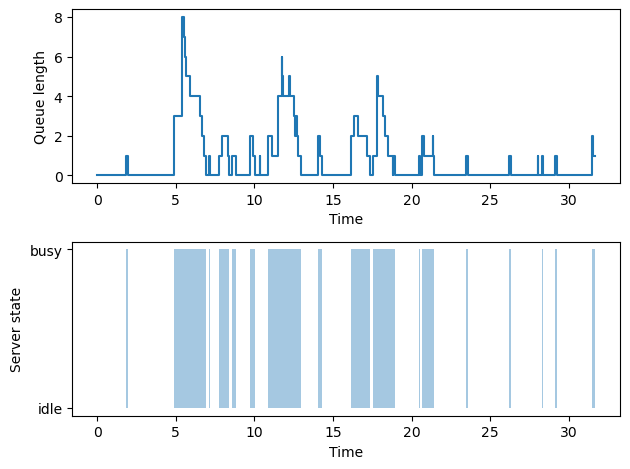

In [12]:
if LOGGED and PLOTTED:
    import matplotlib.pyplot as plt
    if RENEGED:
        log = np.loadtxt('mm1SD-l%d-m%d-w%d.csv' %(LAMBDA, MU, MAXWAITTIME), delimiter = '\t')
    else:
        log = np.loadtxt('mm1-l%d-m%d.csv' %(LAMBDA, MU), delimiter = '\t')
    plt.subplot(2, 1, 1)
    plt.xlabel('Time')
    plt.ylabel('Queue length')
    plt.step(log[:200,0], log[:200,2], where='post')
    plt.subplot(2, 1, 2)
    plt.xlabel('Time' )
    plt.ylabel('Server state' )
    plt.yticks([0, 1], ['idle', 'busy'])
    #plt.step( log[:200,0], log[:200,1], where='post' )
    plt.fill_between(log[:200,0], 0, log[:200,1], step="post", alpha=.4)
    plt.tight_layout()
    plt.show()